In [1]:
def line_plotly(df_, resample_,name_):
    import plotly.express as px
    
    df = df_.RAD.resample(resample_).mean()
    fig = px.line(df, x=df.index, y=df.values, labels=name_,title=name_)
    fig.show()

In [2]:
def test_stationarity(timeseries,window):
    from statsmodels.tsa.stattools import adfuller
    
    #DEterming rolling statistics:
    movingAverage = timeseries.rolling(window=window).mean()
    movingSTD = timeseries.rolling(window=window).std()
    
    #Plot rolling statistics:
    orig = plt.plot(timeseries, color='#99aacc', label = 'Original')
    mean = plt.plot(movingAverage, color='#9900aa', label='Rolling Mean')
    std = plt.plot(movingSTD, color = 'yellow', linewidth=2, label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation', fontsize=18)
    plt.show()
    
    #Perform Dickey-Fuller test:
    print('Results od Dickey0Fuller Test:')
    dftest = adfuller(timeseries,autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value(%s)'%key]=value
    print(dfoutput)
     # se a significância estiver abaixo de 0.05, significa que há pouca influência nos dados. 
    if dfoutput[1] <= 0.05:
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary")
    else:
        print("weak evidence against null hypothesis, indicating it is non-stationary ")

In [3]:
#Ho: Não é estacionário
#H1: É estacionário

def adfuller_test(Vendas):
    ### Utilização do modelo adfuller do Statsmodels
    from statsmodels.tsa.stattools import adfuller
    result=adfuller(Vendas)
    
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations Used']
    
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    dfoutput = pd.Series(result[0:4], index=labels)    
    for key, value in result[4].items():
        dfoutput['Critical Value (%s)'%key]= value
    print(dfoutput[4:])
    
    # se a significância estiver abaixo de 0.05, significa que há pouca influência nos dados. 
    if result[1] <= 0.05:
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary")
    else:
        print("weak evidence against null hypothesis, indicating it is non-stationary ")

In [4]:
import pandas as pd 
import numpy as np
import statsmodels.api as sm

from sklearn.model_selection import train_test_split
from sklearn.feature_selection import f_classif
from sklearn.preprocessing import MinMaxScaler, RobustScaler
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

from functions import p_null,is_constant,low_var,col_row_duplicated,hide_spines,plot2numeric

import seaborn as sns
import matplotlib.pyplot as plt
#from warnings import simplefilter
import os
#simplefilter("ignore")

# algumas bibliotecas para processamento de dados ordenados - time series:
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf

from statsmodels.tsa.arima_model import ARIMA
import statsmodels.api as sm

# algumas bibliotecas para avaliação dos nossos modelos:
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error

from scipy.stats.distributions import chi2

import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [5]:
max_n_columns = 30
max_n_rows = 14000

pd.set_option('display.max_rows', int(f'{max_n_rows}'))
pd.set_option('display.max_columns', int(f'{max_n_columns}'))

In [6]:
import requests
import json
# # Pegando os dados utilizando o API do inmet a partir do site acima

# #Para pegar dados das estações automáticas
# url=requests.get('https://apitempo.inmet.gov.br/estacoes/T')
# x=url.json()
# estacoes=pd.read_json(json.dumps(x))

# # Iremos escolher apenas algumas das estações.
# #Vide figura acima, Substituindo a de Registro pela de Itapeva, pois a de Registro havia muito dados faltosos

# LISTA_ESTACOES = ['JALES', 'SAO PAULO - MIRANTE', 'PRESIDENTE PRUDENTE', 'ITAPEVA', 'BAURU', 'ITUVERAVA','VALPARAISO']

# #Selecionando as Estações
# lista_estacoes = estacoes.query('DC_NOME == "JALES"|DC_NOME == "SAO PAULO - MIRANTE"|DC_NOME == "PRESIDENTE PRUDENTE"|DC_NOME =="ITAPEVA"|DC_NOME == "BAURU"|DC_NOME =="ITUVERAVA"|DC_NOME =="VALPARAISO"')                       
# lista_estacoes = lista_estacoes.reset_index()
## Selecionando apenas algumas colunas
#lista_estacoes = lista_estacoes[['DC_NOME','CD_ESTACAO','VL_LATITUDE','VL_LONGITUDE','VL_ALTITUDE','DT_INICIO_OPERACAO','CD_SITUACAO']]

lista_estacoes = pd.read_csv('lista_estacoes.csv',sep=';')
lista_estacoes

,DC_NOME,CD_ESTACAO,VL_LATITUDE,VL_LONGITUDE,VL_ALTITUDE,DT_INICIO_OPERACAO,CD_SITUACAO
0,BAURU,A705,-22.358052,-49.028877,636.17,2001-08-29T21:00:00.000-03:00,Operante
1,ITAPEVA,A714,-23.981944,-48.885833,743.33,2006-07-24T21:00:00.000-03:00,Operante
2,ITUVERAVA,A753,-20.359722,-47.775278,610.58,2008-07-16T21:00:00.000-03:00,Operante
3,JALES,A733,-20.165000,-50.595000,460.44,2007-08-21T21:00:00.000-03:00,Operante
4,PRESIDENTE PRUDENTE,A707,-22.119867,-51.408637,431.92,2003-02-03T22:00:00.000-02:00,Operante
5,SAO PAULO - MIRANTE,A701,-23.496294,-46.620088,785.64,2006-07-24T21:00:00.000-03:00,Operante
6,VALPARAISO,A734,-21.319167,-50.930278,381.90,2007-08-29T21:00:00.000-03:00,Operante


In [7]:
df_A705 = pd.read_csv('df_A705.csv',sep=';')
df_A714 = pd.read_csv('df_A714.csv',sep=';')
df_A753 = pd.read_csv('df_A753.csv',sep=';')
df_A733 = pd.read_csv('df_A733.csv',sep=';')
df_A707 = pd.read_csv('df_A707.csv',sep=';')
df_A701 = pd.read_csv('df_A701.csv',sep=';')
df_A734 = pd.read_csv('df_A734.csv',sep=';')

df_A705['cidade']='Bauru'
df_A714['cidade']='Itapeva'
df_A753['cidade']='Ituverava'
df_A733['cidade']='Jales'
df_A707['cidade']= 'Presidente Prudente'
df_A701['cidade']= 'São Paulo'
df_A734['cidade']='Valparaíso'

#trasformando a data em datetime
df_A705.loc[:,'DT_MEDICAO'] =  pd.to_datetime(df_A705.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
df_A714.loc[:,'DT_MEDICAO'] =  pd.to_datetime(df_A714.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
df_A753.loc[:,'DT_MEDICAO'] =  pd.to_datetime(df_A753.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
df_A733.loc[:,'DT_MEDICAO'] =  pd.to_datetime(df_A733.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
df_A707.loc[:,'DT_MEDICAO'] =  pd.to_datetime(df_A707.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
df_A701.loc[:,'DT_MEDICAO'] =  pd.to_datetime(df_A701.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')
df_A734.loc[:,'DT_MEDICAO'] =  pd.to_datetime(df_A734.loc[:,'DT_MEDICAO'], format='%Y-%m-%d')

#criando a coluna mês
df_A705.loc[:,'MES'] = df_A705.loc[:,'DT_MEDICAO'].dt.month
df_A714.loc[:,'MES'] = df_A714.loc[:,'DT_MEDICAO'].dt.month
df_A753.loc[:,'MES'] = df_A753.loc[:,'DT_MEDICAO'].dt.month
df_A733.loc[:,'MES'] = df_A733.loc[:,'DT_MEDICAO'].dt.month
df_A707.loc[:,'MES'] = df_A707.loc[:,'DT_MEDICAO'].dt.month
df_A701.loc[:,'MES'] = df_A701.loc[:,'DT_MEDICAO'].dt.month
df_A734.loc[:,'MES'] = df_A734.loc[:,'DT_MEDICAO'].dt.month

#criando a coluna ano
df_A705.loc[:,'ANO'] = df_A705.loc[:,'DT_MEDICAO'].dt.year
df_A714.loc[:,'ANO'] = df_A714.loc[:,'DT_MEDICAO'].dt.year
df_A753.loc[:,'ANO'] = df_A753.loc[:,'DT_MEDICAO'].dt.year
df_A733.loc[:,'ANO'] = df_A733.loc[:,'DT_MEDICAO'].dt.year
df_A707.loc[:,'ANO'] = df_A707.loc[:,'DT_MEDICAO'].dt.year
df_A701.loc[:,'ANO'] = df_A701.loc[:,'DT_MEDICAO'].dt.year
df_A734.loc[:,'ANO'] = df_A734.loc[:,'DT_MEDICAO'].dt.year

In [8]:
# Transformando o DF_A714_ANUAL['HR_MEDICAO'] que está em UTC para o correspondente para o BRASIL.
# Sendo a hora 0 = 21h.
# Criando uma coluna ['HR'] para esses valores

def hora_UTC(df):
    hora_br = 0
    HORA=[]

    for hora in df['HR_MEDICAO']:
        if hora/100+21 >= 25:
            hora_br = (hora/100+21)-24
        else:
            hora_br = hora/100+21
        HORA.append(hora_br)
    df.loc[:,'HR'] = HORA    

# Usando a função para toddas as estações
hora_UTC(df_A705)
hora_UTC(df_A714)
hora_UTC(df_A753)
hora_UTC(df_A733)
hora_UTC(df_A707)
hora_UTC(df_A701)
hora_UTC(df_A734)

In [9]:
def treat_null_RAD(df):
    # Fazendo o tratamento do restante dos nulls com o method=ffill
    df.fillna(method='ffill',axis=0,inplace=True)
    
    condiction = df.loc[:,'HR']>=21                  # condição se o horário é mais que 21h
    df.loc[:,'RAD']  = np.where(condiction, 0 ,df.loc[:,'RAD_GLO'])
    condiction2 = df.loc[:,'HR'] <= 5                 # condição se o horário é menos que 5h
    df['RAD']  = np.where(condiction2, 0 ,df['RAD'])
    df['RAD']  = df['RAD'].apply(lambda x: 0 if x<0 else x) # ou se negativo é igual a zero  
    

#DF_A714_ANUAL.loc[DF_A714_ANUAL['CHUVA'].isnull(),'CHUVA']=0  #ou
df_A705.loc[:,'CHUVA'].fillna(0.0, inplace=True)
df_A714.loc[:,'CHUVA'].fillna(0.0, inplace=True)
df_A753.loc[df_A753['CHUVA'].isnull(),'CHUVA']=0.0
df_A733.loc[df_A733['CHUVA'].isnull(),'CHUVA']=0.0
df_A707.loc[df_A707['CHUVA'].isnull(),'CHUVA']=0.0
df_A701.loc[df_A701['CHUVA'].isnull(),'CHUVA']=0.0
df_A734.loc[df_A734['CHUVA'].isnull(),'CHUVA']=0.0

# Fazendo a função acima para todas as estações:
treat_null_RAD(df_A705)
treat_null_RAD(df_A714)
treat_null_RAD(df_A753)
treat_null_RAD(df_A733)
treat_null_RAD(df_A707)
treat_null_RAD(df_A701)
treat_null_RAD(df_A734)

In [10]:
def tirando_horas_sem_radiacao(df):
    condicao_irradiacao = (df.HR<19)& (df.HR>5)
    df = df[condicao_irradiacao]
    return df

In [11]:
df_A705 = tirando_horas_sem_radiacao(df_A705)
df_A714 = tirando_horas_sem_radiacao(df_A714)
df_A753 = tirando_horas_sem_radiacao(df_A753)
df_A733 = tirando_horas_sem_radiacao(df_A733)
df_A707 = tirando_horas_sem_radiacao(df_A707)
df_A701 = tirando_horas_sem_radiacao(df_A701)
df_A734 = tirando_horas_sem_radiacao(df_A734)

In [12]:
dados_treated = pd.concat([df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734])
#DADOS.to_csv('DADOS.csv',sep=';',index=('DT_MEDICAO'))

In [13]:
dados_treated_copy = dados_treated.copy()

In [14]:
dados_treated = dados_treated

dados_treated.set_index('DT_MEDICAO',inplace=True)

dados_treated.index = pd.DatetimeIndex(dados_treated.index)

In [15]:
# Colocando index como Datetime
df_A705.set_index('DT_MEDICAO',inplace=True)
df_A714.set_index('DT_MEDICAO',inplace=True)
df_A753.set_index('DT_MEDICAO',inplace=True)
df_A733.set_index('DT_MEDICAO',inplace=True)
df_A707.set_index('DT_MEDICAO',inplace=True)
df_A701.set_index('DT_MEDICAO',inplace=True)
df_A734.set_index('DT_MEDICAO',inplace=True)

df_A705.index = pd.DatetimeIndex(df_A705.index)
df_A714.index = pd.DatetimeIndex(df_A714.index)
df_A753.index = pd.DatetimeIndex(df_A753.index)
df_A733.index = pd.DatetimeIndex(df_A733.index)
df_A707.index = pd.DatetimeIndex(df_A707.index)
df_A701.index = pd.DatetimeIndex(df_A701.index)
df_A734.index = pd.DatetimeIndex(df_A734.index)

In [16]:
df_dia_A705 = df_A705.groupby(['DT_MEDICAO']).mean()
df_dia_A714 = df_A714.groupby(['DT_MEDICAO']).mean()
df_dia_A753 = df_A753.groupby(['DT_MEDICAO']).mean()
df_dia_A733 = df_A733.groupby(['DT_MEDICAO']).mean()
df_dia_A707 = df_A707.groupby(['DT_MEDICAO']).mean()
df_dia_A701 = df_A701.groupby(['DT_MEDICAO']).mean()
df_dia_A734 = df_A734.groupby(['DT_MEDICAO']).mean()

#acréscimo de colunas para gráficos

df_dia_A705['cidade']='Bauru'
df_dia_A705['estacao']='A705'

df_dia_A714['cidade']='Itapeva'
df_dia_A714['estacao']='A714'

df_dia_A753['cidade']='Ituverava'
df_dia_A753['estacao']='A753'

df_dia_A733['cidade']='Jales'
df_dia_A733['estacao']='A733'

df_dia_A707['cidade']= 'Presidente Prudente'
df_dia_A707['estacao']='A707'

df_dia_A701['cidade']= 'São Paulo'
df_dia_A701['estacao']='A701'

df_dia_A734['cidade']='Valparaíso'
df_dia_A734['estacao']='A734'

In [17]:
df_dia_estacoes = pd.concat([df_dia_A705,df_dia_A714,df_dia_A753,df_dia_A733,df_dia_A707,df_dia_A701,df_dia_A734])


In [18]:
# Média Anual - médias do ano do periodo de 2011 a 2021
df_m_A705 = df_dia_A705.resample('M').mean()
df_m_A714 = df_dia_A714.resample('M').mean()
df_m_A753 = df_dia_A753.resample('M').mean()
df_m_A733 = df_dia_A733.resample('M').mean()
df_m_A707 = df_dia_A707.resample('M').mean()
df_m_A701 = df_dia_A701.resample('M').mean()
df_m_A734 = df_dia_A734.resample('M').mean()

df_m_A705['cidade']='Bauru'
df_m_A705['estacao']='A705'

df_m_A714['cidade']='Itapeva'
df_m_A714['estacao']='A714'

df_m_A753['cidade']='Ituverava'
df_m_A753['estacao']='A753'

df_m_A733['cidade']='Jales'
df_m_A733['estacao']='A733'

df_m_A707['cidade']= 'Presidente Prudente'
df_m_A707['estacao']='A707'

df_m_A701['cidade']= 'São Paulo'
df_m_A701['estacao']='A701'

df_m_A734['cidade']='Valparaíso'
df_m_A734['estacao']='A734'

df_m_estacoes = pd.concat([df_m_A705,df_m_A714,df_m_A753,df_m_A733,df_m_A707,df_m_A701,df_m_A734])

In [19]:
print(f'min: {dados_treated.index.min()}  max: {dados_treated.index.max()}')

min: 2011-01-01 00:00:00  max: 2022-03-08 00:00:00


In [176]:
def graficos_subplot(df_dia ,ano_incial=2011,ano_final=2021):
    '''
    df_dia_(Estação);
    ano_incial = 2011
    ano_incial = 2021
    '''
    ## Para formatação das Legendas 
    name_city = df_dia['cidade'][0]
    name_estation = df_dia['estacao'][0]
    
    # Seleciona dias
    ano_incial = ano_incial
    ano_final = ano_final

    anos = range(ano_incial,ano_final,1)
    for ano in anos:
        df = df_dia.query(f'ANO == {ano}')

        fig, ax = plt.subplots(1, 2, figsize=(20, 6))

        ##  ------ RADIAÇÃO GLOBAL W/m²  ------------
        fig.suptitle(f'Gráficos da estação {name_estation} em {name_city} no ano {ano}')
        ax[0].plot(df.index , df['RAD'],'o-')
        ax[0].set_xlabel('Data da medição[dia]',fontsize= 15)
        ax[0].set_ylabel('Radiação[W/m²]',fontsize=16)
        ax[0].axhline(df['RAD'].mean(),c = 'red',label='Radiação_média')
        ax[0].grid(True, 'both','both')
        ax[0].set_title(f'Radiação global diária média[W/m²] durante o ano {ano}')
        #ax[0].set_xticks(df.index.iloc[range(0,df.shape[0],10),0])
        ax[0].tick_params(axis='x', rotation=90)
        ax[0].legend(fontsize=15);

        ##  ------ 'TEM_MAX': TEMPERATURA MÁXIMA NA HORA ANT. °C,  ------------
        ax[1].plot(df.index , df['TEM_MAX'],'o-',color = 'black')
        ax[1].set_title(f'Temperatura[°C] média diária durante o ano {ano}')
        ax[1].set_xlabel('Data da medição[dia]',fontsize= 15)
        ax[1].set_ylabel('Temperatura[°C]',fontsize=16)
        ax[1].axhline(df['TEM_MAX'].mean(),c = 'red',label='TMax_média')
        ax[1].grid(True, 'both','both')
        #ax[1].set_xticks(df.iloc[range(0,df.shape[0],10),0])
        ax[1].tick_params(axis='x', rotation=90)        
        ax[1].legend(fontsize=15);

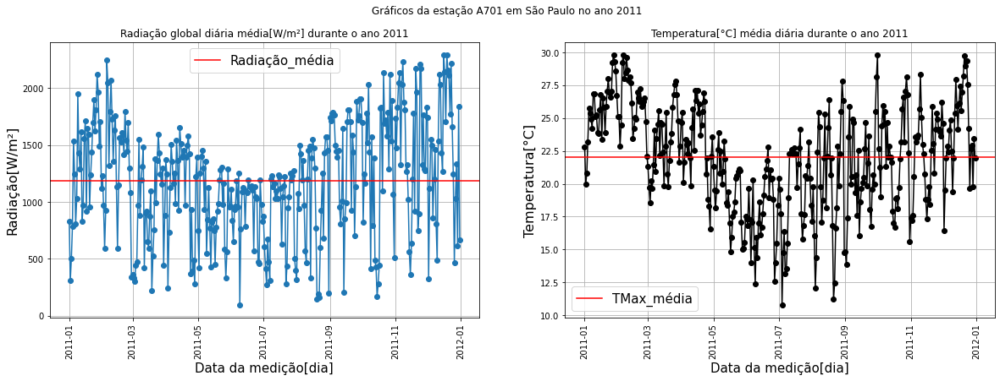

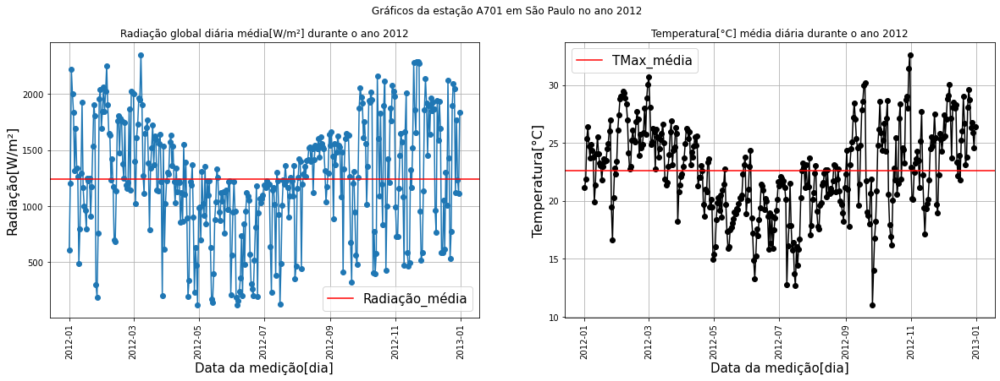

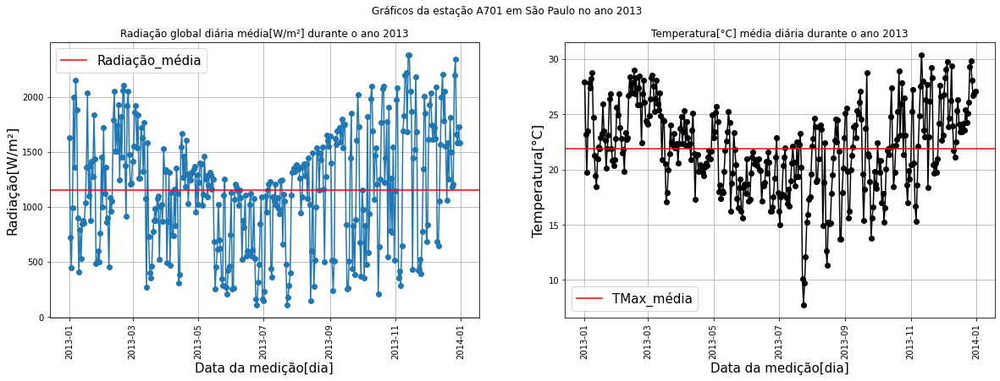

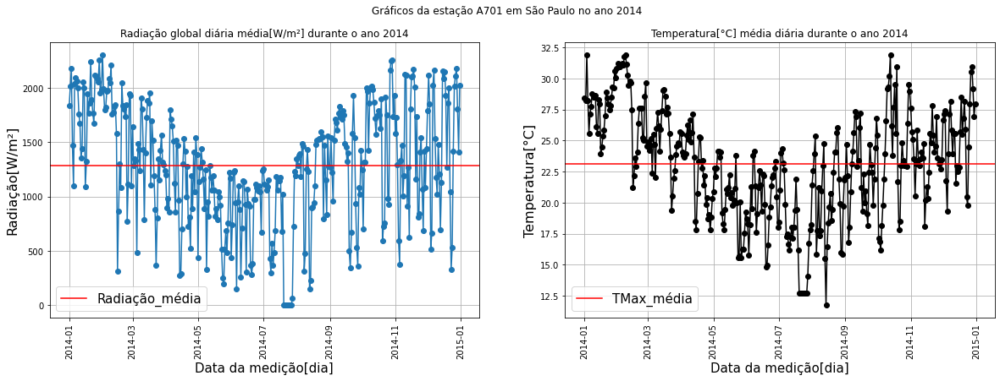

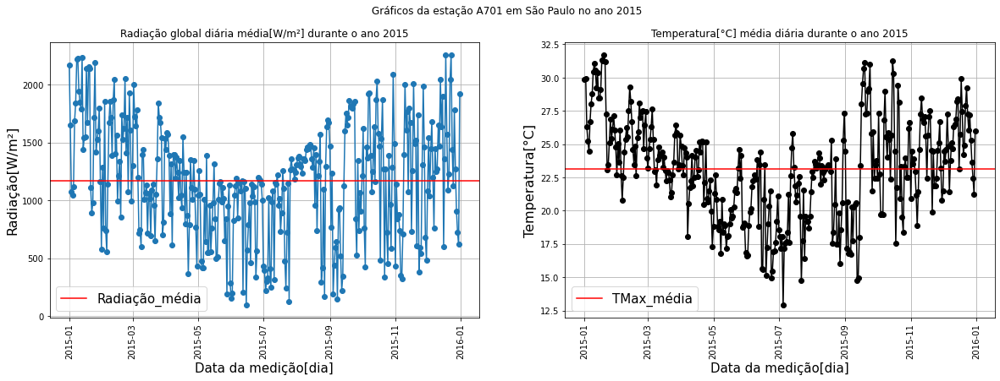

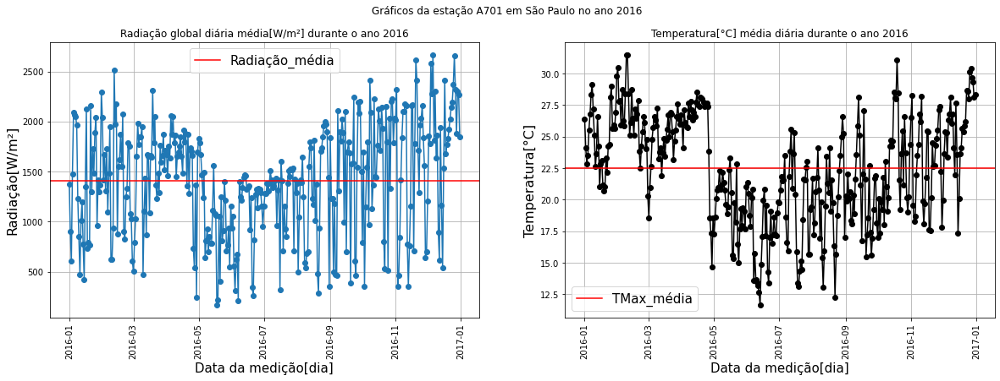

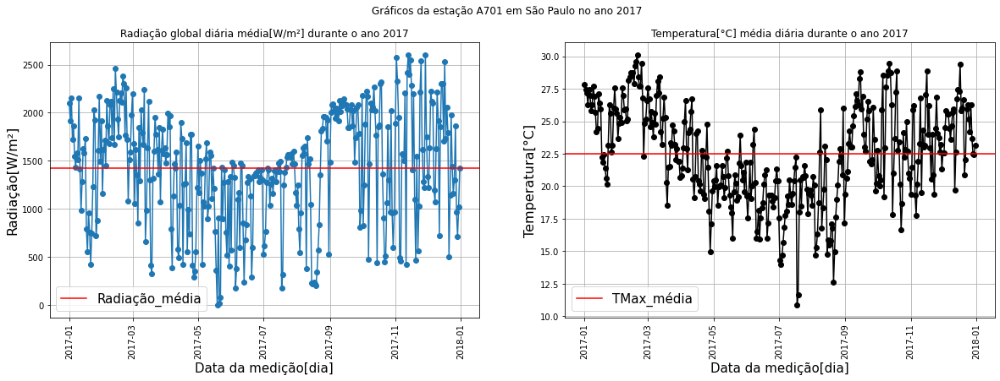

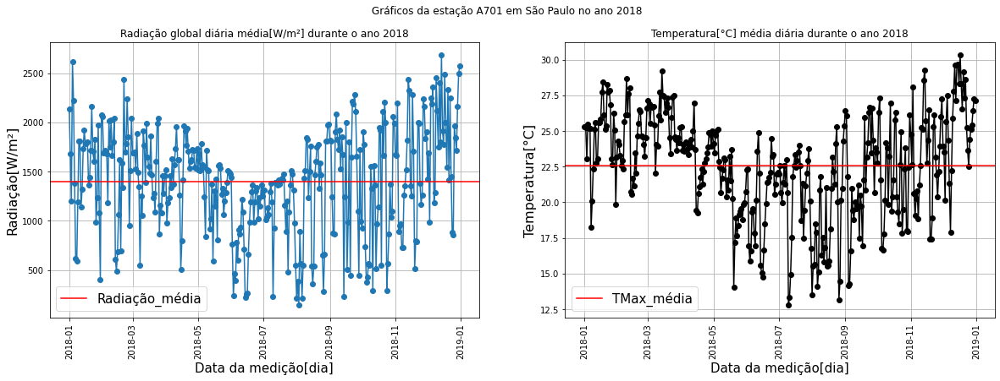

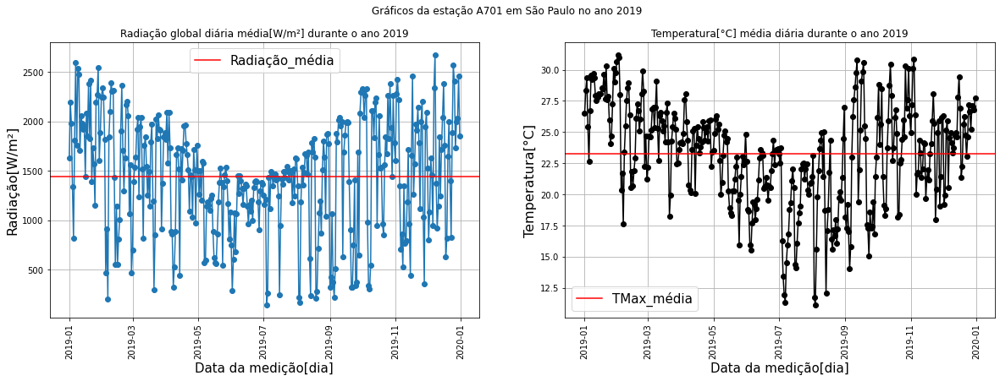

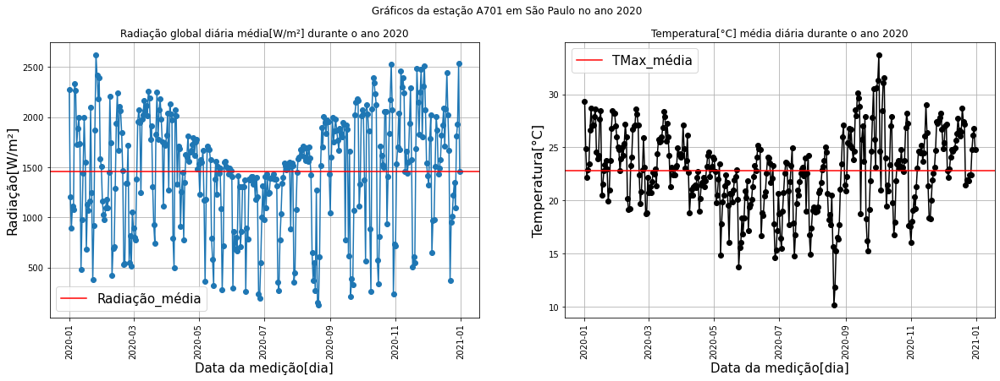

In [177]:
graficos_subplot(df_dia_A701)

In [20]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]

for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    line_plotly(df,'D',nome)

In [36]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]

for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    line_plotly(df,'M',nome)

In [37]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]

for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    line_plotly(df,'3M',nome)

In [38]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]

for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    line_plotly(df,'Y',nome)

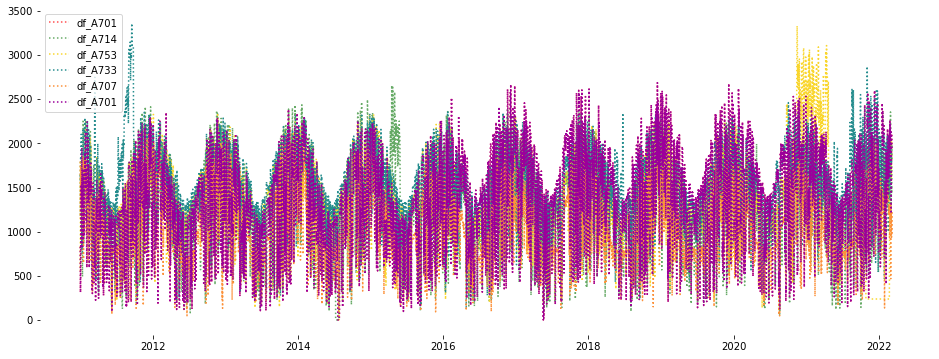

In [18]:
fig, ax = plt.subplots(figsize=(16,6))
ax.plot(df_A701.RAD.resample('D').mean(),color='#ff4e50',linestyle=":",label='df_A701')
ax.plot(df_A714.RAD.resample('D').mean(),color='#66aa66',linestyle=":",label='df_A714')
ax.plot(df_A753.RAD.resample('D').mean(),color='#f9d62e',linestyle=":",label='df_A753')
ax.plot(df_A733.RAD.resample('D').mean(),color='#268d8e',linestyle=":",label='df_A733')
ax.plot(df_A707.RAD.resample('D').mean(),color='#fc913a',linestyle=":",label='df_A707')
ax.plot(df_A701.RAD.resample('D').mean(),color='#9b009b',linestyle=":",label='df_A701')
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["bottom"].set_visible(False)
ax.legend();

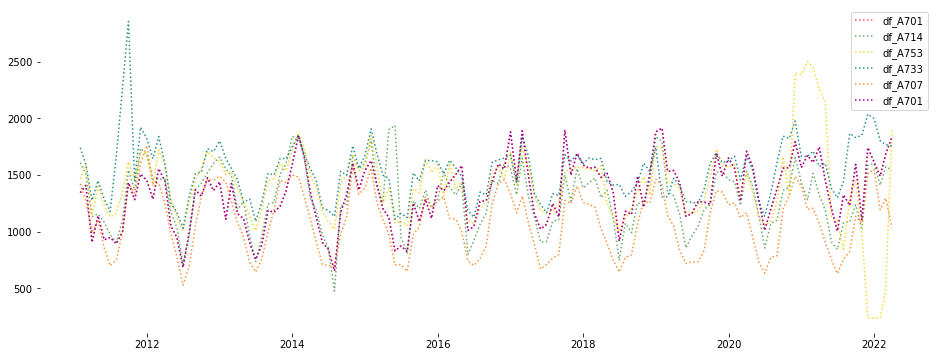

In [21]:
fig, ax = plt.subplots(figsize=(16,6))
ax.plot(df_A705.RAD.resample('M').mean(),color='#ff4e50',linestyle=":",label='df_A701')
ax.plot(df_A714.RAD.resample('M').mean(),color='#66aa66',linestyle=":",label='df_A714')
ax.plot(df_A753.RAD.resample('M').mean(),color='#f9d62e',linestyle=":",label='df_A753')
ax.plot(df_A733.RAD.resample('M').mean(),color='#268d8e',linestyle=":",label='df_A733')
ax.plot(df_A707.RAD.resample('M').mean(),color='#fc913a',linestyle=":",label='df_A707')
ax.plot(df_A701.RAD.resample('M').mean(),color='#9b009b',linestyle=":",label='df_A701')
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["bottom"].set_visible(False)
ax.legend();

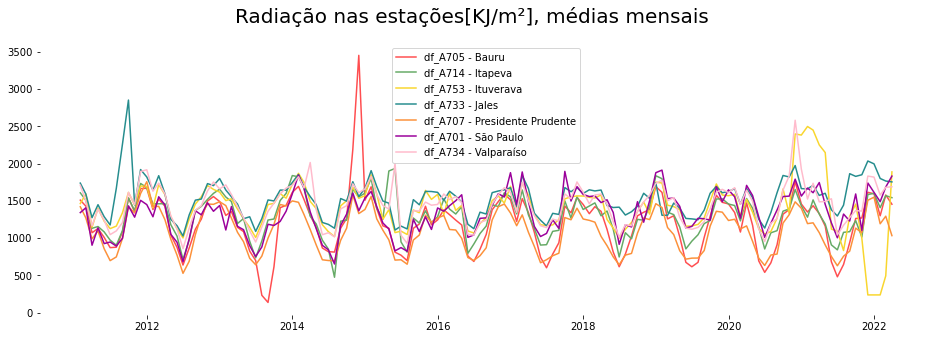

In [46]:
fig, ax = plt.subplots(figsize=(16,5))

ax.plot(df_A705.RAD.resample('M').mean(),color='#ff4e50',label='df_A705 - Bauru')
ax.plot(df_A714.RAD.resample('M').mean(),color='#66aa66',label='df_A714 - Itapeva')
ax.plot(df_A753.RAD.resample('M').mean(),color='#f9d62e',label='df_A753 - Ituverava')
ax.plot(df_A733.RAD.resample('M').mean(),color='#268d8e',label='df_A733 - Jales')
ax.plot(df_A707.RAD.resample('M').mean(),color='#fc913a',label='df_A707 - Presidente Prudente')
ax.plot(df_A701.RAD.resample('M').mean(),color='#9b009b',label='df_A701 - São Paulo')
ax.plot(df_A734.RAD.resample('M').mean(),color='#ffbbcc',label='df_A734 - Valparaíso')

fig.suptitle('Radiação nas estações[KJ/m²], médias mensais',fontsize=20)

ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["bottom"].set_visible(False)

ax.legend();


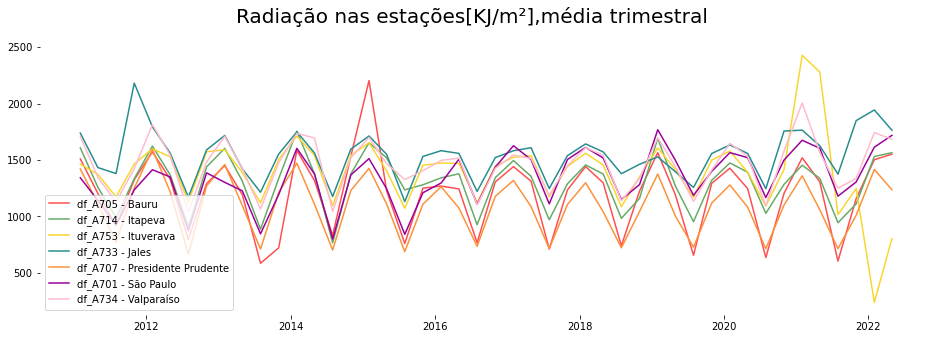

In [52]:
fig, ax = plt.subplots(figsize=(16,5))

ax.plot(df_A705.RAD.resample('3M').mean(),color='#ff4e50',label='df_A705 - Bauru')
ax.plot(df_A714.RAD.resample('3M').mean(),color='#66aa66',label='df_A714 - Itapeva')
ax.plot(df_A753.RAD.resample('3M').mean(),color='#f9d62e',label='df_A753 - Ituverava')
ax.plot(df_A733.RAD.resample('3M').mean(),color='#268d8e',label='df_A733 - Jales')
ax.plot(df_A707.RAD.resample('3M').mean(),color='#fc913a',label='df_A707 - Presidente Prudente')
ax.plot(df_A701.RAD.resample('3M').mean(),color='#9b009b',label='df_A701 - São Paulo')
ax.plot(df_A734.RAD.resample('3M').mean(),color='#ffbbcc',label='df_A734 - Valparaíso')

fig.suptitle('Radiação nas estações[KJ/m²],média trimestral',fontsize=20)

ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["bottom"].set_visible(False)

ax.legend();

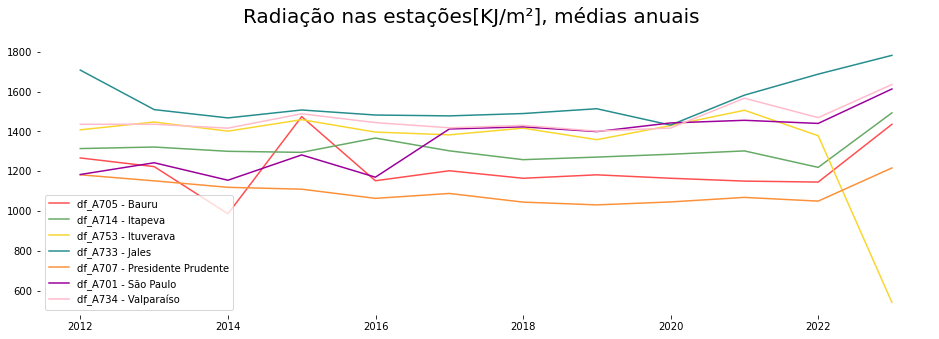

In [53]:
fig, ax = plt.subplots(figsize=(16,5))

ax.plot(df_A705.RAD.resample('Y').mean(),color='#ff4e50',label='df_A705 - Bauru')
ax.plot(df_A714.RAD.resample('Y').mean(),color='#66aa66',label='df_A714 - Itapeva')
ax.plot(df_A753.RAD.resample('Y').mean(),color='#f9d62e',label='df_A753 - Ituverava')
ax.plot(df_A733.RAD.resample('Y').mean(),color='#268d8e',label='df_A733 - Jales')
ax.plot(df_A707.RAD.resample('Y').mean(),color='#fc913a',label='df_A707 - Presidente Prudente')
ax.plot(df_A701.RAD.resample('Y').mean(),color='#9b009b',label='df_A701 - São Paulo')
ax.plot(df_A734.RAD.resample('Y').mean(),color='#ffbbcc',label='df_A734 - Valparaíso')

fig.suptitle('Radiação nas estações[KJ/m²], médias anuais',fontsize=20 )

ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["bottom"].set_visible(False)

ax.legend();

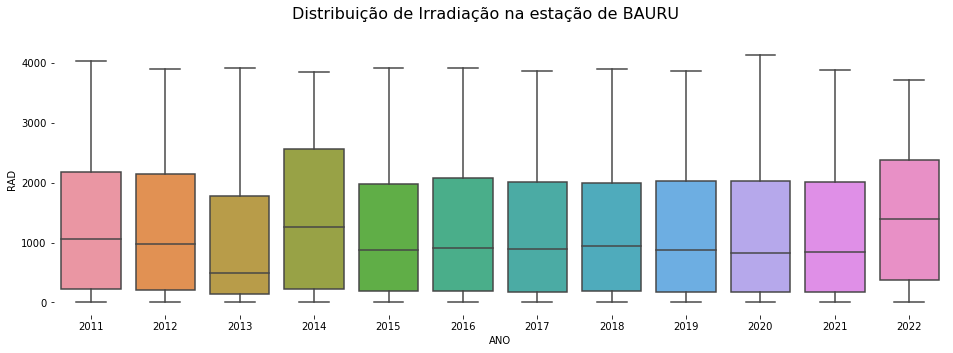

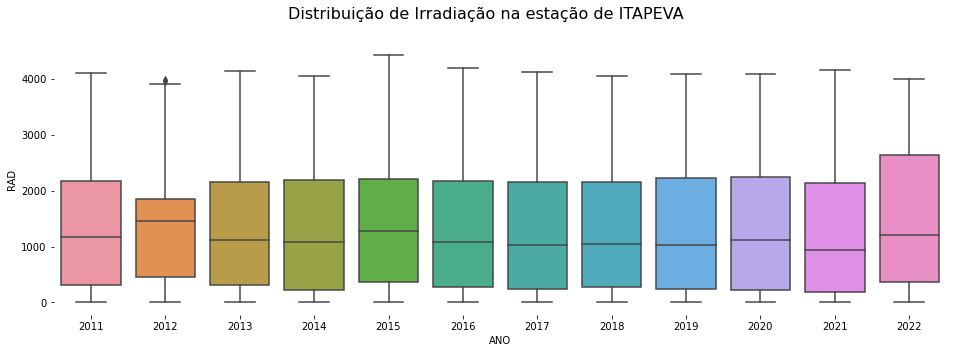

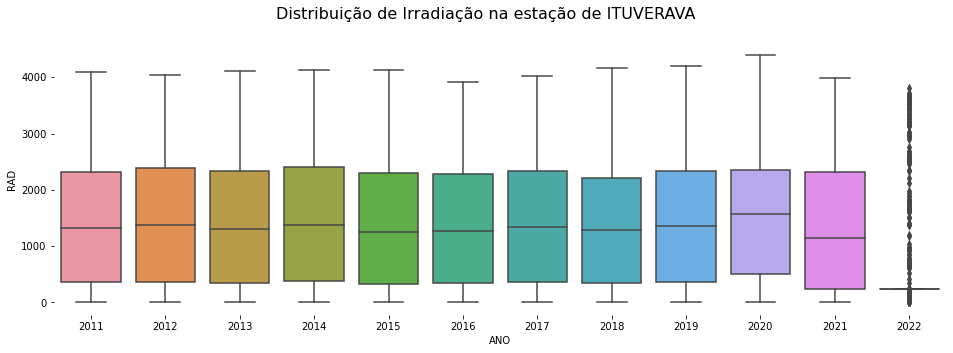

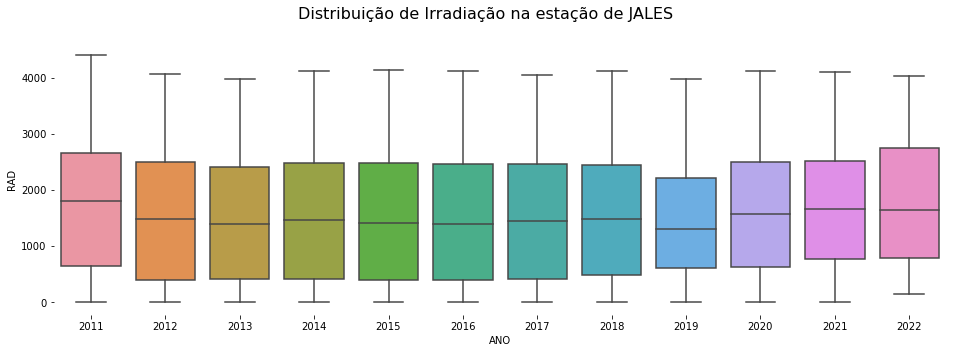

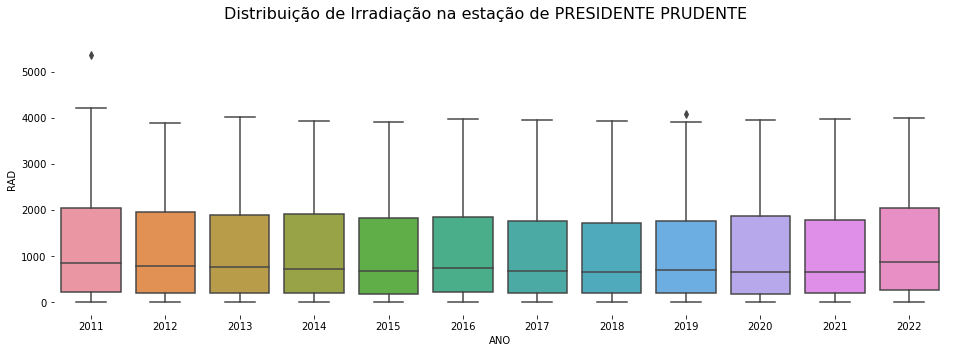

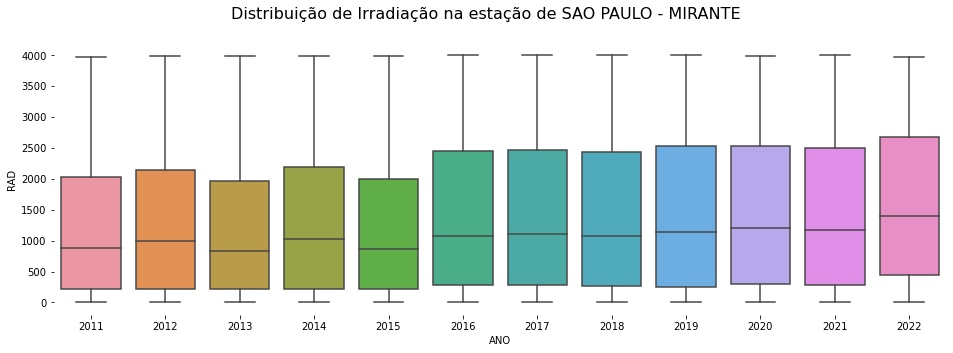

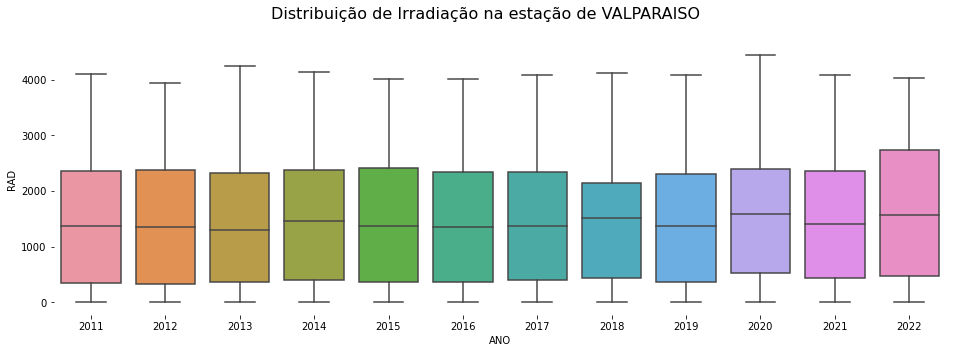

In [58]:
dados_treated['month_name'] = dados_treated.index.month_name()
dados_treated['day_name']=dados_treated.index.day_name()

for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    fig, ax = plt.subplots(figsize = (16, 5))
    sns.boxplot(y = df['RAD'], x = df['ANO'], ax = ax)
    fig.suptitle(f'Distribuição de Irradiação na estação de {nome} ao longo do ano com medições horárias', fontsize=16)
    
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["left"].set_visible(False)
    ax.spines["bottom"].set_visible(False);

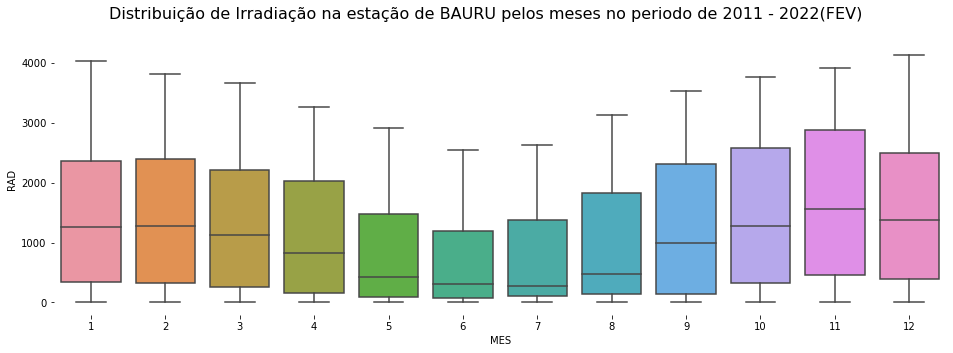

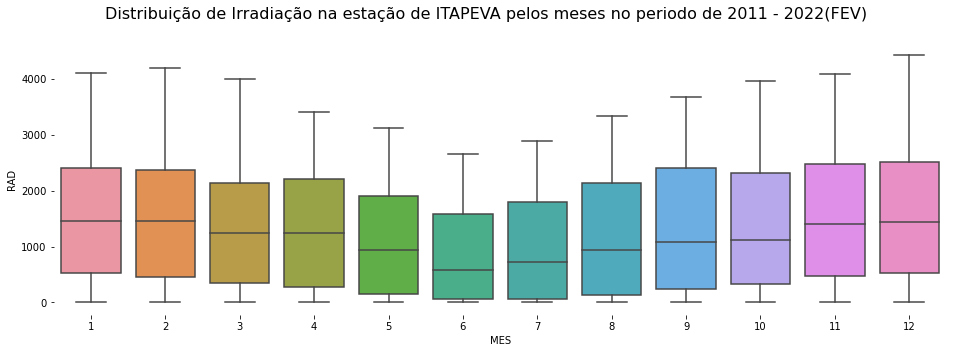

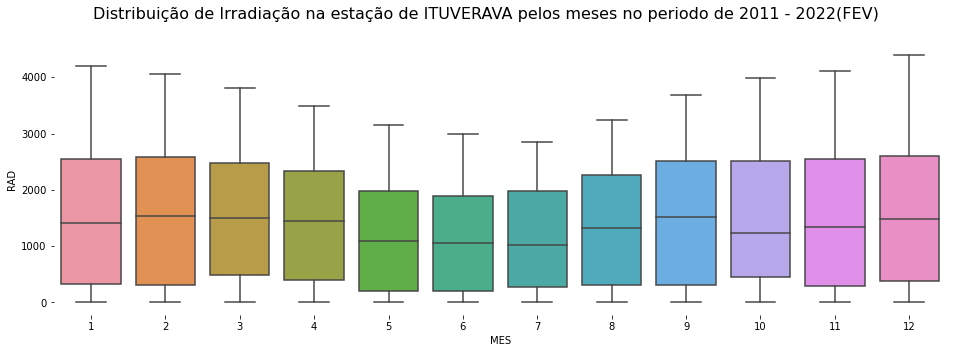

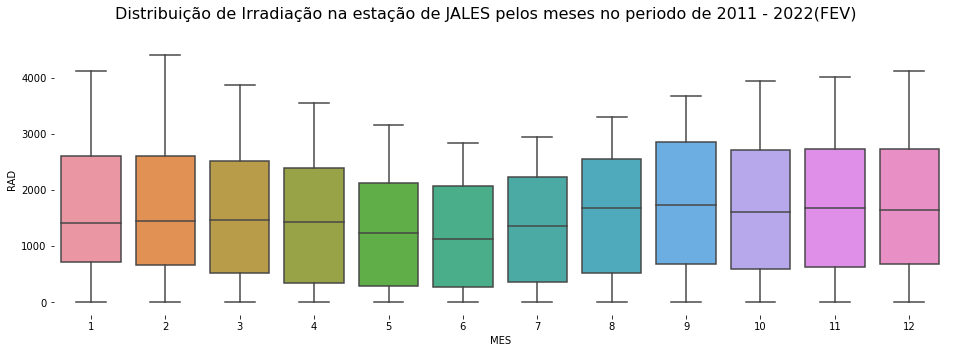

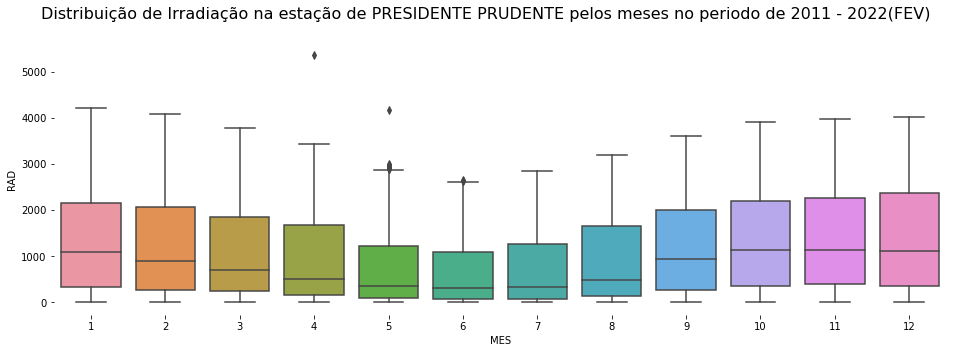

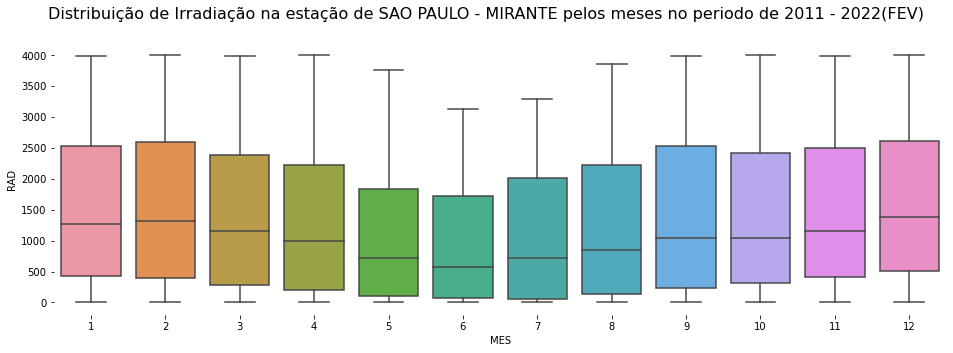

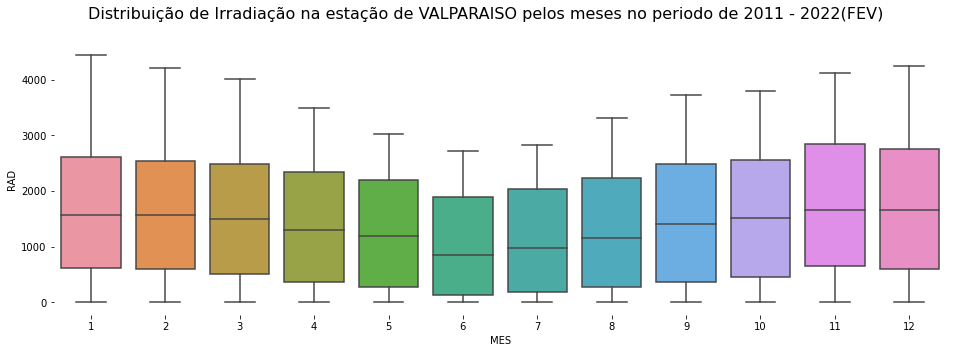

In [59]:
for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    fig, ax = plt.subplots(figsize = (16, 5))
    sns.boxplot(y = df['RAD'], x = df['MES'], ax = ax)
    fig.suptitle(f'Distribuição de Irradiação na estação de {nome} pelos meses no periodo de 2011 - 2022(FEV),medições horárias', fontsize=16)
    
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["left"].set_visible(False)
    ax.spines["bottom"].set_visible(False);


|CODIGO  | ATRIBUTO	DESCRIÇÃO	                 |UNIDADE|
|--------|---------------------------------------|-------|
|VEN_DIR |VENTO, DIREÇÃO HORARIA 	             |° (gr) |
|CHUVA   |PRECIPITAÇÃO TOTAL, HORÁRIO	         |mm     |
|PRE_INS |PRESSÃO ATMOSFÉRICA AO NÍVEL DA ESTACÃO|mB     |
|PRE_MIN |PRESSÃO ATMOSFÉRICA MIN. NA HORA ANT.  |mB     |
|UMD_MAX |UMIDADE REL. MAX. NA HORA ANT.         |%      |
|PRE_MAX |PRESSÃO ATMOSFÉRICA MAX.NA HORA ANT.   |mB     |
|VEN_VEL |VENTO, VELOCIDADE HORARIA	             |m/s    |
|PTO_MIN |TEMPERATURA ORVALHO MIN. NA HORA ANT.  |°C     |
|TEM_MAX |TEMPERATURA MÁXIMA NA HORA ANT.        |°C     |
|RAD_GLO |RADIAÇÃO GLOBAL	                     |KJ/m²  |
|PTO_INS |TEMPERATURA DO PONTO DE ORVALHO	     |°C     |
|VEN_RAJ |VENTO, RAJADA MÁXIMA	                 |m/s    |
|TEM_INS |TEMPERATURA DO AR - BULBO SECO, HORARIA|°C     |
|UMD_INS |UMIDADE RELATIVA DO AR, HORARIA	     |%      |
|TEM_MIN |TEMPERATURA MÍNIMA NA HORA ANT. (AUT)	 |°C     |
|UMD_MIN |UMIDADE REL. MIN. NA HORA ANT. (AUT)	 |%      |
|PTO_MAX |TEMPERATURA ORVALHO MAX. NA HORA ANT.  |°C     |

# Funções pra o ARRIMA

# Dados Horários

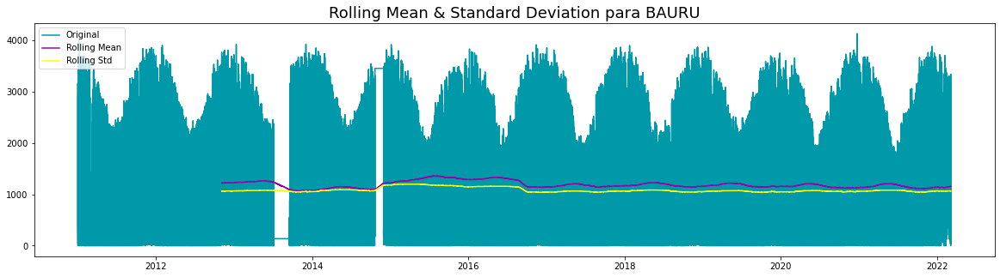

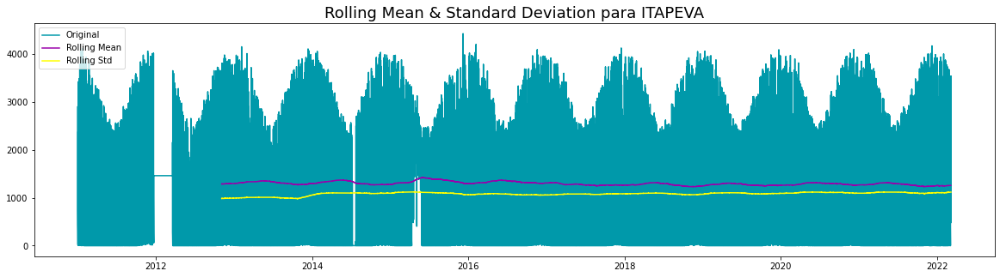

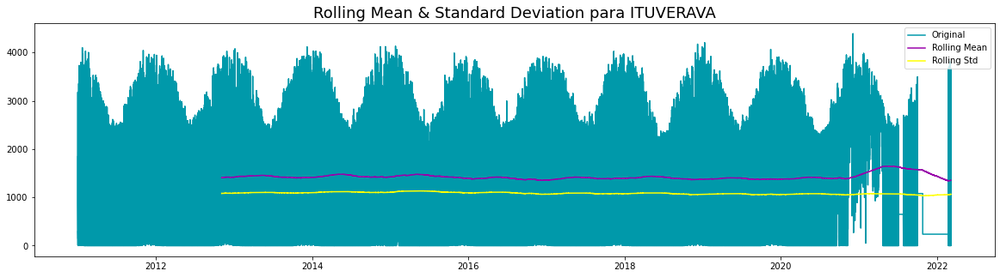

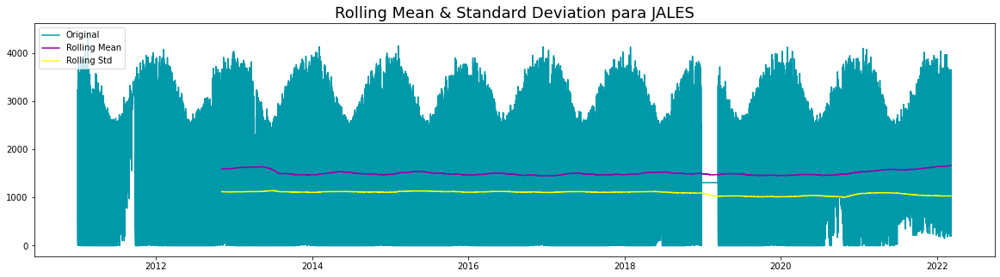

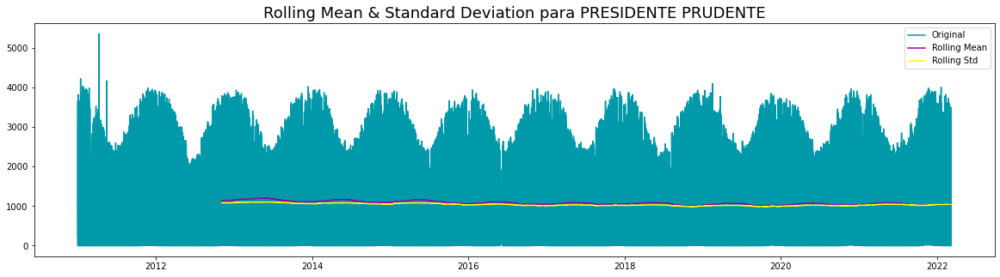

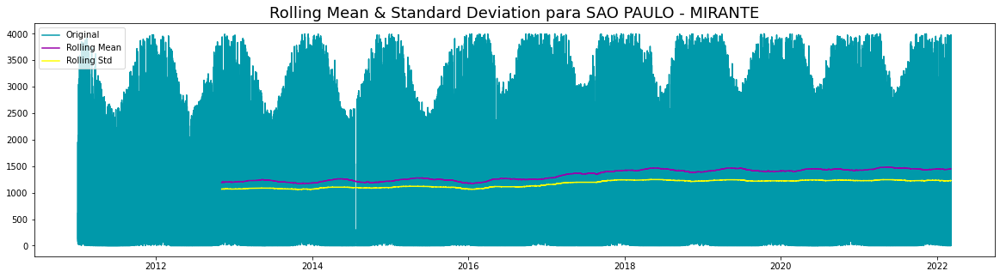

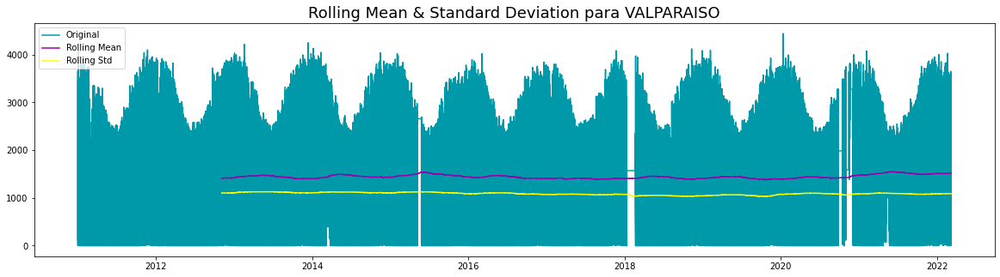

In [63]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]

for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.RAD  #.resample('M').mean()
    
    #Determing rolling statistics
    rolmean = ts.rolling(8760).mean() #365*24h
    rolstd = ts.rolling(8760).std()

    #Plot rolling statistics:
    plt.figure(figsize = (20, 5))
    orig = plt.plot(ts, color='#0099aa',label='Original')
    mean = plt.plot(rolmean, color='#9900aa', label='Rolling Mean')
    std = plt.plot(rolstd, color='yellow', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title(f'Rolling Mean & Standard Deviation para {nome}',fontsize=18)
    plt.show()

'BAURU'

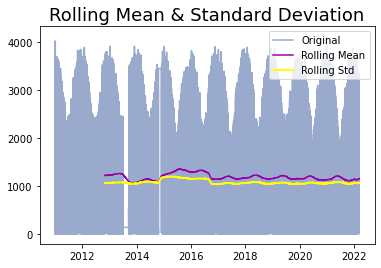

Results od Dickey0Fuller Test:
Test Statistic                -1.369464e+01
p-value                        1.324015e-25
#Lags Used                     5.300000e+01
Number of Observations Used    5.305100e+04
Critical Value(1%)            -3.430473e+00
Critical Value(5%)            -2.861594e+00
Critical Value(10%)           -2.566799e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
--*----*----*----*----*----*----*----*----*----*----*----*----*----*----*--


'ITAPEVA'

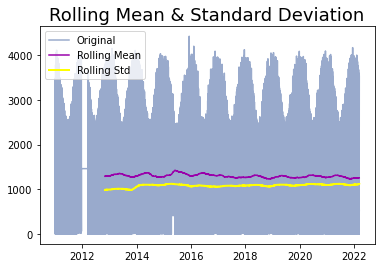

Results od Dickey0Fuller Test:
Test Statistic                   -18.831867
p-value                            0.000000
#Lags Used                        58.000000
Number of Observations Used    53046.000000
Critical Value(1%)                -3.430473
Critical Value(5%)                -2.861594
Critical Value(10%)               -2.566799
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
--*----*----*----*----*----*----*----*----*----*----*----*----*----*----*--


'ITUVERAVA'

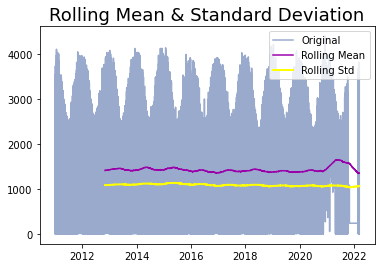

Results od Dickey0Fuller Test:
Test Statistic                -1.431168e+01
p-value                        1.181400e-26
#Lags Used                     5.500000e+01
Number of Observations Used    5.304900e+04
Critical Value(1%)            -3.430473e+00
Critical Value(5%)            -2.861594e+00
Critical Value(10%)           -2.566799e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
--*----*----*----*----*----*----*----*----*----*----*----*----*----*----*--


'JALES'

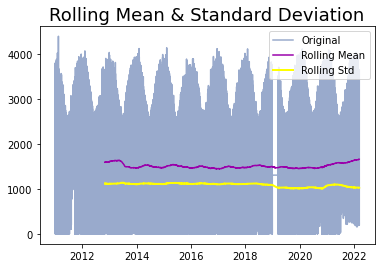

Results od Dickey0Fuller Test:
Test Statistic                -1.816719e+01
p-value                        2.452453e-30
#Lags Used                     5.500000e+01
Number of Observations Used    5.304900e+04
Critical Value(1%)            -3.430473e+00
Critical Value(5%)            -2.861594e+00
Critical Value(10%)           -2.566799e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
--*----*----*----*----*----*----*----*----*----*----*----*----*----*----*--


'PRESIDENTE PRUDENTE'

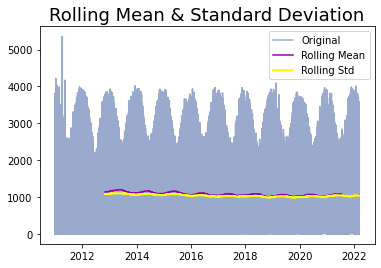

Results od Dickey0Fuller Test:
Test Statistic                -1.488105e+01
p-value                        1.609218e-27
#Lags Used                     5.200000e+01
Number of Observations Used    5.305200e+04
Critical Value(1%)            -3.430473e+00
Critical Value(5%)            -2.861594e+00
Critical Value(10%)           -2.566799e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
--*----*----*----*----*----*----*----*----*----*----*----*----*----*----*--


'SAO PAULO - MIRANTE'

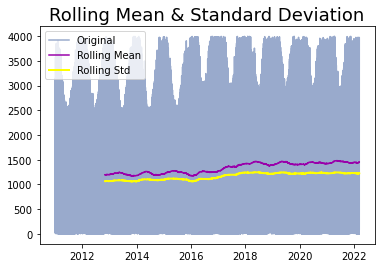

Results od Dickey0Fuller Test:
Test Statistic                   -21.349277
p-value                            0.000000
#Lags Used                        58.000000
Number of Observations Used    53046.000000
Critical Value(1%)                -3.430473
Critical Value(5%)                -2.861594
Critical Value(10%)               -2.566799
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
--*----*----*----*----*----*----*----*----*----*----*----*----*----*----*--


'VALPARAISO'

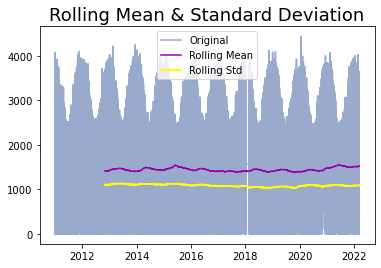

Results od Dickey0Fuller Test:
Test Statistic                -1.816690e+01
p-value                        2.452871e-30
#Lags Used                     5.400000e+01
Number of Observations Used    5.305000e+04
Critical Value(1%)            -3.430473e+00
Critical Value(5%)            -2.861594e+00
Critical Value(10%)           -2.566799e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
--*----*----*----*----*----*----*----*----*----*----*----*----*----*----*--


In [66]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]

for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.RAD 
    display(nome)
    test_stationarity(ts,8760)
    print('--*--'*15)

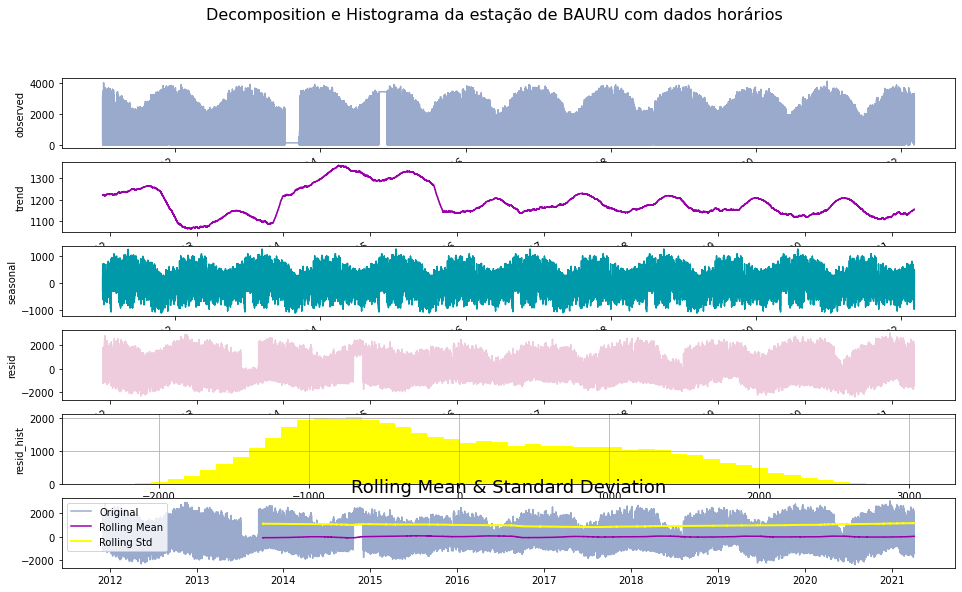

Results od Dickey0Fuller Test:
Test Statistic                -1.154851e+01
p-value                        3.493397e-21
#Lags Used                     5.300000e+01
Number of Observations Used    4.429100e+04
Critical Value(1%)            -3.430498e+00
Critical Value(5%)            -2.861605e+00
Critical Value(10%)           -2.566805e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary




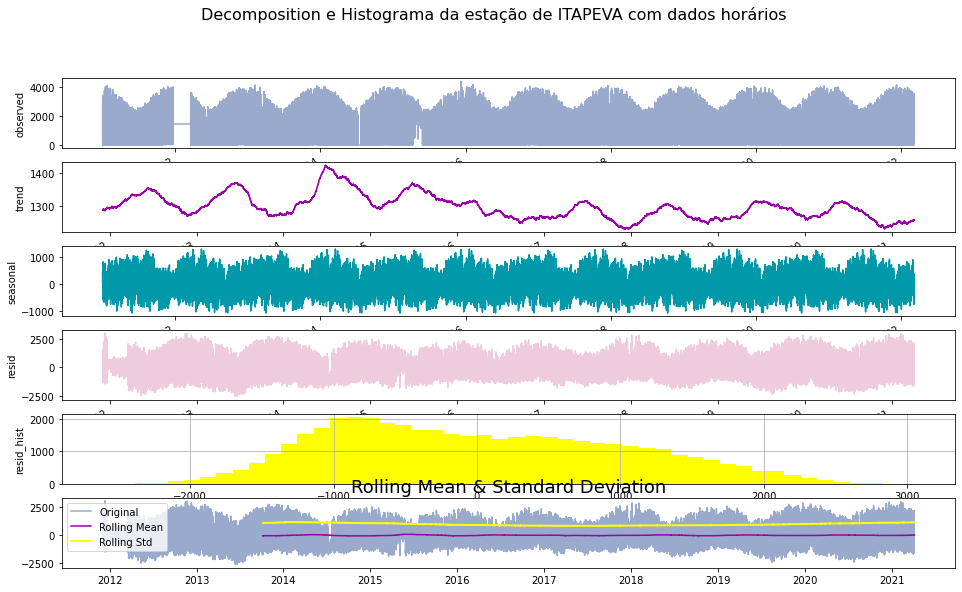

Results od Dickey0Fuller Test:
Test Statistic                -1.656025e+01
p-value                        1.910084e-29
#Lags Used                     5.500000e+01
Number of Observations Used    4.428900e+04
Critical Value(1%)            -3.430498e+00
Critical Value(5%)            -2.861605e+00
Critical Value(10%)           -2.566805e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary




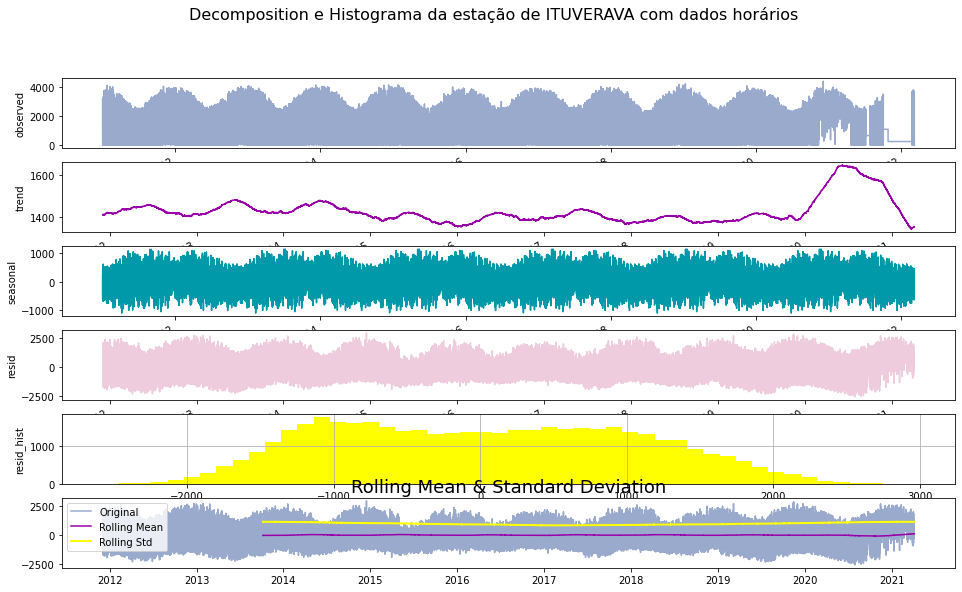

Results od Dickey0Fuller Test:
Test Statistic                -1.410848e+01
p-value                        2.544558e-26
#Lags Used                     5.500000e+01
Number of Observations Used    4.428900e+04
Critical Value(1%)            -3.430498e+00
Critical Value(5%)            -2.861605e+00
Critical Value(10%)           -2.566805e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary




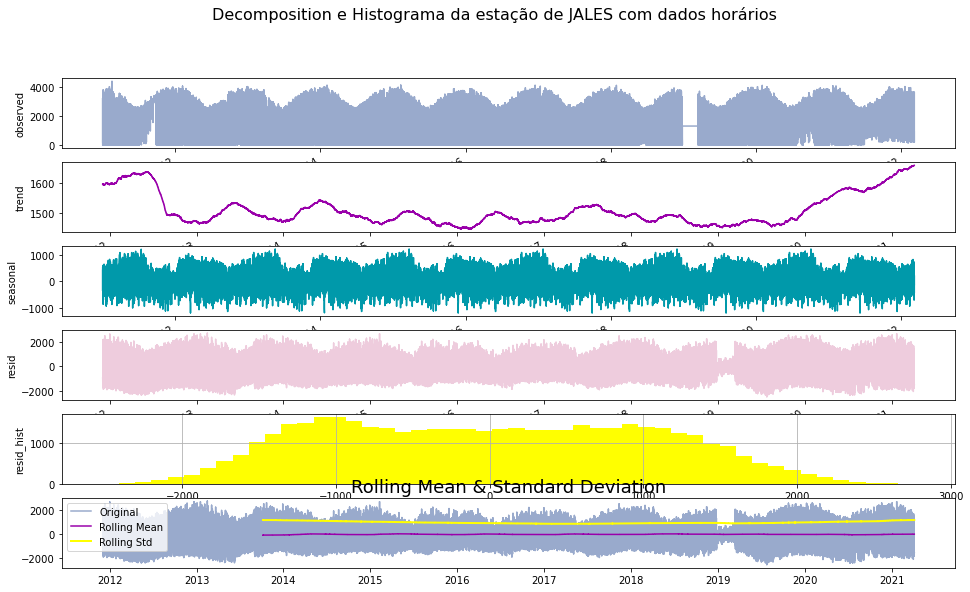

Results od Dickey0Fuller Test:
Test Statistic                -1.730413e+01
p-value                        5.605442e-30
#Lags Used                     5.500000e+01
Number of Observations Used    4.428900e+04
Critical Value(1%)            -3.430498e+00
Critical Value(5%)            -2.861605e+00
Critical Value(10%)           -2.566805e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary




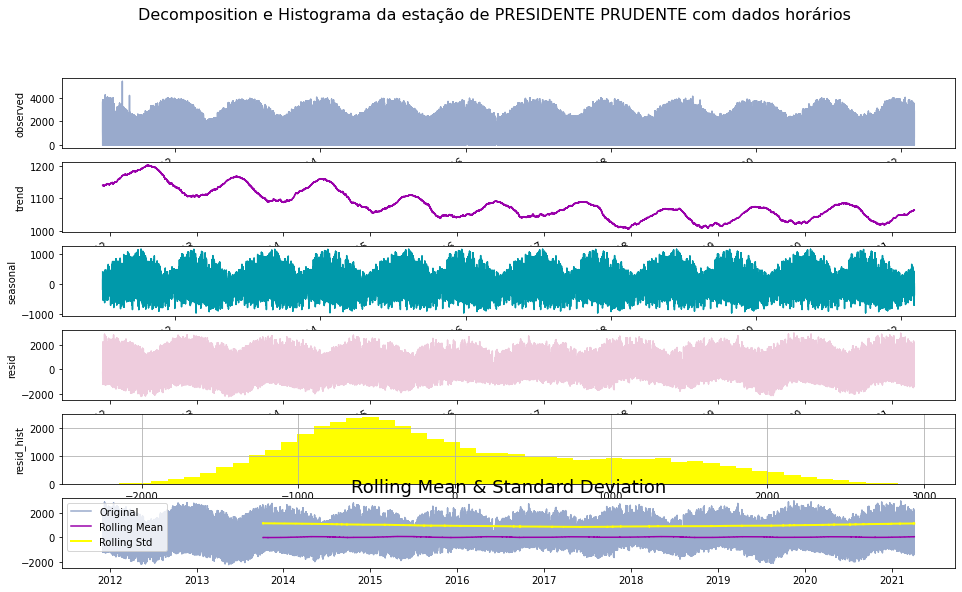

Results od Dickey0Fuller Test:
Test Statistic                -1.247832e+01
p-value                        3.132043e-23
#Lags Used                     5.200000e+01
Number of Observations Used    4.429200e+04
Critical Value(1%)            -3.430498e+00
Critical Value(5%)            -2.861605e+00
Critical Value(10%)           -2.566805e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary




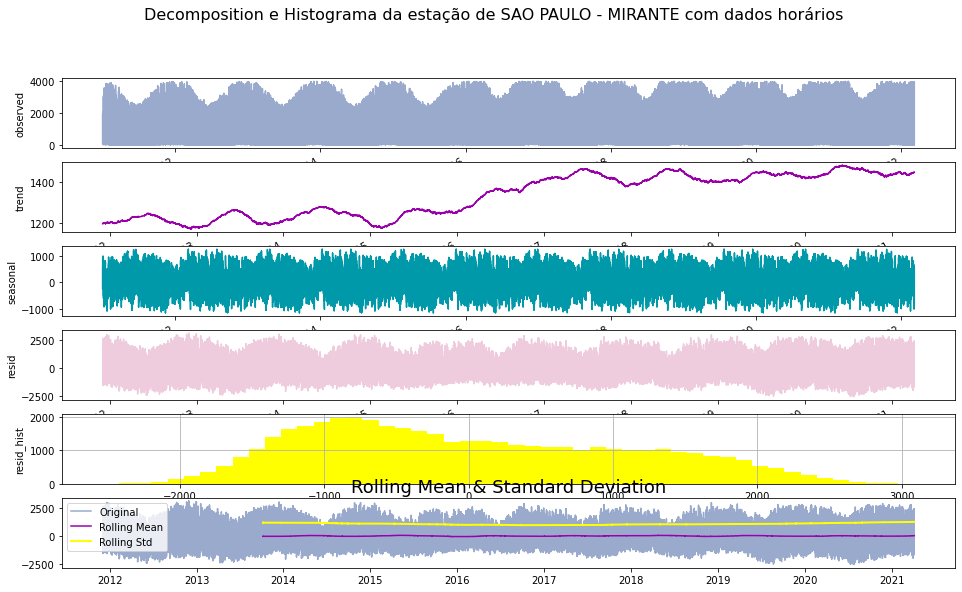

Results od Dickey0Fuller Test:
Test Statistic                   -19.801001
p-value                            0.000000
#Lags Used                        56.000000
Number of Observations Used    44288.000000
Critical Value(1%)                -3.430498
Critical Value(5%)                -2.861605
Critical Value(10%)               -2.566805
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary




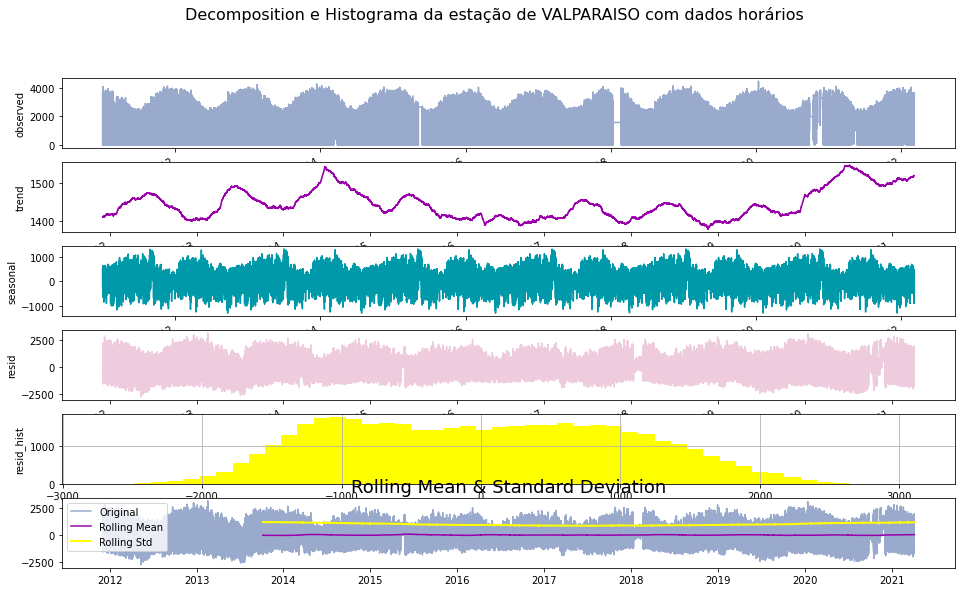

Results od Dickey0Fuller Test:
Test Statistic                -1.588897e+01
p-value                        8.584575e-29
#Lags Used                     5.400000e+01
Number of Observations Used    4.429000e+04
Critical Value(1%)            -3.430498e+00
Critical Value(5%)            -2.861605e+00
Critical Value(10%)           -2.566805e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary


In [69]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]

for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.RAD
    # Vamos realizar uma decomposição aditiva da nossa série, e estudar sua tendência, sazonalidade e resíduo.
    decomposition = seasonal_decompose(ts, freq=8760)  #365x24h

    fig, ax = plt.subplots(6, 1, figsize=(16, 10))
    fig.suptitle(f'Decomposition e Histograma da estação de {nome} com dados horários', fontsize=16)
    
    decomposition.observed.plot(ax=ax[0],color='#99aacc'); ax[0].set_ylabel('observed')
    decomposition.trend.plot(ax=ax[1],color='#9900aa'); ax[1].set_ylabel('trend')
    decomposition.seasonal.plot(ax=ax[2],color='#0099aa'); ax[2].set_ylabel('seasonal')
    decomposition.resid.plot(ax=ax[3],color='#eeccdd'); ax[3].set_ylabel('resid');
    # Vamos analisar a componente de resíduo com um pouco mais de cuidado:
    
    decomposition.resid.hist(ax=ax[4],bins=50,color='yellow'); ax[4].set_ylabel('resid_hist');
    print()
    print()
    test_stationarity(decomposition.resid.dropna(),8760)

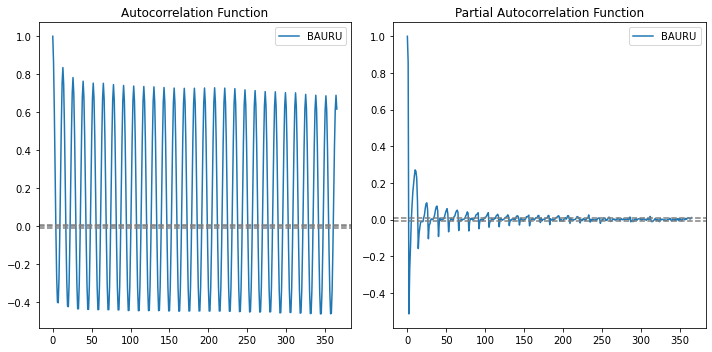

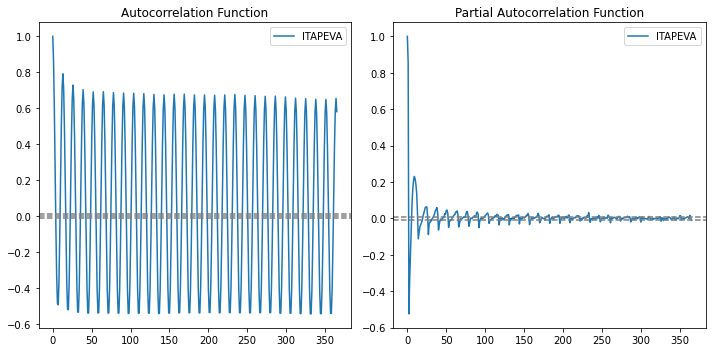

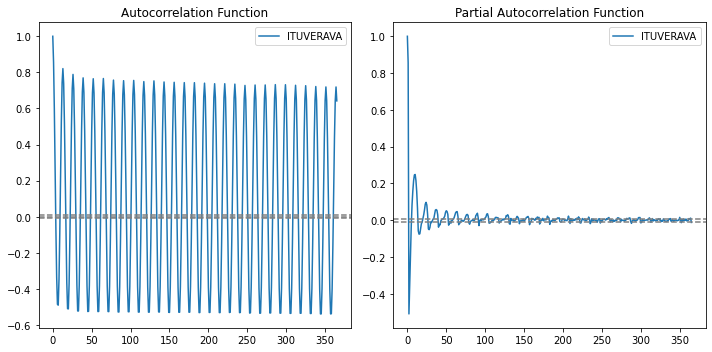

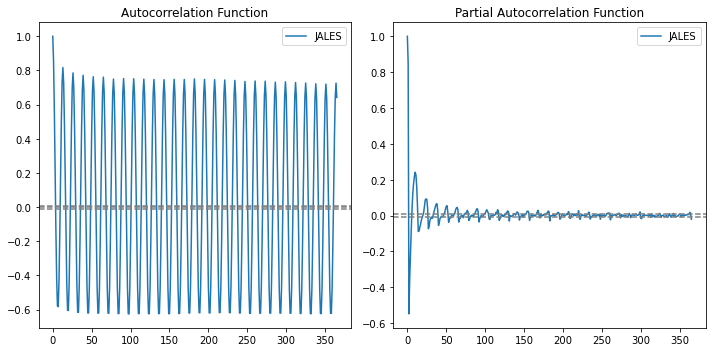

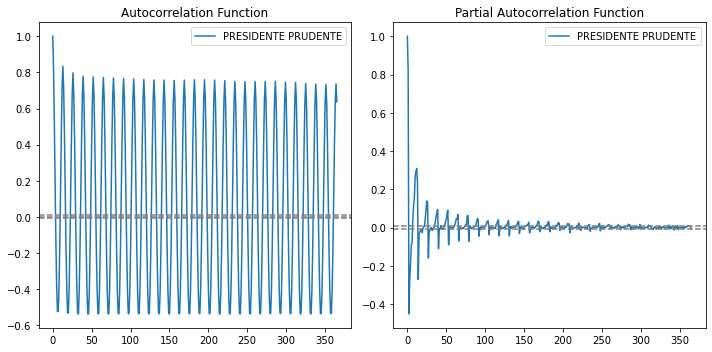

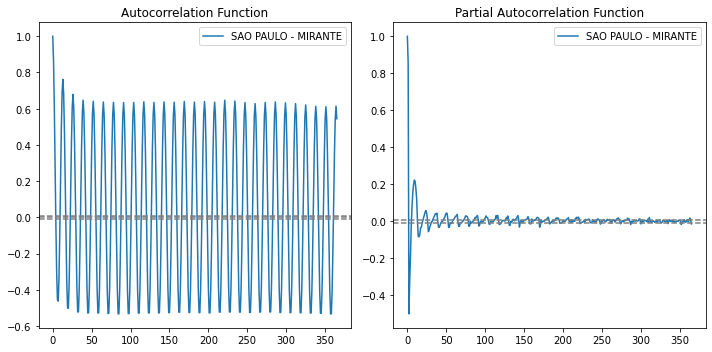

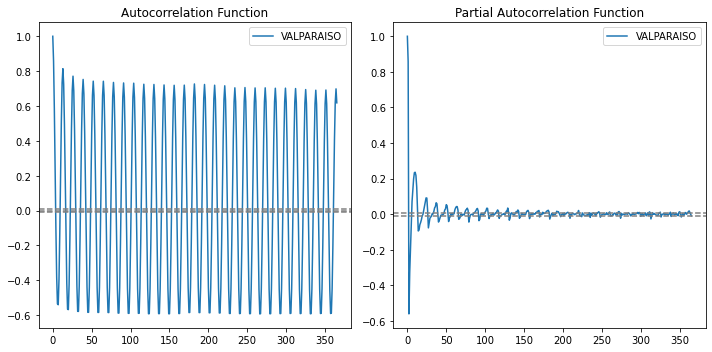

In [76]:
for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.RAD


    #ACF and PACF plots:
    from statsmodels.tsa.stattools import acf,pacf
    plt.figure(figsize=(10,5))
    lag_acf = acf(ts,nlags = 365)
    lag_pacf = pacf(ts,nlags = 365, method='ols')

    #Plot ACF:
    plt.subplot(121)
    plt.plot(lag_acf, label = f'{nome}')
    plt.axhline(y=0, linestyle='--', color='gray')
    plt.axhline(y=-1.96/np.sqrt(len(ts)),linestyle='--',color='gray')
    plt.axhline(y=1.96/np.sqrt(len(ts)),linestyle='--',color='gray')
    plt.title('Autocorrelation Function')
    plt.legend()
    #Plot PACF:
    plt.subplot(122)
    plt.plot(lag_pacf, label = f'{nome}')
    plt.axhline(y=-1.96/np.sqrt(len(ts)),linestyle='--',color='gray')
    plt.axhline(y=1.96/np.sqrt(len(ts)),linestyle='--',color='gray')
    plt.title('Partial Autocorrelation Function')
    plt.tight_layout()
    plt.legend()

# Dados Mensal

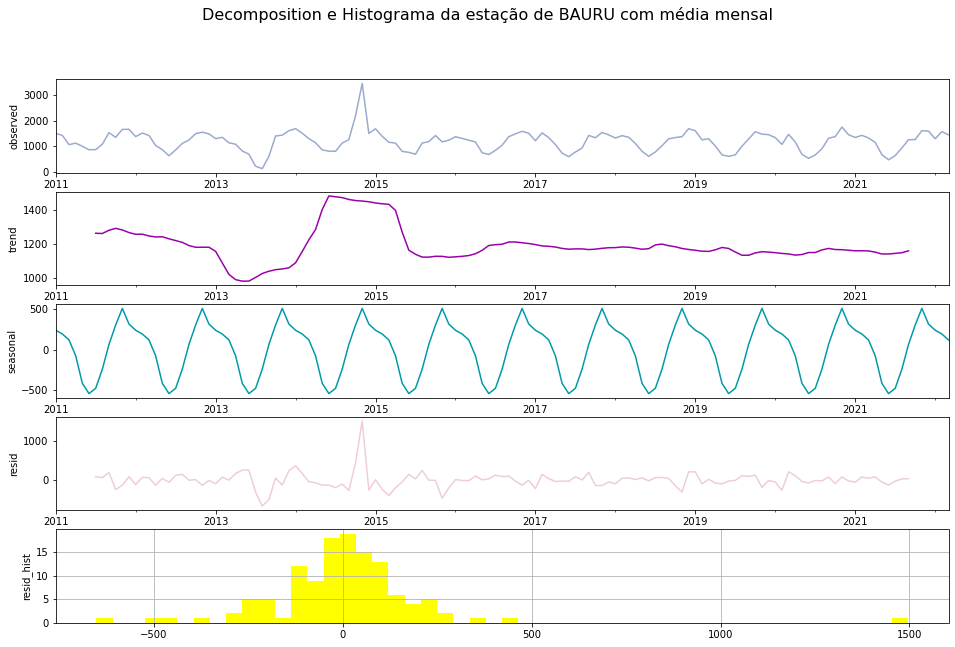

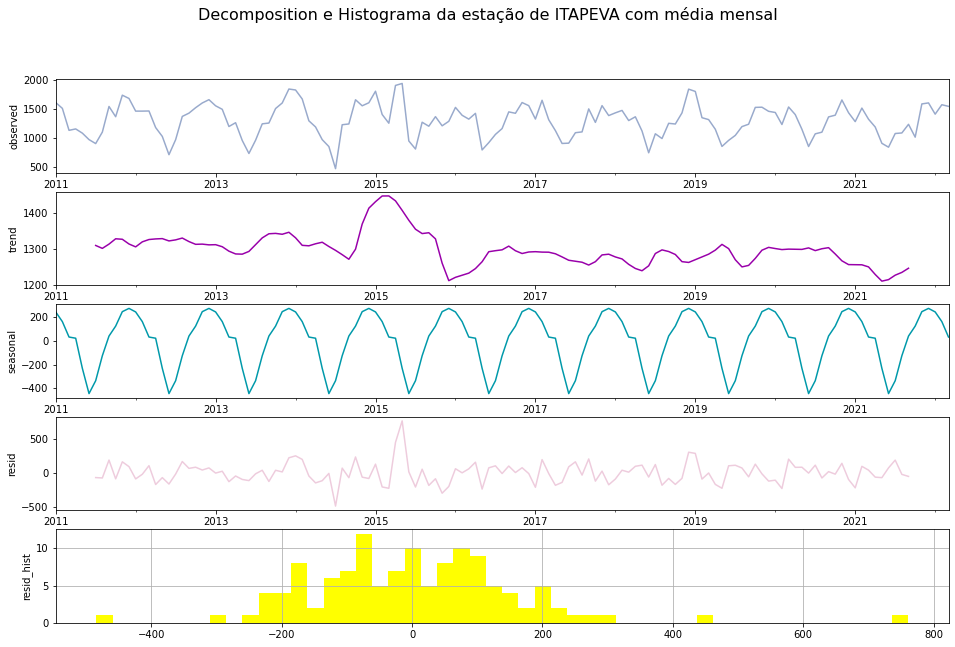

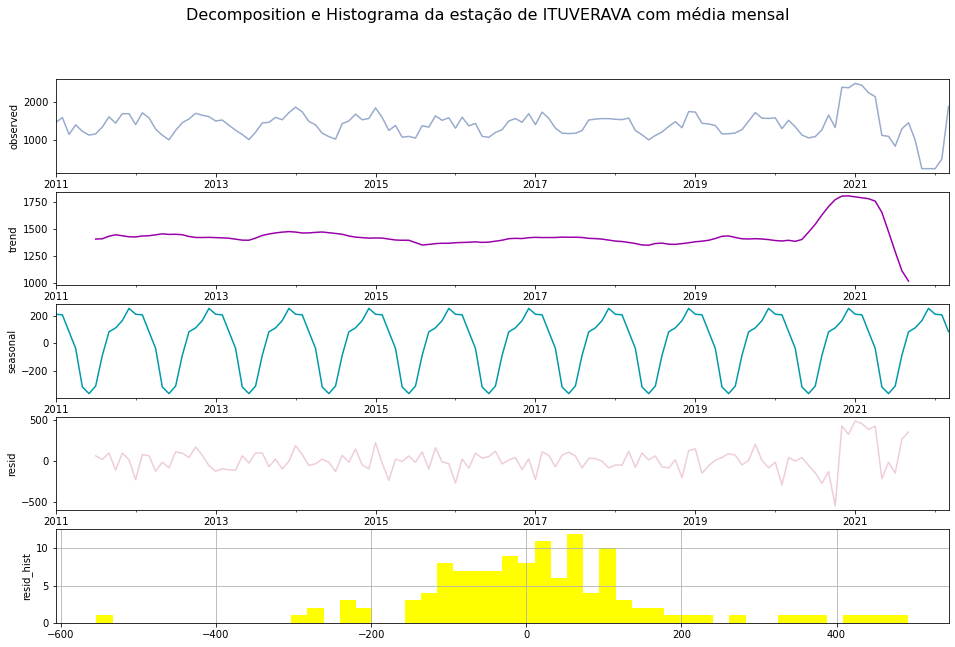

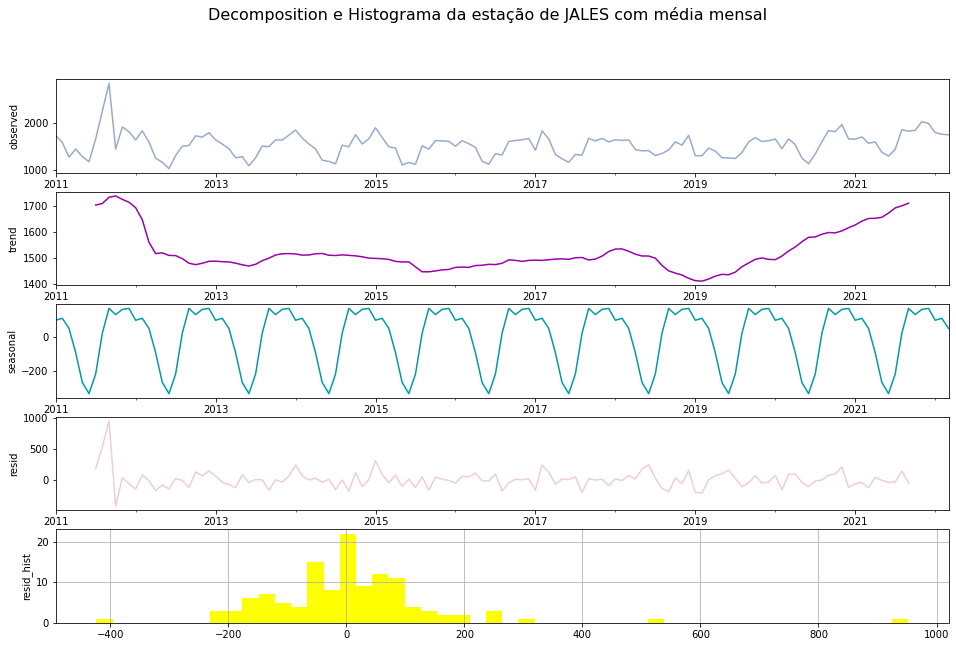

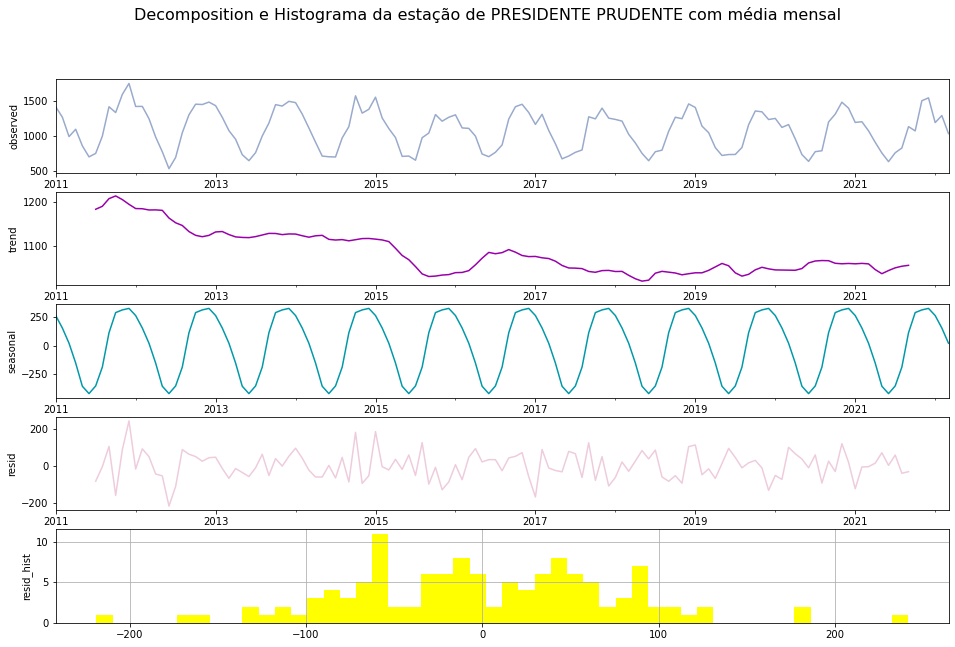

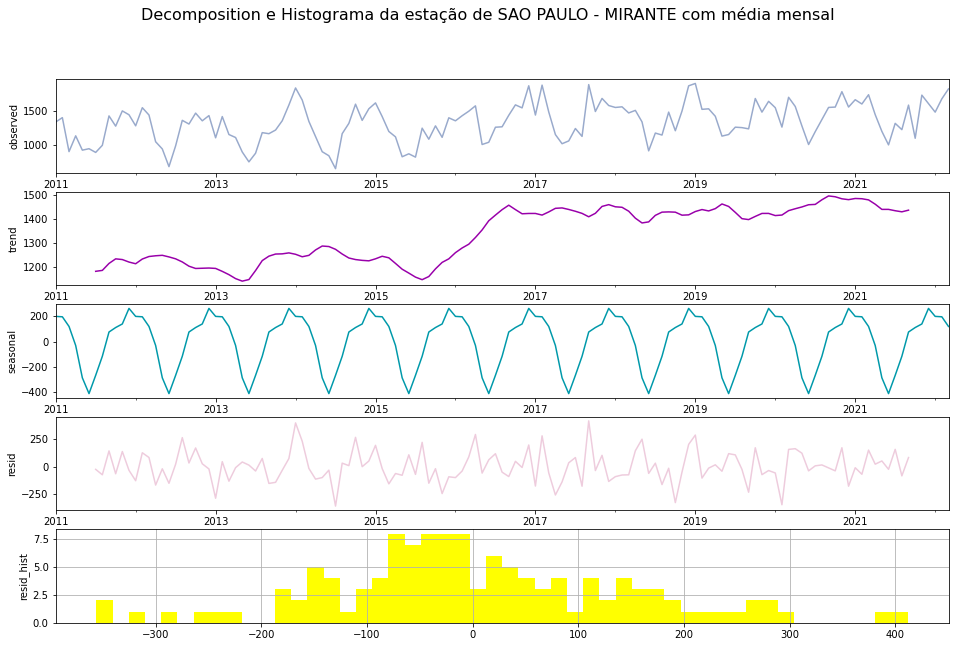

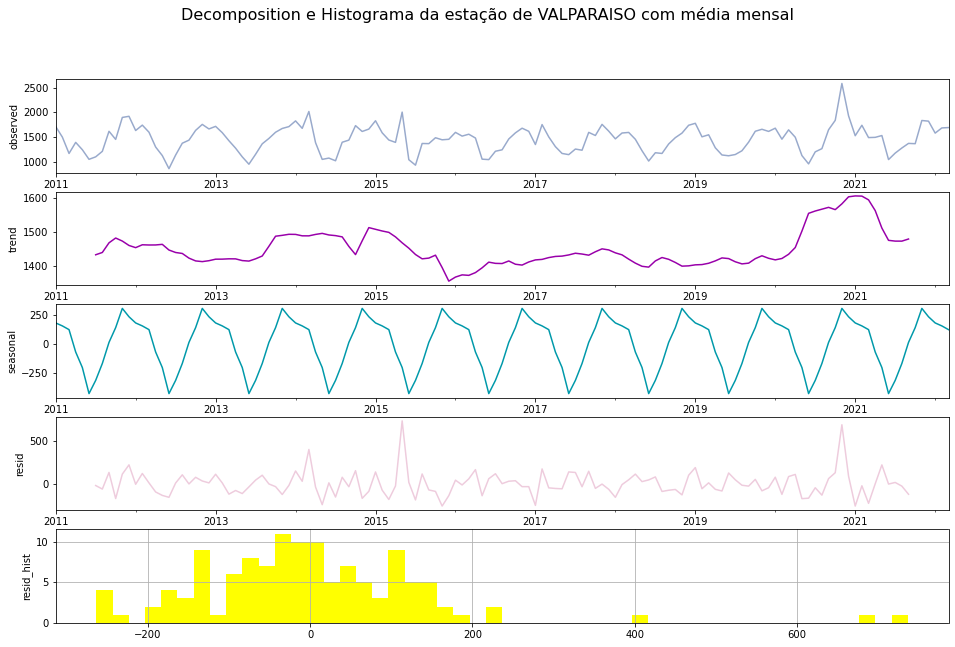

In [21]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]

for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.resample('M').mean().RAD
    # Vamos realizar uma decomposição aditiva da nossa série, e estudar sua tendência, sazonalidade e resíduo.
    decomposition = seasonal_decompose(ts, freq=12)

    fig, ax = plt.subplots(5, 1, figsize=(16, 10))
    fig.suptitle(f'Decomposition e Histograma da estação de {nome} com média mensal', fontsize=16)
    
    decomposition.observed.plot(ax=ax[0],color='#99aacc'); ax[0].set_ylabel('observed')
    decomposition.trend.plot(ax=ax[1],color='#9900aa'); ax[1].set_ylabel('trend')
    decomposition.seasonal.plot(ax=ax[2],color='#0099aa'); ax[2].set_ylabel('seasonal')
    decomposition.resid.plot(ax=ax[3],color='#eeccdd'); ax[3].set_ylabel('resid');
    # Vamos analisar a componente de resíduo com um pouco mais de cuidado:
    
    decomposition.resid.hist(ax=ax[4],bins=50,color='yellow'); ax[4].set_ylabel('resid_hist');

# Dados Diários

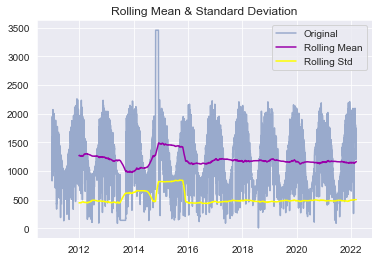

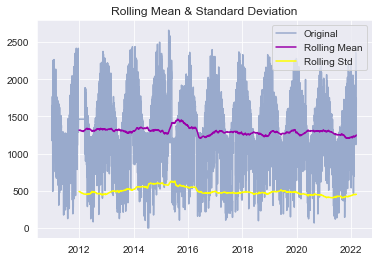

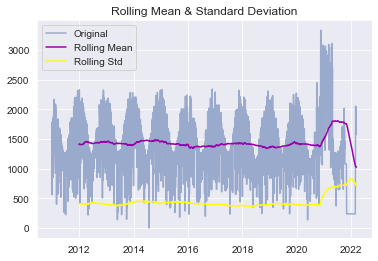

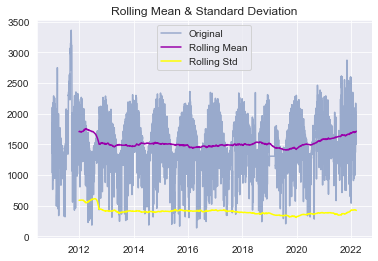

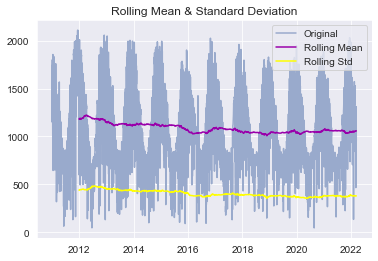

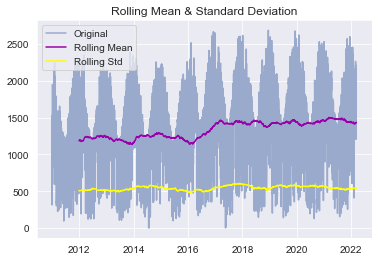

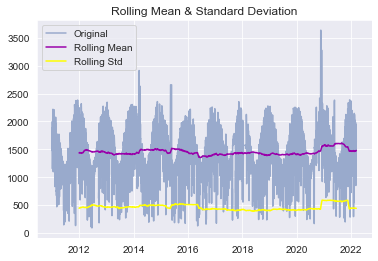

In [157]:
# Plot rolling statistics:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]


for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.resample('D').mean().RAD
    rolmean = ts.rolling(window=365).mean()
    rolstd = ts.rolling(window=365).std()
    
    
    orig = plt.plot(ts, color='#99aacc',label='Original')
    mean = plt.plot(rolmean, color='#9900aa', label = 'Rolling Mean')
    std = plt.plot(rolstd, color='yellow', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)

Estação:  BAURU


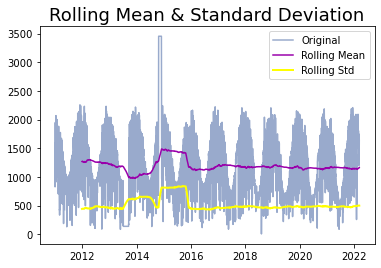

Results of Dickey&Fuller Test:
Test Statistic                   -5.455172
p-value                           0.000003
#Lags Used                       17.000000
Number of Observations Used    4067.000000
Critical Value(1%)               -3.431959
Critical Value(5%)               -2.862251
Critical Value(10%)              -2.567148
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
-*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*-
Estação:  ITAPEVA


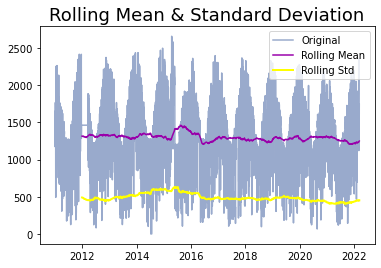

Results of Dickey&Fuller Test:
Test Statistic                -6.625434e+00
p-value                        5.892601e-09
#Lags Used                     2.100000e+01
Number of Observations Used    4.063000e+03
Critical Value(1%)            -3.431960e+00
Critical Value(5%)            -2.862252e+00
Critical Value(10%)           -2.567149e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
-*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*-
Estação:  ITUVERAVA


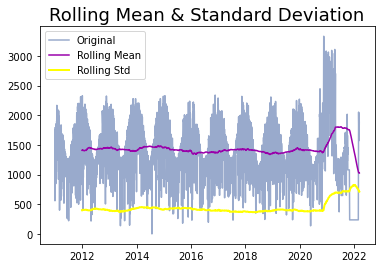

Results of Dickey&Fuller Test:
Test Statistic                   -5.436795
p-value                           0.000003
#Lags Used                       21.000000
Number of Observations Used    4063.000000
Critical Value(1%)               -3.431960
Critical Value(5%)               -2.862252
Critical Value(10%)              -2.567149
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
-*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*-
Estação:  JALES


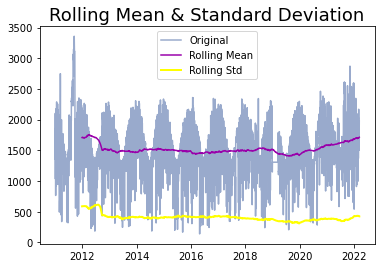

Results of Dickey&Fuller Test:
Test Statistic                -5.874664e+00
p-value                        3.180228e-07
#Lags Used                     2.800000e+01
Number of Observations Used    4.056000e+03
Critical Value(1%)            -3.431963e+00
Critical Value(5%)            -2.862253e+00
Critical Value(10%)           -2.567149e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
-*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*-
Estação:  PRESIDENTE PRUDENTE


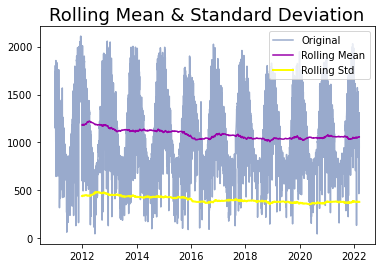

Results of Dickey&Fuller Test:
Test Statistic                   -4.706095
p-value                           0.000082
#Lags Used                       21.000000
Number of Observations Used    4063.000000
Critical Value(1%)               -3.431960
Critical Value(5%)               -2.862252
Critical Value(10%)              -2.567149
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
-*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*-
Estação:  SAO PAULO - MIRANTE


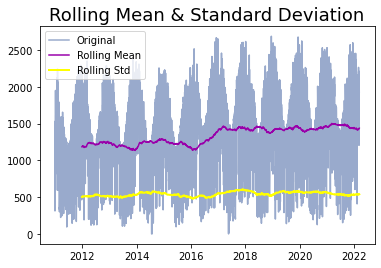

Results of Dickey&Fuller Test:
Test Statistic                -6.719886e+00
p-value                        3.504868e-09
#Lags Used                     2.100000e+01
Number of Observations Used    4.063000e+03
Critical Value(1%)            -3.431960e+00
Critical Value(5%)            -2.862252e+00
Critical Value(10%)           -2.567149e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
-*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*-
Estação:  VALPARAISO


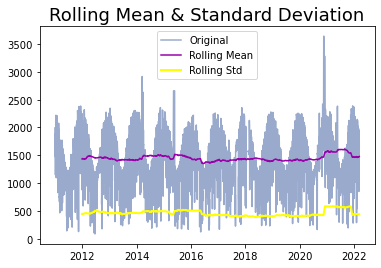

Results of Dickey&Fuller Test:
Test Statistic                -7.870820e+00
p-value                        4.990754e-12
#Lags Used                     1.800000e+01
Number of Observations Used    4.066000e+03
Critical Value(1%)            -3.431959e+00
Critical Value(5%)            -2.862251e+00
Critical Value(10%)           -2.567149e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary
-*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*--*-


In [81]:
from statsmodels.tsa.stattools import adfuller
for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    print('Estação: ',nome)
    ts = df.resample('D').mean().RAD
    test_stationarity(ts,365)
    print('-*-'*20)

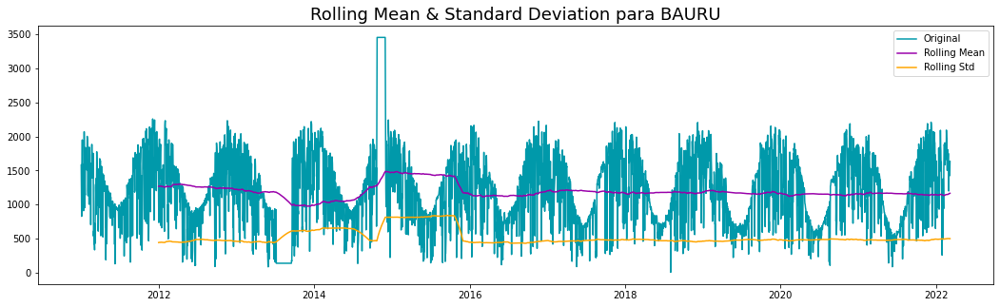

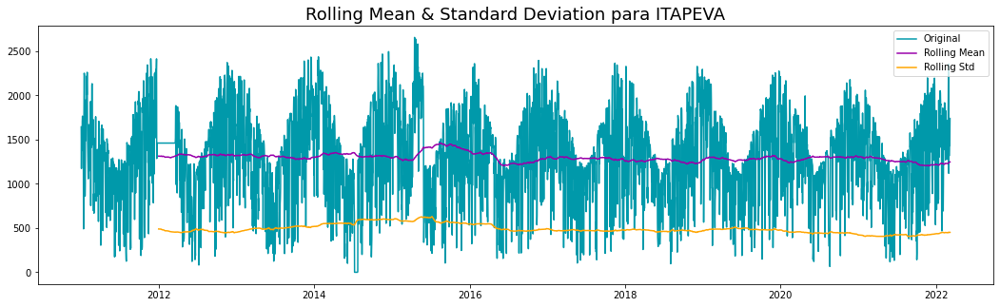

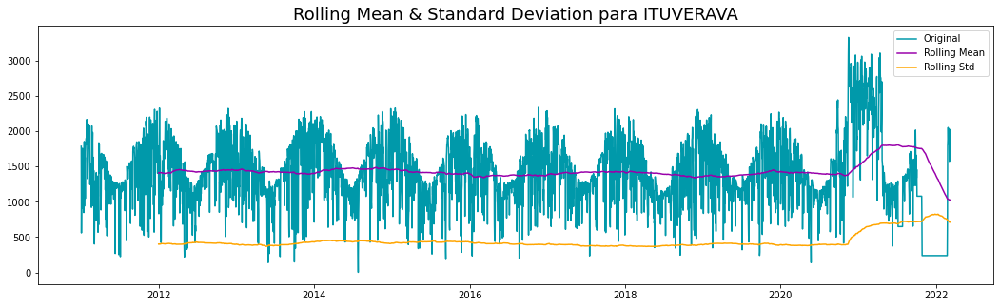

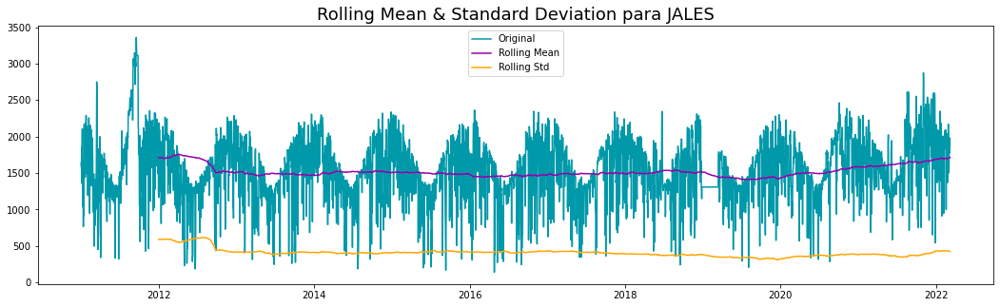

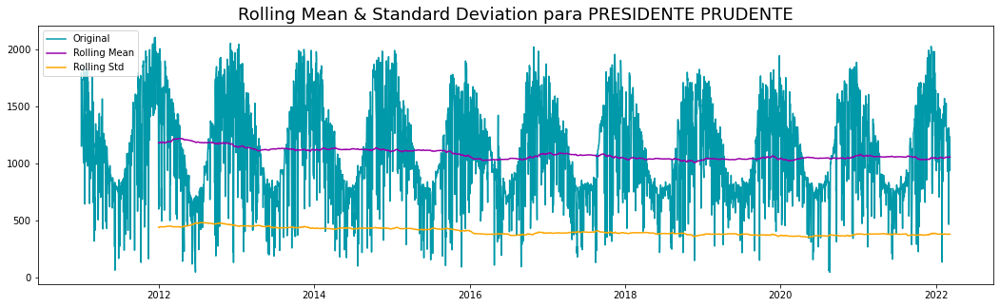

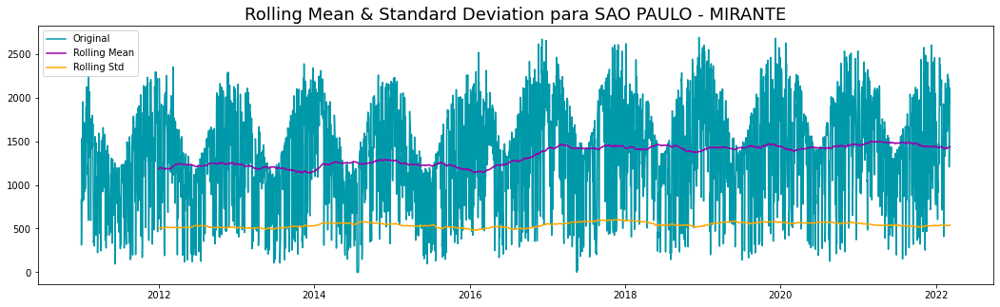

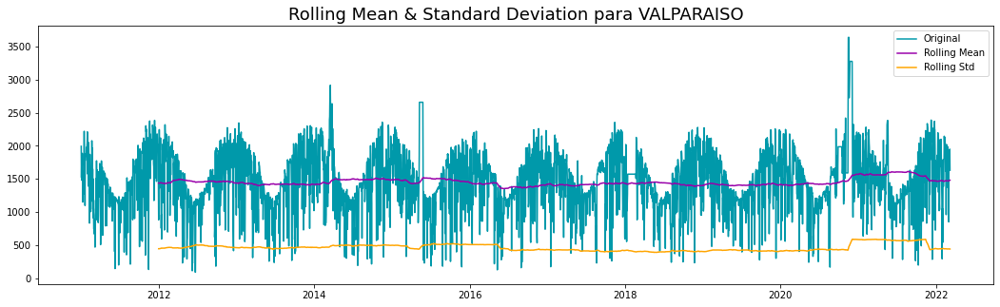

In [82]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]

for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.resample('D').mean().RAD  #
    
    #Determing rolling statistics
    rolmean = ts.rolling(365).mean()
    rolstd = ts.rolling(365).std()

    #Plot rolling statistics:
    plt.figure(figsize = (18, 5))
    orig = plt.plot(ts, color='#0099aa',label='Original')
    mean = plt.plot(rolmean, color='#9900aa', label='Rolling Mean')
    std = plt.plot(rolstd, color='orange', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title(f'Rolling Mean & Standard Deviation para {nome}',fontsize=18)
    plt.show()

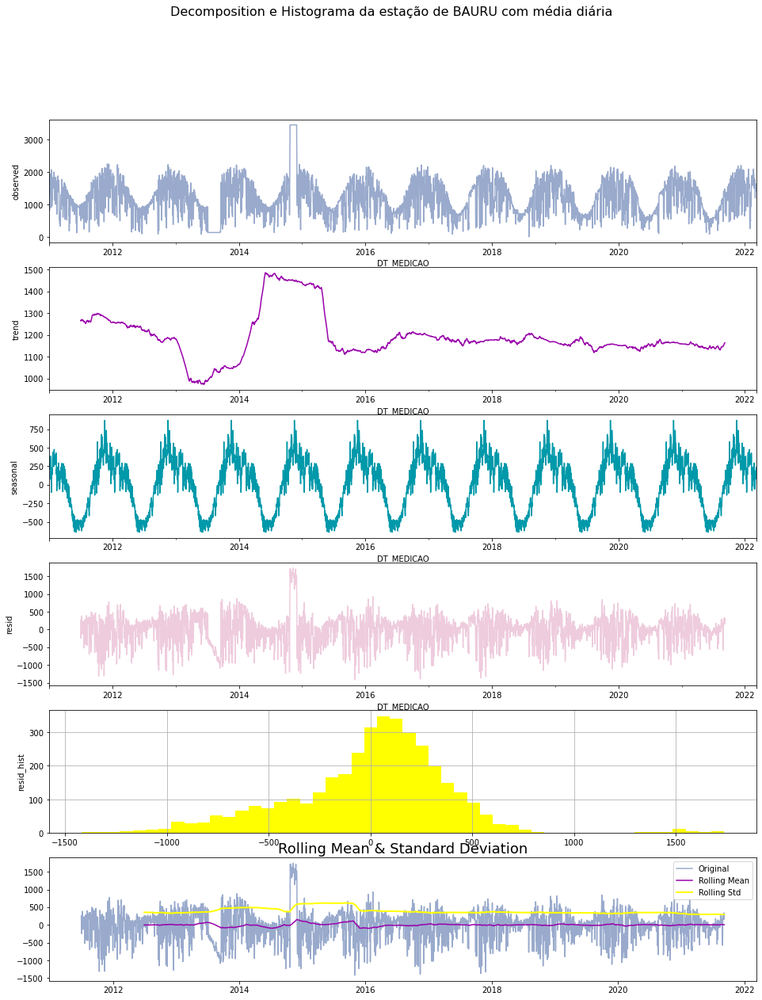

Results of Dickey&Fuller Test:
Test Statistic                -9.224014e+00
p-value                        1.748858e-15
#Lags Used                     1.500000e+01
Number of Observations Used    3.705000e+03
Critical Value(1%)            -3.432116e+00
Critical Value(5%)            -2.862320e+00
Critical Value(10%)           -2.567185e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary


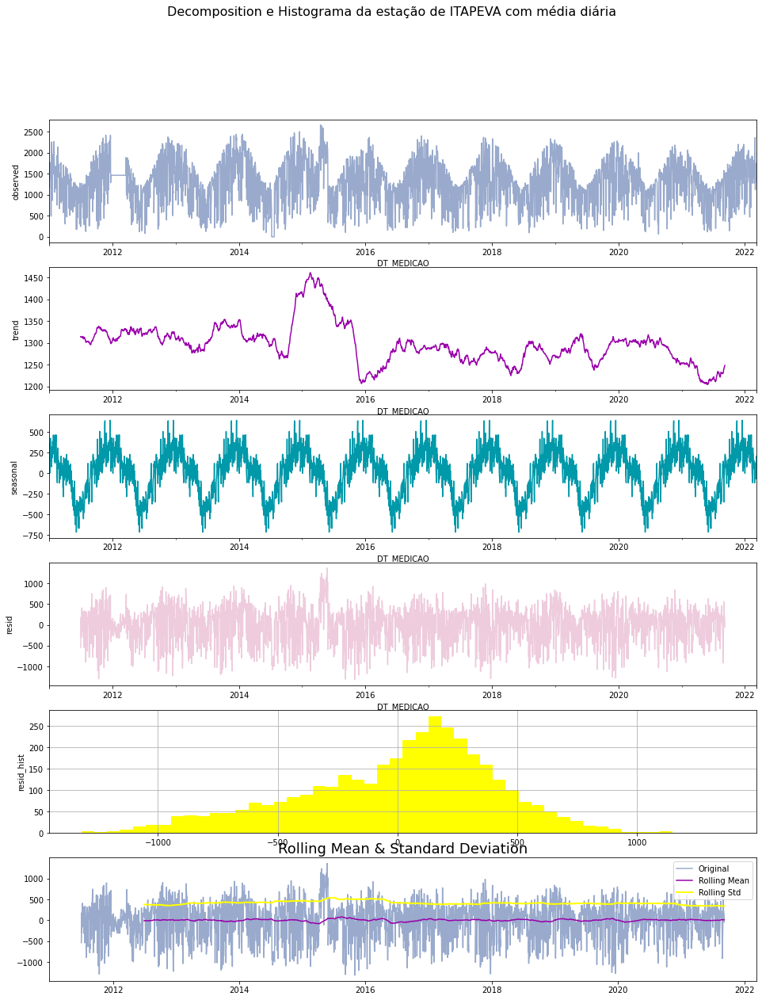

Results of Dickey&Fuller Test:
Test Statistic                  -21.090051
p-value                           0.000000
#Lags Used                        4.000000
Number of Observations Used    3716.000000
Critical Value(1%)               -3.432111
Critical Value(5%)               -2.862318
Critical Value(10%)              -2.567184
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary


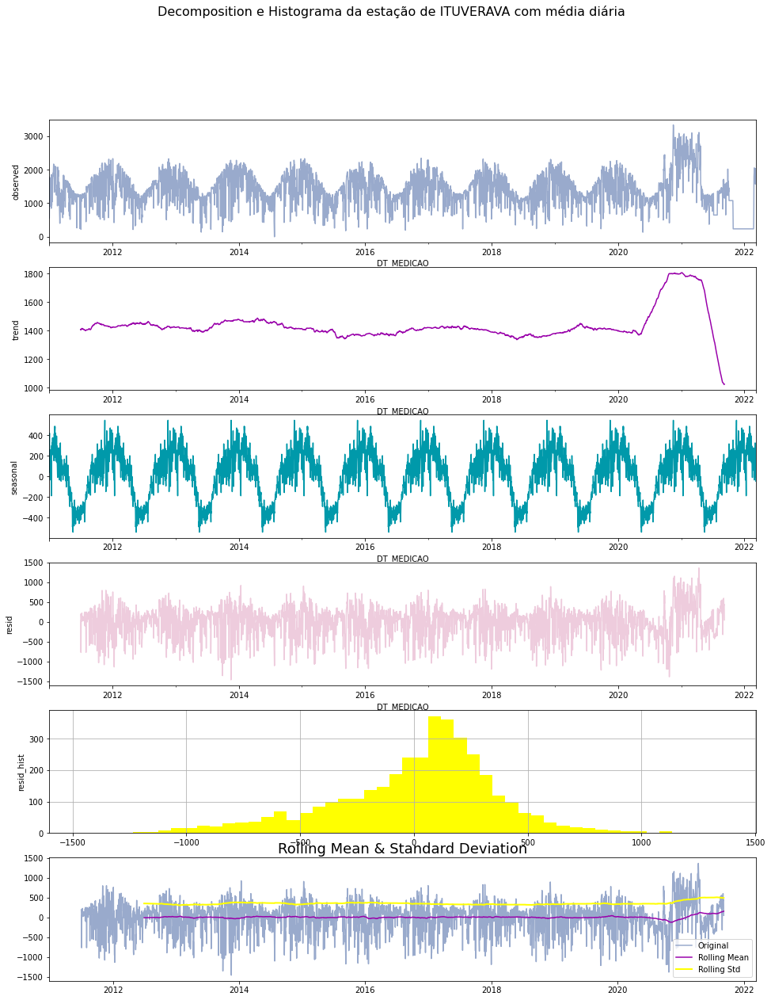

Results of Dickey&Fuller Test:
Test Statistic                -1.382075e+01
p-value                        7.913514e-26
#Lags Used                     9.000000e+00
Number of Observations Used    3.711000e+03
Critical Value(1%)            -3.432113e+00
Critical Value(5%)            -2.862319e+00
Critical Value(10%)           -2.567185e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary


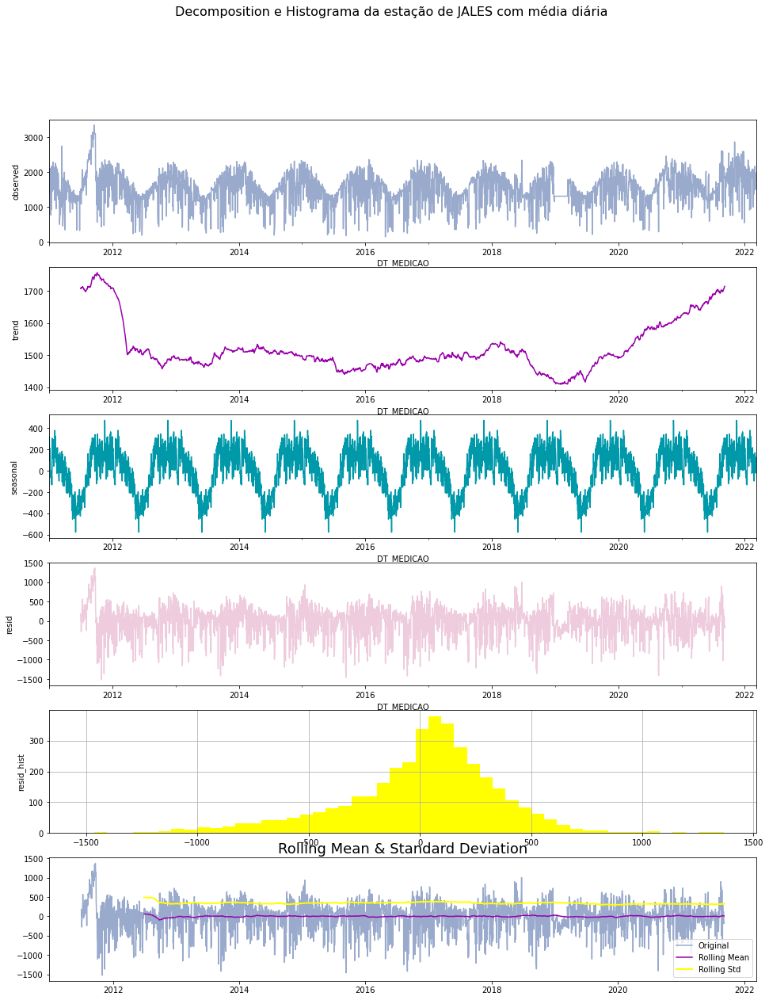

Results of Dickey&Fuller Test:
Test Statistic                -1.146904e+01
p-value                        5.322750e-21
#Lags Used                     1.400000e+01
Number of Observations Used    3.706000e+03
Critical Value(1%)            -3.432116e+00
Critical Value(5%)            -2.862320e+00
Critical Value(10%)           -2.567185e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary


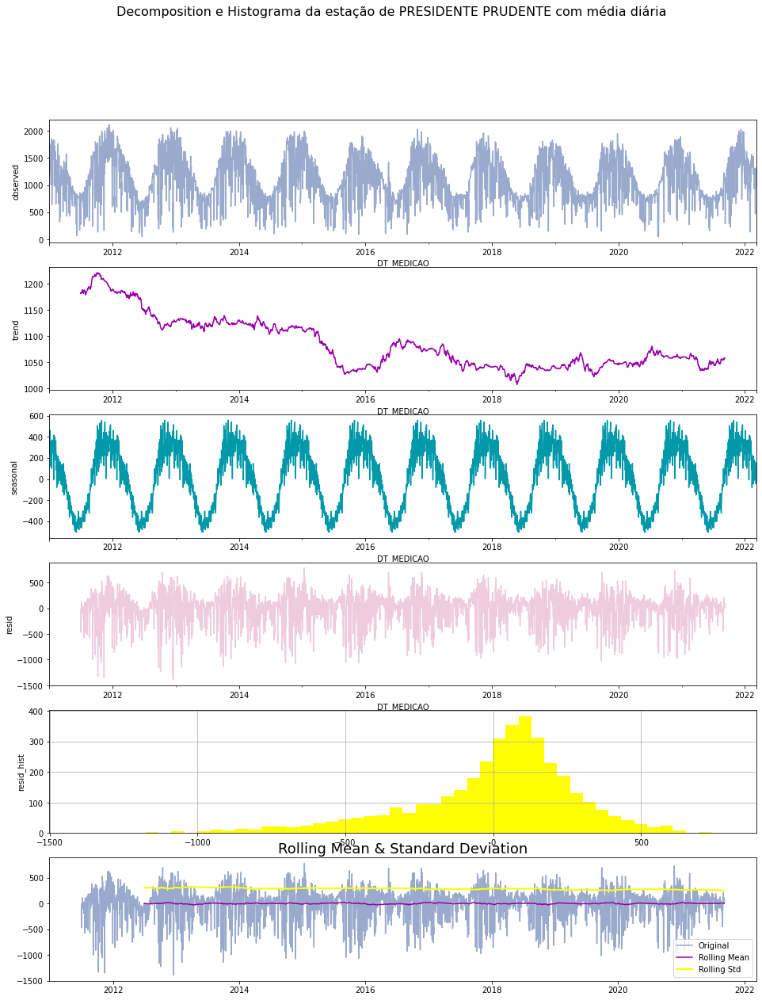

Results of Dickey&Fuller Test:
Test Statistic                  -23.302462
p-value                           0.000000
#Lags Used                        4.000000
Number of Observations Used    3716.000000
Critical Value(1%)               -3.432111
Critical Value(5%)               -2.862318
Critical Value(10%)              -2.567184
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary


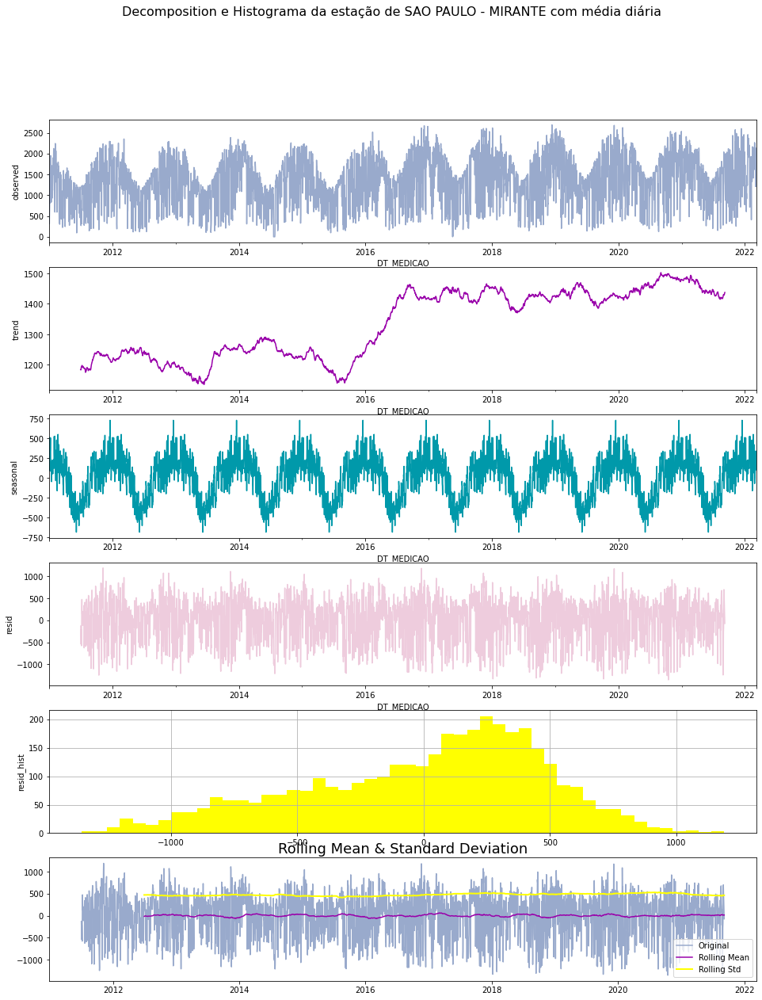

Results of Dickey&Fuller Test:
Test Statistic                  -34.416236
p-value                           0.000000
#Lags Used                        1.000000
Number of Observations Used    3719.000000
Critical Value(1%)               -3.432110
Critical Value(5%)               -2.862317
Critical Value(10%)              -2.567184
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary


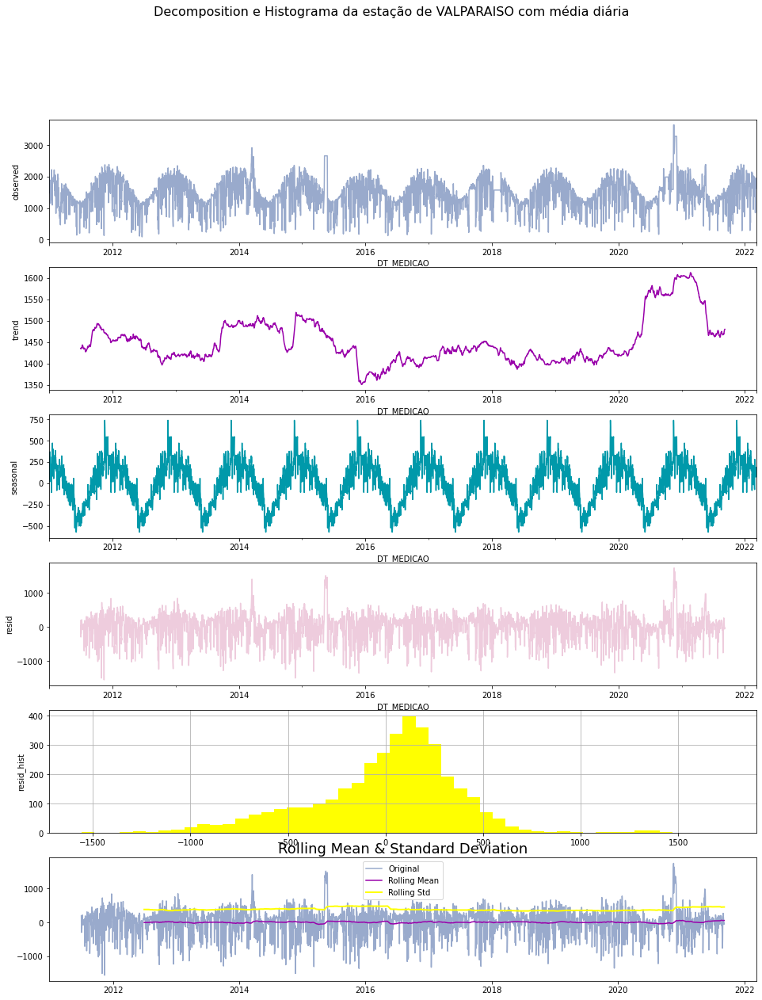

Results of Dickey&Fuller Test:
Test Statistic                -1.270458e+01
p-value                        1.061896e-23
#Lags Used                     1.700000e+01
Number of Observations Used    3.703000e+03
Critical Value(1%)            -3.432117e+00
Critical Value(5%)            -2.862321e+00
Critical Value(10%)           -2.567186e+00
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary


In [84]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]

for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.resample('D').mean().RAD
    # Vamos realizar uma decomposição aditiva da nossa série, e estudar sua tendência, sazonalidade e resíduo.
    decomposition = seasonal_decompose(ts, freq=365)

    fig, ax = plt.subplots(6, 1, figsize=(16, 20))
    fig.suptitle(f'Decomposition e Histograma da estação de {nome} com média diária', fontsize=16)
    
    decomposition.observed.plot(ax=ax[0],color='#99aacc'); ax[0].set_ylabel('observed')
    decomposition.trend.plot(ax=ax[1],color='#9900aa'); ax[1].set_ylabel('trend')
    decomposition.seasonal.plot(ax=ax[2],color='#0099aa'); ax[2].set_ylabel('seasonal')
    decomposition.resid.plot(ax=ax[3],color='#eeccdd'); ax[3].set_ylabel('resid');
    # Vamos analisar a componente de resíduo com um pouco mais de cuidado:
    
    decomposition.resid.hist(ax=ax[4],bins=50,color='yellow'); ax[4].set_ylabel('resid_hist')
    test_stationarity(decomposition.resid.dropna(),365);

In [ ]:
#Residual is stationary so it doesn't need to subtract the MA

## Correlações:
        - autocorrelação: autocorrelation function  ACF
        

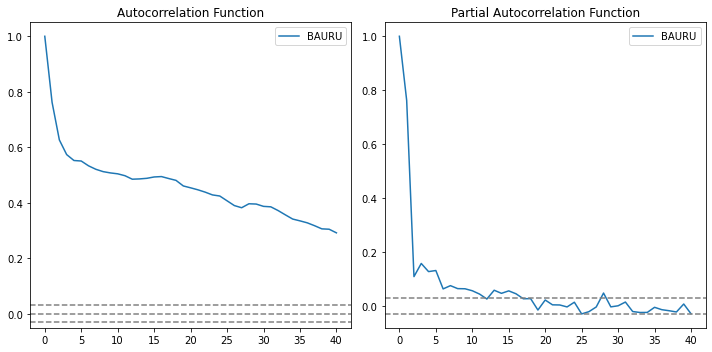

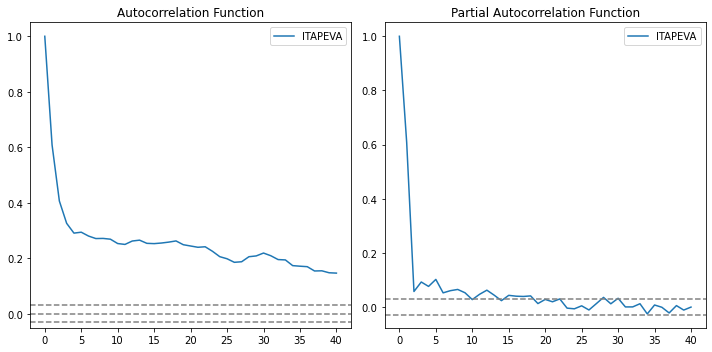

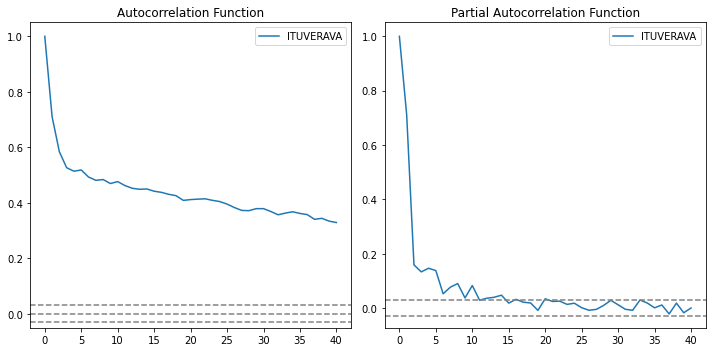

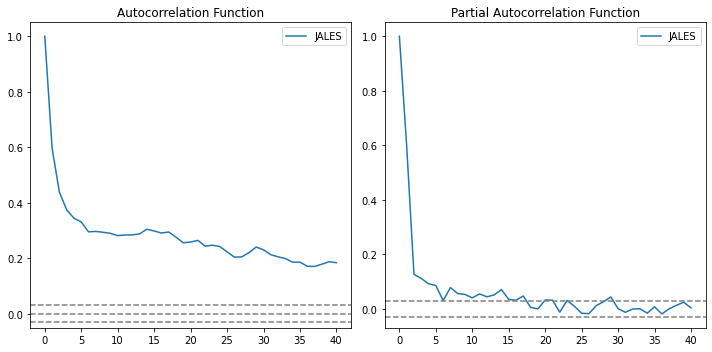

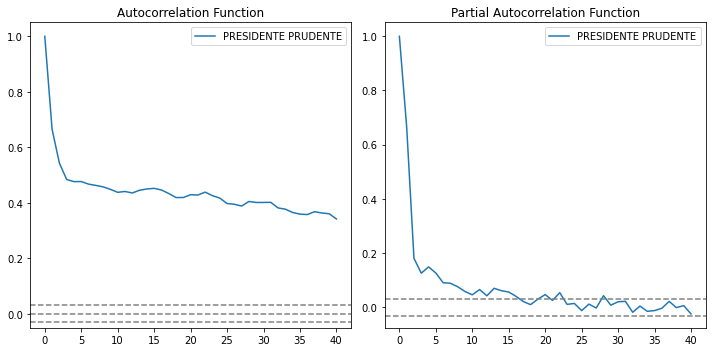

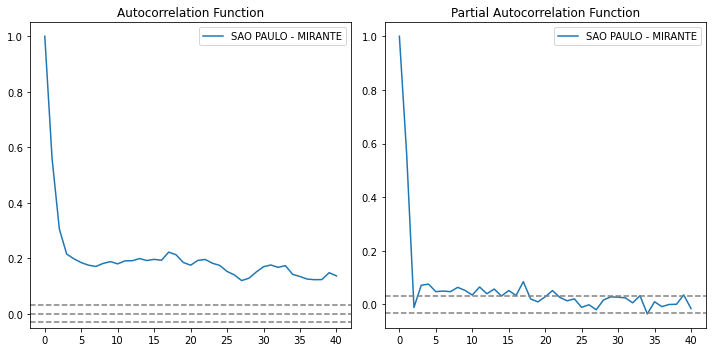

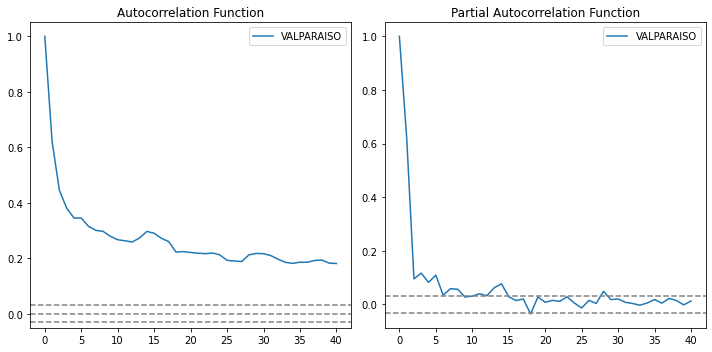

In [179]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]
for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.resample('D').mean().RAD


    #ACF and PACF plots:
    from statsmodels.tsa.stattools import acf,pacf
    plt.figure(figsize=(10,5))
    lag_acf = acf(ts,nlags = 40)
    lag_pacf = pacf(ts,nlags = 40, method='ols')

    #Plot ACF:
    plt.subplot(121)
    plt.plot(lag_acf, label = f'{nome}')
    plt.axhline(y=0, linestyle='--', color='gray')
    plt.axhline(y=-1.96/np.sqrt(len(ts)),linestyle='--',color='gray')
    plt.axhline(y=1.96/np.sqrt(len(ts)),linestyle='--',color='gray')
    plt.title('Autocorrelation Function')
    plt.legend()
    #Plot PACF:
    plt.subplot(122)
    plt.plot(lag_pacf, label = f'{nome}')
    plt.axhline(y=-1.96/np.sqrt(len(ts)),linestyle='--',color='gray')
    plt.axhline(y=1.96/np.sqrt(len(ts)),linestyle='--',color='gray')
    plt.title('Partial Autocorrelation Function')
    plt.tight_layout()
    plt.legend()

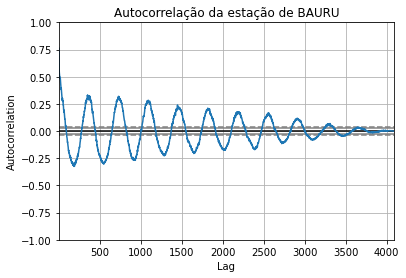

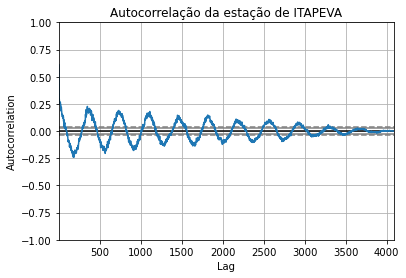

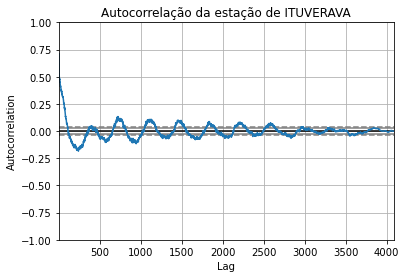

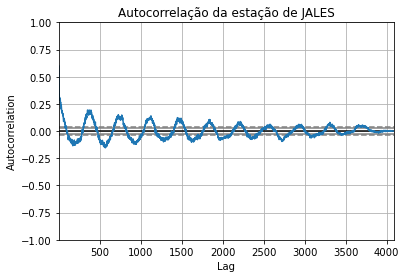

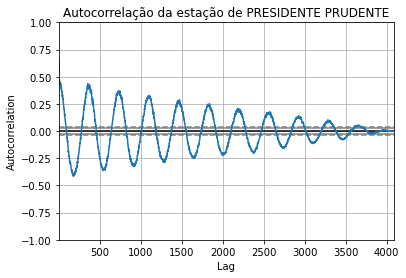

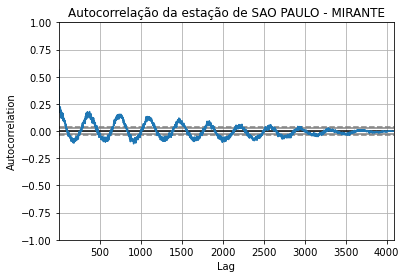

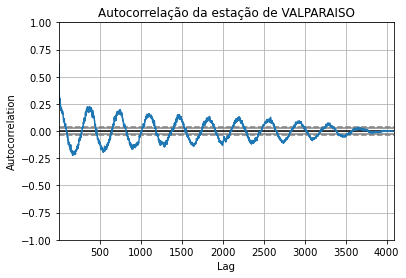

In [23]:
from pandas.plotting import autocorrelation_plot
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]
for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.resample('D').mean().RAD
    plt.title(f'Autocorrelação da estação de {nome}')
    autocorrelation_plot(ts)
    plt.show()

## PACF

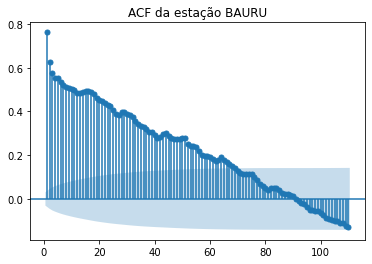

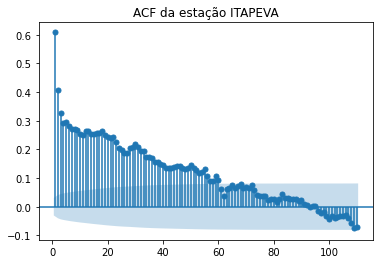

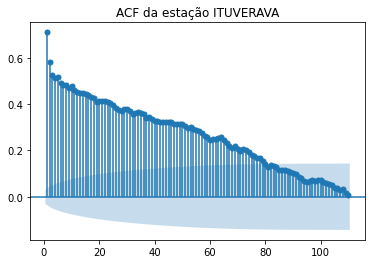

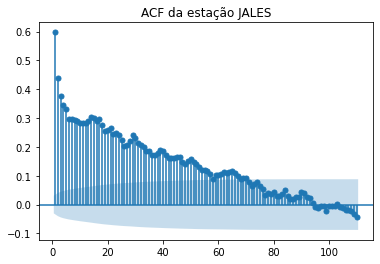

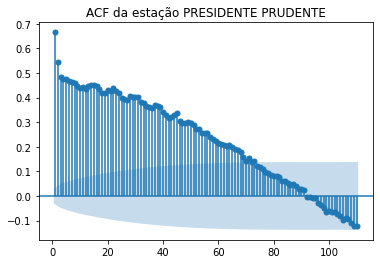

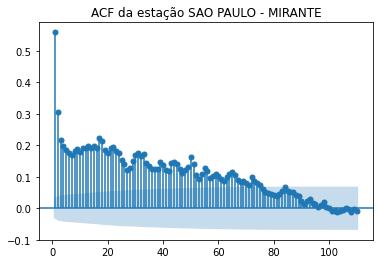

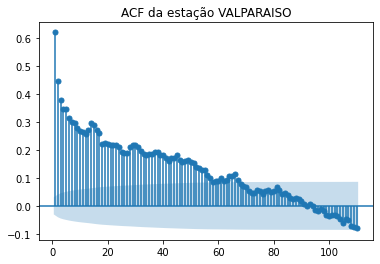

In [103]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]
for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.resample('D').mean().RAD
    
    plot_acf(ts,lags=110,zero=False,title=f"ACF da estação {nome}")

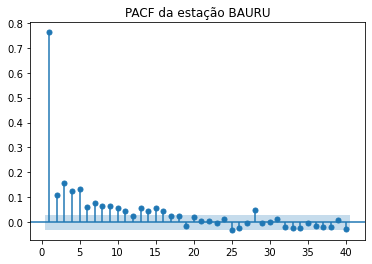

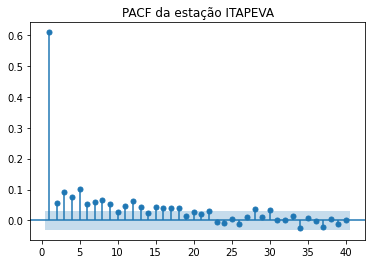

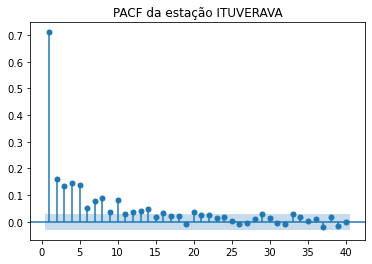

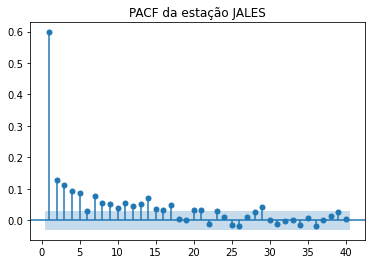

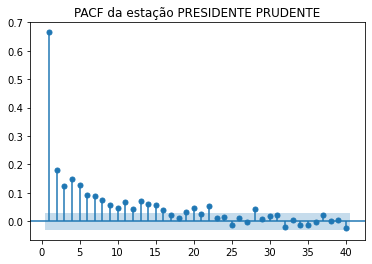

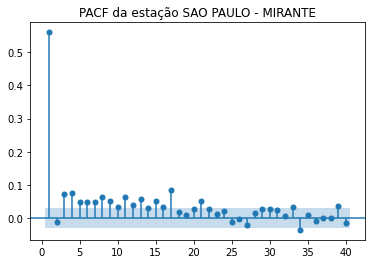

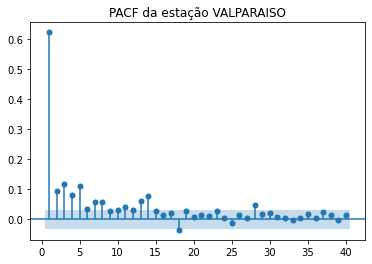

In [104]:
df_estacoes = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]
for df,nome in list(zip(df_estacoes,lista_estacoes.DC_NOME)):
    ts = df.resample('D').mean().RAD
    plot_pacf(ts,lags=40,zero=False,title=f"PACF da estação {nome}")

In [83]:
df_ = [df_A705,df_A714,df_A753,df_A733,df_A707,df_A701,df_A734]
for df,nome in list(zip(df_,lista_estacoes.DC_NOME)):
    
    ts = df.resample('D').mean().RAD
    #Variação Mensal
    print(f'Variação diária para a estação em {nome}')
    var_men = (ts.pct_change().fillna(0)).round(2)
    display(var_men)

Variação diária para a estação em BAURU


DT_MEDICAO
2011-01-01      0.00
2011-01-02     -0.25
2011-01-03     -0.30
2011-01-04      0.88
2011-01-05      0.04
2011-01-06      0.20
2011-01-07     -0.26
2011-01-08     -0.09
2011-01-09      0.21
2011-01-10     -0.10
2011-01-11      0.04
2011-01-12     -0.39
2011-01-13      0.05
2011-01-14      0.66
2011-01-15      0.31
2011-01-16     -0.19
2011-01-17     -0.43
2011-01-18      0.49
2011-01-19     -0.18
2011-01-20     -0.03
2011-01-21      0.61
2011-01-22     -0.17
2011-01-23      0.09
2011-01-24      0.00
2011-01-25      0.10
2011-01-26     -0.09
2011-01-27      0.08
2011-01-28     -0.16
2011-01-29      0.33
2011-01-30     -0.02
2011-01-31     -0.19
2011-02-01     -0.24
2011-02-02     -0.06
2011-02-03      0.26
2011-02-04     -0.13
2011-02-05      0.27
2011-02-06     -0.01
2011-02-07     -0.36
2011-02-08      0.84
2011-02-09     -0.23
2011-02-10      0.23
2011-02-11     -0.24
2011-02-12      0.19
2011-02-13      0.03
2011-02-14     -0.05
2011-02-15     -0.54
2011-02-16      1.03
20

Variação diária para a estação em ITAPEVA


DT_MEDICAO
2011-01-01     0.00
2011-01-02    -0.29
2011-01-03     0.33
2011-01-04    -0.05
2011-01-05    -0.07
2011-01-06     0.24
2011-01-07     0.04
2011-01-08    -0.09
2011-01-09    -0.06
2011-01-10    -0.08
2011-01-11     0.01
2011-01-12    -0.65
2011-01-13     2.25
2011-01-14     0.14
2011-01-15     0.24
2011-01-16    -0.01
2011-01-17    -0.38
2011-01-18    -0.11
2011-01-19    -0.30
2011-01-20     0.16
2011-01-21     0.79
2011-01-22    -0.16
2011-01-23    -0.02
2011-01-24     0.31
2011-01-25    -0.10
2011-01-26     0.13
2011-01-27     0.12
2011-01-28    -0.10
2011-01-29     0.13
2011-01-30    -0.18
2011-01-31    -0.19
2011-02-01    -0.08
2011-02-02    -0.13
2011-02-03    -0.12
2011-02-04     0.53
2011-02-05     0.03
2011-02-06    -0.22
2011-02-07    -0.12
2011-02-08     0.29
2011-02-09     0.02
2011-02-10     0.08
2011-02-11     0.03
2011-02-12    -0.28
2011-02-13     0.32
2011-02-14     0.22
2011-02-15    -0.61
2011-02-16     1.36
2011-02-17    -0.11
2011-02-18     0.16
2011-02-1

Variação diária para a estação em ITUVERAVA


DT_MEDICAO
2011-01-01      0.00
2011-01-02     -0.69
2011-01-03      0.83
2011-01-04      0.18
2011-01-05      0.36
2011-01-06     -0.40
2011-01-07      0.78
2011-01-08     -0.48
2011-01-09      0.62
2011-01-10     -0.17
2011-01-11     -0.18
2011-01-12      0.11
2011-01-13     -0.23
2011-01-14      0.21
2011-01-15      0.81
2011-01-16     -0.49
2011-01-17      0.80
2011-01-18     -0.12
2011-01-19      0.10
2011-01-20     -0.36
2011-01-21      0.63
2011-01-22      0.05
2011-01-23      0.04
2011-01-24      0.02
2011-01-25     -0.00
2011-01-26      0.06
2011-01-27      0.08
2011-01-28     -0.16
2011-01-29      0.04
2011-01-30     -0.01
2011-01-31     -0.29
2011-02-01      0.04
2011-02-02      0.15
2011-02-03      0.12
2011-02-04     -0.01
2011-02-05      0.19
2011-02-06     -0.01
2011-02-07     -0.11
2011-02-08      0.10
2011-02-09      0.03
2011-02-10     -0.21
2011-02-11     -0.24
2011-02-12      0.12
2011-02-13     -0.04
2011-02-14     -0.01
2011-02-15      0.17
2011-02-16     -0.11
20

Variação diária para a estação em JALES


DT_MEDICAO
2011-01-01    0.00
2011-01-02   -0.04
2011-01-03    0.18
2011-01-04   -0.27
2011-01-05    0.29
2011-01-06    0.21
2011-01-07   -0.22
2011-01-08   -0.37
2011-01-09    0.51
2011-01-10    0.07
2011-01-11   -0.54
2011-01-12    1.03
2011-01-13   -0.41
2011-01-14    0.89
2011-01-15    0.25
2011-01-16   -0.25
2011-01-17    0.03
2011-01-18    0.08
2011-01-19    0.05
2011-01-20   -0.24
2011-01-21    0.52
2011-01-22   -0.03
2011-01-23    0.00
2011-01-24    0.08
2011-01-25   -0.14
2011-01-26    0.02
2011-01-27   -0.04
2011-01-28   -0.08
2011-01-29   -0.17
2011-01-30    0.41
2011-01-31    0.02
2011-02-01   -0.44
2011-02-02    0.35
2011-02-03    0.07
2011-02-04    0.12
2011-02-05   -0.15
2011-02-06    0.37
2011-02-07   -0.35
2011-02-08    0.03
2011-02-09   -0.28
2011-02-10   -0.14
2011-02-11    1.11
2011-02-12    0.08
2011-02-13   -0.30
2011-02-14   -0.03
2011-02-15   -0.02
2011-02-16    0.36
2011-02-17    0.08
2011-02-18   -0.26
2011-02-19   -0.15
2011-02-20    0.30
2011-02-21   -0.18
2

Variação diária para a estação em PRESIDENTE PRUDENTE


DT_MEDICAO
2011-01-01     0.00
2011-01-02    -0.36
2011-01-03     0.50
2011-01-04    -0.24
2011-01-05     0.32
2011-01-06    -0.16
2011-01-07    -0.09
2011-01-08    -0.04
2011-01-09     0.04
2011-01-10    -0.00
2011-01-11    -0.17
2011-01-12    -0.07
2011-01-13     0.09
2011-01-14     0.69
2011-01-15    -0.07
2011-01-16     0.04
2011-01-17    -0.64
2011-01-18     0.53
2011-01-19     0.03
2011-01-20     0.40
2011-01-21    -0.29
2011-01-22     0.76
2011-01-23    -0.13
2011-01-24    -0.03
2011-01-25     0.17
2011-01-26     0.04
2011-01-27    -0.11
2011-01-28    -0.01
2011-01-29    -0.10
2011-01-30     0.25
2011-01-31    -0.46
2011-02-01     0.44
2011-02-02     0.22
2011-02-03    -0.40
2011-02-04     0.41
2011-02-05     0.12
2011-02-06    -0.08
2011-02-07    -0.13
2011-02-08    -0.00
2011-02-09    -0.50
2011-02-10     0.70
2011-02-11     0.33
2011-02-12    -0.09
2011-02-13    -0.11
2011-02-14    -0.26
2011-02-15     0.11
2011-02-16     0.28
2011-02-17     0.18
2011-02-18    -0.03
2011-02-1

Variação diária para a estação em SAO PAULO - MIRANTE


DT_MEDICAO
2011-01-01     0.00
2011-01-02    -0.62
2011-01-03     0.61
2011-01-04     0.57
2011-01-05     0.95
2011-01-06    -0.19
2011-01-07    -0.35
2011-01-08     0.27
2011-01-09     0.89
2011-01-10    -0.27
2011-01-11    -0.10
2011-01-12     0.25
2011-01-13    -0.48
2011-01-14     0.17
2011-01-15     0.60
2011-01-16     0.10
2011-01-17    -0.46
2011-01-18     0.79
2011-01-19    -0.03
2011-01-20    -0.40
2011-01-21     0.30
2011-01-22     0.16
2011-01-23     0.18
2011-01-24     0.12
2011-01-25    -0.14
2011-01-26     0.11
2011-01-27     0.17
2011-01-28    -0.07
2011-01-29    -0.24
2011-01-30     0.15
2011-01-31    -0.35
2011-02-01     0.10
2011-02-02    -0.21
2011-02-03    -0.39
2011-02-04     0.56
2011-02-05     1.43
2011-02-06    -0.09
2011-02-07    -0.36
2011-02-08     0.36
2011-02-09     0.15
2011-02-10    -0.16
2011-02-11    -0.21
2011-02-12     0.20
2011-02-13     0.08
2011-02-14    -0.36
2011-02-15    -0.48
2011-02-16     0.94
2011-02-17     0.36
2011-02-18    -0.02
2011-02-1

Variação diária para a estação em VALPARAISO


DT_MEDICAO
2011-01-01     0.00
2011-01-02    -0.24
2011-01-03     0.15
2011-01-04    -0.15
2011-01-05     0.11
2011-01-06     0.15
2011-01-07    -0.10
2011-01-08    -0.33
2011-01-09     0.18
2011-01-10     0.20
2011-01-11    -0.12
2011-01-12     0.00
2011-01-13    -0.11
2011-01-14     0.27
2011-01-15     0.38
2011-01-16    -0.23
2011-01-17    -0.06
2011-01-18    -0.06
2011-01-19    -0.27
2011-01-20     0.62
2011-01-21     0.00
2011-01-22     0.00
2011-01-23     0.05
2011-01-24    -0.02
2011-01-25     0.07
2011-01-26    -0.06
2011-01-27    -0.01
2011-01-28     0.09
2011-01-29     0.02
2011-01-30     0.08
2011-01-31    -0.06
2011-02-01    -0.24
2011-02-02     0.21
2011-02-03    -0.26
2011-02-04    -0.02
2011-02-05     0.48
2011-02-06    -0.13
2011-02-07    -0.08
2011-02-08    -0.07
2011-02-09    -0.45
2011-02-10     0.66
2011-02-11     0.36
2011-02-12    -0.16
2011-02-13    -0.09
2011-02-14     0.04
2011-02-15    -0.32
2011-02-16     0.53
2011-02-17     0.07
2011-02-18    -0.11
2011-02-1

## Separando os dados de treino e teste:

In [301]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split

In [302]:
ts = df_dia_A705
target = 'RAD'

In [303]:
ts['day'] = ts.index.day
ts['dayofyear'] = ts.index.dayofyear
ts['weekday'] = ts.index.weekday
ts['weekofyear'] = ts.index.weekofyear

ts['month'] = ts.index.month
ts['is_month_start'] = ts.index.is_month_start
ts['is_month_end'] = ts.index.is_month_end

ts['year'] = ts.index.year
ts['is_year_start'] = ts.index.is_year_start
ts['ano_fim'] = ts.index.is_year_end

ts['quarter'] = ts.index.quarter
ts['quarter_comeco'] = ts.index.is_quarter_start
ts['quarter_fim'] = ts.index.is_quarter_end

ts['ts_lag1'] = ts[target].shift()

ts = ts.dropna()

In [304]:
df_forcasting = ts

X = df_forcasting.drop(target,axis=1)
y = df_forcasting[target]

In [305]:
X.shape, y.shape

((4084, 40), (4084,))

In [306]:
low_var(X)

PRE_INS: 0.02504  OK!
TEM_SEN: 0.02347  OK!
VL_LATITUDE baixa variância: 0.00000
PRE_MAX: 0.02477  OK!
RAD_GLO: 0.02393  OK!
PTO_INS: 0.02287  OK!
TEM_MIN: 0.01909  OK!
VL_LONGITUDE baixa variância: 0.00000
UMD_MIN: 0.03288  OK!
PTO_MAX: 0.02270  OK!
VEN_DIR: 0.05383  OK!
CHUVA: 0.00325  OK!
PRE_MIN: 0.02505  OK!
UMD_MAX: 0.03617  OK!
VEN_VEL: 0.02672  OK!
PTO_MIN: 0.02301  OK!
TEM_MAX: 0.02078  OK!
VEN_RAJ: 0.01560  OK!
TEM_INS: 0.02059  OK!
UMD_INS: 0.03501  OK!
HR_MEDICAO baixa variância: 0.00000
MES: 0.09987  OK!
ANO: 0.08606  OK!
HR baixa variância: 0.00000
day: 0.08607  OK!
dayofyear: 0.08479  OK!
weekday: 0.11118  OK!
weekofyear: 0.08532  OK!
month: 0.09987  OK!
is_month_start: 0.03173  OK!
is_month_end: 0.03173  OK!
year: 0.08606  OK!
is_year_start: 0.00269  OK!
ano_fim: 0.00269  OK!
quarter: 0.14044  OK!
quarter_comeco: 0.01066  OK!
quarter_fim: 0.01066  OK!
ts_lag1: 0.02393  OK!
A(s) coluna(s) com baixa variância:  ['VL_LATITUDE', 'VL_LONGITUDE', 'HR_MEDICAO', 'HR']


['VL_LATITUDE', 'VL_LONGITUDE', 'HR_MEDICAO', 'HR']

In [307]:
is_constant(X)

PRE_INS OK!
TEM_SEN OK!
VL_LATITUDE is constant.
PRE_MAX OK!
RAD_GLO OK!
PTO_INS OK!
TEM_MIN OK!
VL_LONGITUDE is constant.
UMD_MIN OK!
PTO_MAX OK!
VEN_DIR OK!
CHUVA OK!
PRE_MIN OK!
UMD_MAX OK!
VEN_VEL OK!
PTO_MIN OK!
TEM_MAX OK!
VEN_RAJ OK!
TEM_INS OK!
UMD_INS OK!
HR_MEDICAO is constant.
MES OK!
ANO OK!
HR is constant.
cidade is constant.
estacao is constant.
day OK!
dayofyear OK!
weekday OK!
weekofyear OK!
month OK!
is_month_start OK!
is_month_end OK!
year OK!
is_year_start OK!
ano_fim OK!
quarter OK!
quarter_comeco OK!
quarter_fim OK!
ts_lag1 OK!
-=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=-
The % of cte column is: 15.000% 
The % of not cte columns is: 85.000%


In [308]:
X_copy = X.copy()
X = X.drop(['VL_LATITUDE','VL_LONGITUDE','HR_MEDICAO','HR','cidade','estacao'],axis=1)

In [309]:
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.30,random_state=42)

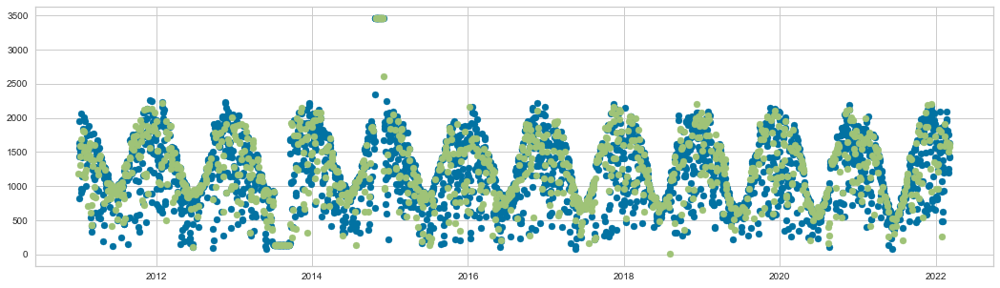

In [310]:
plt.figure(figsize=(18, 5))
plt.scatter(y_train.index, y_train)
plt.scatter(y_test.index, y_test);

In [311]:
(dtr_regr.predict(X_test)-y_test).mean()

-13.750708962203461

In [312]:
(dtr_regr.predict(X_test)-y_test).std()

113.04908032781837

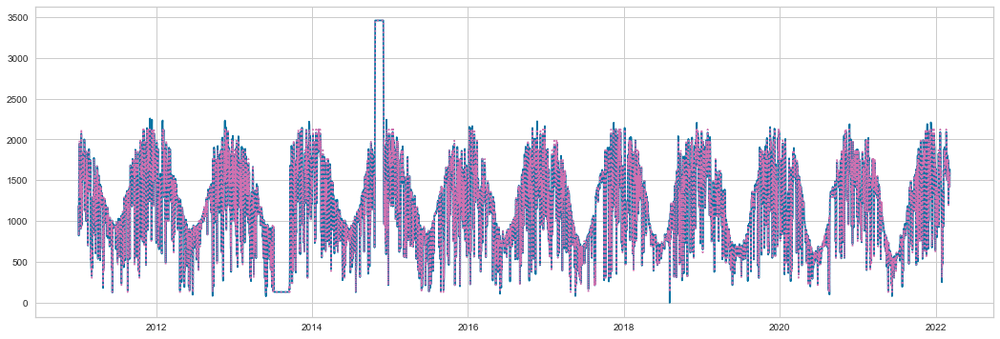

In [313]:
# Fit regression model
dtr_regr = DecisionTreeRegressor(max_depth=5)
dtr_regr.fit(X_train, y_train)

y_hat = dtr_regr.predict(X)
results = pd.DataFrame({'y_train': y, 'y_hat': y_hat})
results.sort_index(inplace=True)

plt.figure(figsize=(18, 6))
plt.plot(results.index, results.y_train, );
plt.plot(results.index, results.y_hat, c='#cf71af', linestyle=':');

In [314]:
pred = dtr_regr.predict(X_test)

In [315]:
mean_squared_error(y_test, pred)

1074.390850902953

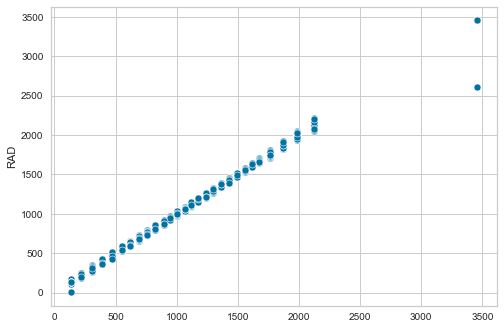

In [316]:
sns.scatterplot(x=pred, y = y_test);

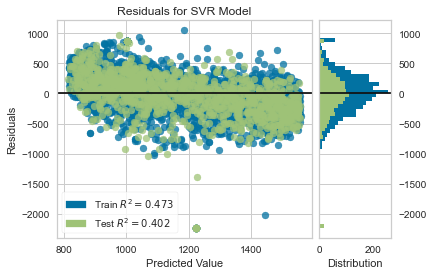

<AxesSubplot:title={'center':'Residuals for SVR Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [317]:
fig,ax = plt.subplots(figsize=(6,4))
rpv = ResidualsPlot(pipe)
rpv.fit(X_train,y_train)
rpv.score(X_test,y_test)
rpv.poof()

----

## The AR(1) Model

In [339]:
from statsmodels.tsa.arima_model import ARMA
model_ar = ARMA(df_dia_A705.RAD, order=(1,0))

In [340]:
results_ar = model_ar.fit()

In [341]:
results_ar.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              ARMA Model Results                              
==============================================================================
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(1, 0)   Log Likelihood              -29672.562
Method:                       css-mle   S.D. of innovations            345.413
Date:                Wed, 16 Mar 2022   AIC                          59351.125
Time:                        16:31:55   BIC                          59370.070
Sample:                    01-01-2011   HQIC                         59357.833
                         - 03-08-2022                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1196.6682     22.712     52.688      0.000    1152.153    1241.183
ar.L1.RAD      0.7622      0.010     75.297      0.000       0.742       0.782
                                    Roots                                    
=============================================================================
                  Real          Imaginary           Modulus         Frequency
-----------------------------------------------------------------------------
AR.1            1.3119           +0.0000j            1.3119            0.0000
-----------------------------------------------------------------------------
"""

## Higher-Lag AR Models

In [342]:
def LLR_test(mod_1,mod_2,DF=1):
    L1 = mod_1.fit().llf
    L2 = mod_2.fit().llf
    LR = (2*(L2-L1))
    p = chi2.sf(LR,DF).round(3)
    return p

In [343]:
model_ar2 = ARMA(df_dia_A705.RAD, order=[2,0])

results_ar2 = model_ar2.fit()
print(results_ar2.summary())
print("LLR test:" + str(LLR_test(model_ar,model_ar2)))

                              ARMA Model Results                              
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(2, 0)   Log Likelihood              -29648.242
Method:                       css-mle   S.D. of innovations            343.361
Date:                Wed, 16 Mar 2022   AIC                          59304.483
Time:                        16:32:10   BIC                          59329.744
Sample:                    01-01-2011   HQIC                         59313.428
                         - 03-08-2022                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1196.9074     25.323     47.265      0.000    1147.275    1246.540
ar.L1.RAD      0.6793      0.016     43.674      0.000       0.649       0.710
ar.L2.RAD      0.1088      0.016      6.995      0.0

### Comparing Higher-Lag AR Models

In [344]:
model_ar3 = ARMA(df_dia_A705.RAD, order=[3,0])

results_ar3 = model_ar3.fit()
print(results_ar3.summary())
print("LLR test:" + str(LLR_test(model_ar2,model_ar3)))

                              ARMA Model Results                              
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(3, 0)   Log Likelihood              -29596.917
Method:                       css-mle   S.D. of innovations            339.071
Date:                Wed, 16 Mar 2022   AIC                          59203.834
Time:                        16:32:16   BIC                          59235.409
Sample:                    01-01-2011   HQIC                         59215.014
                         - 03-08-2022                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1197.1339     29.658     40.364      0.000    1139.005    1255.263
ar.L1.RAD      0.6621      0.015     42.849      0.000       0.632       0.692
ar.L2.RAD      0.0018      0.019      0.095      0.9

In [345]:
df_teste = df_dia_A705
df_teste['res'] = results_ar3.resid
print(df_teste.res.mean())
print(df_teste.res.std())

-0.08507161065690587
339.1467902440348


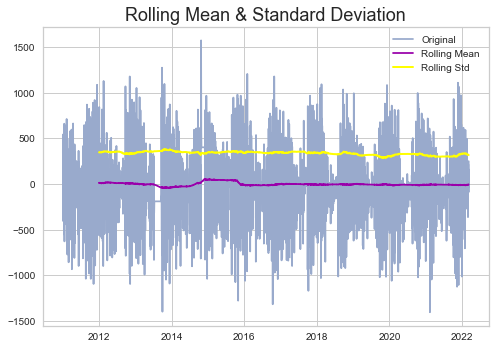

Results od Dickey0Fuller Test:
Test Statistic                   -5.588466
p-value                           0.000001
#Lags Used                       31.000000
Number of Observations Used    4053.000000
Critical Value(1%)               -3.431964
Critical Value(5%)               -2.862253
Critical Value(10%)              -2.567150
dtype: float64
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary


In [346]:
test_stationarity(df_teste.res,365)

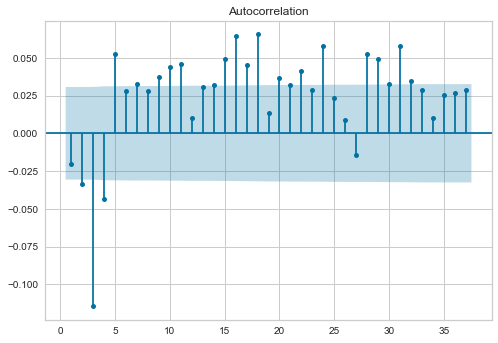

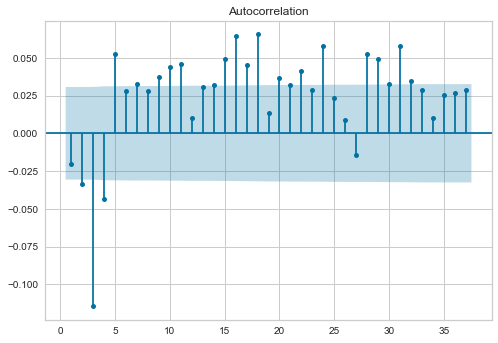

In [347]:
plot_acf(df_teste.res,zero=False)

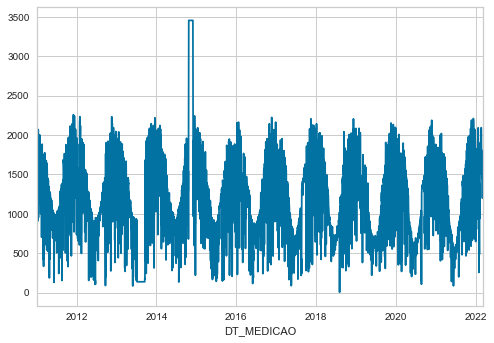

In [348]:
df_dia_A705.RAD.plot();

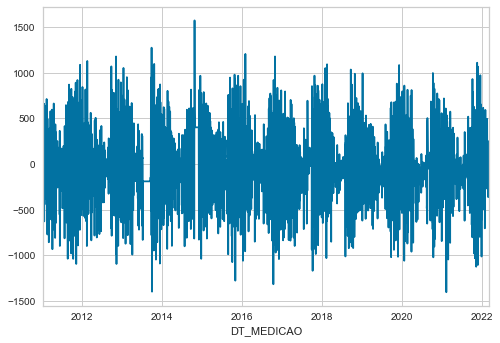

In [349]:
df_teste.res[1:].plot();

In [329]:

print("LLR test:" + str(LLR_test(model_ar,model_ar3,DF=2)))

LLR test:0.0


In [330]:
model_ar4 = ARMA(df_dia_A701.RAD, order=[4,0])

results_ar4 = model_ar4.fit()
print(results_ar4.summary())
print("LLR test:" + str(LLR_test(model_ar3,model_ar4)))

                              ARMA Model Results                              
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(4, 0)   Log Likelihood              -30803.435
Method:                       css-mle   S.D. of innovations            455.607
Date:                Wed, 16 Mar 2022   AIC                          61618.871
Time:                        15:16:32   BIC                          61656.761
Sample:                    01-01-2011   HQIC                         61632.288
                         - 03-08-2022                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1332.4962     18.676     71.347      0.000    1295.891    1369.101
ar.L1.RAD      0.5614      0.016     35.989      0.000       0.531       0.592
ar.L2.RAD     -0.0478      0.018     -2.668      0.0

In [331]:
model_ar5 = ARMA(df_dia_A701.RAD, order=[5,0])

results_ar5 = model_ar5.fit()
print(results_ar5.summary())
print("LLR test:" + str(LLR_test(model_ar4,model_ar5)))

                              ARMA Model Results                              
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(5, 0)   Log Likelihood              -30798.751
Method:                       css-mle   S.D. of innovations            455.085
Date:                Wed, 16 Mar 2022   AIC                          61611.502
Time:                        15:16:44   BIC                          61655.708
Sample:                    01-01-2011   HQIC                         61627.155
                         - 03-08-2022                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1332.3987     19.591     68.011      0.000    1294.001    1370.796
ar.L1.RAD      0.5578      0.016     35.693      0.000       0.527       0.588
ar.L2.RAD     -0.0492      0.018     -2.749      0.0

In [332]:
model_ar6 = ARMA(df_dia_A701.RAD, order=[6,0])

results_ar6 = model_ar6.fit()
print(results_ar6.summary())
print("LLR test:" + str(LLR_test(model_ar5,model_ar6)))

                              ARMA Model Results                              
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(6, 0)   Log Likelihood              -30793.610
Method:                       css-mle   S.D. of innovations            454.511
Date:                Wed, 16 Mar 2022   AIC                          61603.221
Time:                        15:16:52   BIC                          61653.742
Sample:                    01-01-2011   HQIC                         61621.110
                         - 03-08-2022                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1332.4774     20.599     64.686      0.000    1292.104    1372.851
ar.L1.RAD      0.5554      0.016     35.545      0.000       0.525       0.586
ar.L2.RAD     -0.0516      0.018     -2.887      0.0

In [333]:
model_ar7 = ARMA(df_dia_A701.RAD, order=[7,0])

results_ar7 = model_ar7.fit()
print(results_ar7.summary())
print("LLR test:" + str(LLR_test(model_ar6,model_ar7)))

                              ARMA Model Results                              
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(7, 0)   Log Likelihood              -30788.943
Method:                       css-mle   S.D. of innovations            453.991
Date:                Wed, 16 Mar 2022   AIC                          61595.886
Time:                        15:17:01   BIC                          61652.721
Sample:                    01-01-2011   HQIC                         61616.011
                         - 03-08-2022                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1332.5967     21.609     61.668      0.000    1290.243    1374.950
ar.L1.RAD      0.5530      0.016     35.388      0.000       0.522       0.584
ar.L2.RAD     -0.0525      0.018     -2.942      0.0

In [334]:
model_ar8 = ARMA(df_dia_A701.RAD, order=[8,0])

results_ar8 = model_ar8.fit()
print(results_ar8.summary())
print("LLR test:" + str(LLR_test(model_ar7,model_ar8)))

                              ARMA Model Results                              
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(8, 0)   Log Likelihood              -30780.595
Method:                       css-mle   S.D. of innovations            453.063
Date:                Wed, 16 Mar 2022   AIC                          61581.190
Time:                        15:17:04   BIC                          61644.341
Sample:                    01-01-2011   HQIC                         61603.551
                         - 03-08-2022                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1332.4813     23.036     57.842      0.000    1287.331    1377.632
ar.L1.RAD      0.5499      0.016     35.223      0.000       0.519       0.581
ar.L2.RAD     -0.0540      0.018     -3.032      0.0

## Creating returns

In [351]:
df_dia_A705['retuns'] = df_dia_A705.RAD.pct_change(1)*100

## ACF for returns

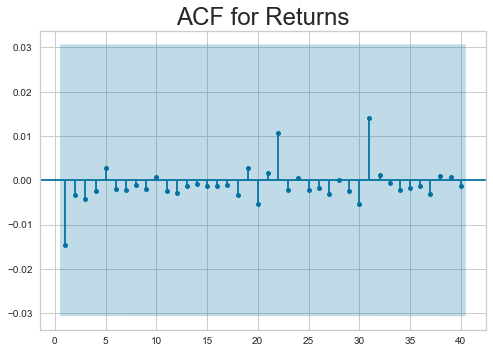

In [357]:
plot_acf(df_dia_A705['retuns'][1:],zero=False, lags=40)
plt.title('ACF for Returns', size=24);

## MA(1) for returns

In [360]:
model_ret_ma1 = ARMA(df_dia_A705['retuns'][1:],order=(0,1))
results_ret_ma1 = model_ret_ma1.fit()
results_ret_ma1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              ARMA Model Results                              
==============================================================================
Dep. Variable:                 retuns   No. Observations:                 4084
Model:                     ARMA(0, 1)   Log Likelihood              -28247.412
Method:                       css-mle   S.D. of innovations            244.121
Date:                Wed, 16 Mar 2022   AIC                          56500.824
Time:                        16:39:44   BIC                          56519.768
Sample:                    01-02-2011   HQIC                         56507.532
                         - 03-08-2022                                         
================================================================================
                   coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------
const           13.6005      3.764      3.613      0.000       6.223      20.978
ma.L1.retuns    -0.0146      0.016     -0.930      0.352      -0.045       0.016
                                    Roots                                    
=============================================================================
                  Real          Imaginary           Modulus         Frequency
-----------------------------------------------------------------------------
MA.1           68.4635           +0.0000j           68.4635            0.0000
-----------------------------------------------------------------------------
"""

## Higher-Lag MA Models for Returns

In [362]:
model_ret_ma2 = ARMA(df_dia_A705['retuns'][1:], order=(0,2))
results_ret_ma2 = model_ret_ma2.fit()
print(results_ret_ma2.summary())

print('\n LLR test p-value = '+str(LLR_test(model_ret_ma1, model_ret_ma2)))

                              ARMA Model Results                              
Dep. Variable:                 retuns   No. Observations:                 4084
Model:                     ARMA(0, 2)   Log Likelihood              -28247.387
Method:                       css-mle   S.D. of innovations            244.120
Date:                Wed, 16 Mar 2022   AIC                          56502.774
Time:                        16:44:49   BIC                          56528.034
Sample:                    01-02-2011   HQIC                         56511.719
                         - 03-08-2022                                         
                   coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------
const           13.6005      3.751      3.626      0.000       6.249      20.952
ma.L1.retuns    -0.0146      0.016     -0.932      0.351      -0.045       0.016
ma.L2.retuns    -0.0035      0.016     -0.22

## MA Models for RAD

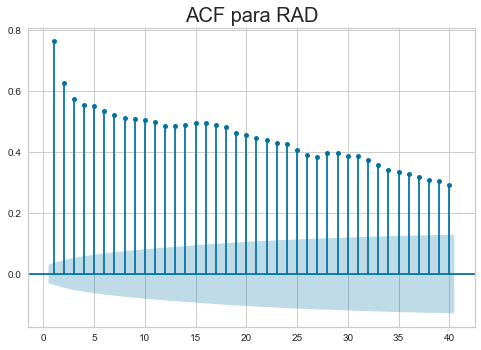

In [364]:
plot_acf(df_dia_A705.RAD,zero=False,lags=40)
plt.title('ACF para RAD',size=20);

In [363]:
model_ret_ma1 = ARMA(df_dia_A705.RAD,order=(0,1))
results_ret_ma1 = model_ret_ma1.fit()
results_ret_ma1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              ARMA Model Results                              
==============================================================================
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(0, 1)   Log Likelihood              -30371.142
Method:                       css-mle   S.D. of innovations            409.854
Date:                Wed, 16 Mar 2022   AIC                          60748.284
Time:                        17:26:55   BIC                          60767.229
Sample:                    01-01-2011   HQIC                         60754.992
                         - 03-08-2022                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1196.2598     10.318    115.936      0.000    1176.036    1216.483
ma.L1.RAD      0.6092      0.010     60.760      0.000       0.590       0.629
                                    Roots                                    
=============================================================================
                  Real          Imaginary           Modulus         Frequency
-----------------------------------------------------------------------------
MA.1           -1.6415           +0.0000j            1.6415            0.5000
-----------------------------------------------------------------------------
"""

In [365]:
model_ret_ma2 = ARMA(df_dia_A705.RAD,order=(0,2))
results_ret_ma2 = model_ret_ma2.fit()
results_ret_ma2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              ARMA Model Results                              
==============================================================================
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(0, 2)   Log Likelihood              -30050.752
Method:                       css-mle   S.D. of innovations            378.932
Date:                Wed, 16 Mar 2022   AIC                          60109.504
Time:                        17:28:36   BIC                          60134.764
Sample:                    01-01-2011   HQIC                         60118.448
                         - 03-08-2022                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1196.3523     12.187     98.163      0.000    1172.465    1220.239
ma.L1.RAD      0.7053      0.015     47.935      0.000       0.676       0.734
ma.L2.RAD      0.3507      0.013     26.813      0.000       0.325       0.376
                                    Roots                                    
=============================================================================
                  Real          Imaginary           Modulus         Frequency
-----------------------------------------------------------------------------
MA.1           -1.0056           -1.3566j            1.6886           -0.3515
MA.2           -1.0056           +1.3566j            1.6886            0.3515
-----------------------------------------------------------------------------
"""

In [366]:
model_ret_ma3 = ARMA(df_dia_A705.RAD,order=(0,3))
results_ret_ma3 = model_ret_ma3.fit()
results_ret_ma3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              ARMA Model Results                              
==============================================================================
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(0, 3)   Log Likelihood              -29894.623
Method:                       css-mle   S.D. of innovations            364.718
Date:                Wed, 16 Mar 2022   AIC                          59799.245
Time:                        17:33:05   BIC                          59830.820
Sample:                    01-01-2011   HQIC                         59810.426
                         - 03-08-2022                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1196.4322     13.928     85.898      0.000    1169.133    1223.731
ma.L1.RAD      0.7317      0.016     47.021      0.000       0.701       0.762
ma.L2.RAD      0.4627      0.016     29.693      0.000       0.432       0.493
ma.L3.RAD      0.2471      0.014     18.140      0.000       0.220       0.274
                                    Roots                                    
=============================================================================
                  Real          Imaginary           Modulus         Frequency
-----------------------------------------------------------------------------
MA.1           -1.6013           -0.0000j            1.6013           -0.5000
MA.2           -0.1354           -1.5839j            1.5896           -0.2636
MA.3           -0.1354           +1.5839j            1.5896            0.2636
-----------------------------------------------------------------------------
"""

## ARMA(1,1)

In [367]:
model_ret_ar_ma1 = ARMA(df_dia_A705['retuns'][1:],order=(1,1))
results_ret_ar_ma1 = model_ret_ar_ma1.fit()
results_ret_ar_ma1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              ARMA Model Results                              
==============================================================================
Dep. Variable:                 retuns   No. Observations:                 4084
Model:                     ARMA(1, 1)   Log Likelihood              -28247.364
Method:                       css-mle   S.D. of innovations            244.119
Date:                Wed, 16 Mar 2022   AIC                          56502.728
Time:                        17:44:48   BIC                          56527.988
Sample:                    01-02-2011   HQIC                         56511.673
                         - 03-08-2022                                         
================================================================================
                   coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------
const           13.6014      3.732      3.644      0.000       6.286      20.916
ar.L1.retuns     0.3835      1.031      0.372      0.710      -1.638       2.405
ma.L1.retuns    -0.3977      1.024     -0.388      0.698      -2.406       1.610
                                    Roots                                    
=============================================================================
                  Real          Imaginary           Modulus         Frequency
-----------------------------------------------------------------------------
AR.1            2.6076           +0.0000j            2.6076            0.0000
MA.1            2.5147           +0.0000j            2.5147            0.0000
-----------------------------------------------------------------------------
"""

In [369]:
model_ret_ar_ma1 = ARMA(df_dia_A705.RAD,order=(1,1))
results_ret_ar_ma1 = model_ret_ar_ma1.fit()
results_ret_ar_ma1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              ARMA Model Results                              
==============================================================================
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(1, 1)   Log Likelihood              -29627.062
Method:                       css-mle   S.D. of innovations            341.584
Date:                Wed, 16 Mar 2022   AIC                          59262.123
Time:                        17:47:49   BIC                          59287.384
Sample:                    01-01-2011   HQIC                         59271.068
                         - 03-08-2022                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1197.0913     29.673     40.342      0.000    1138.933    1255.250
ar.L1.RAD      0.8706      0.012     70.377      0.000       0.846       0.895
ma.L1.RAD     -0.2802      0.030     -9.251      0.000      -0.340      -0.221
                                    Roots                                    
=============================================================================
                  Real          Imaginary           Modulus         Frequency
-----------------------------------------------------------------------------
AR.1            1.1487           +0.0000j            1.1487            0.0000
MA.1            3.5694           +0.0000j            3.5694            0.0000
-----------------------------------------------------------------------------
"""

In [ ]:
model_ret_ar_1 = ARMA()

### Forecasting

ConversionError: Failed to convert value(s) to axis units: array(['Bauru', 'Bauru', 'Bauru', ..., 'Bauru', 'Bauru', 'Bauru'],
      dtype=object)

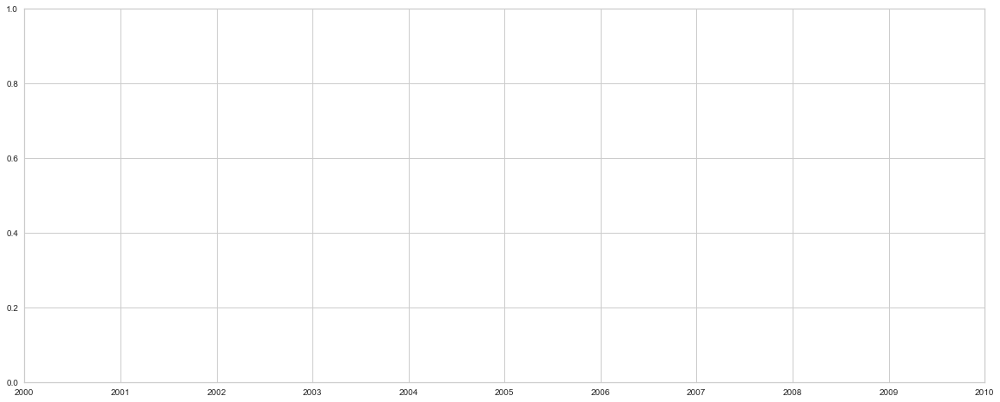

In [361]:
plt.figure(figsize=(20, 8))

plt.plot(ts, label='original ts')
#plt.plot(model_ma.predict(), label='model MA')
plt.plot(results_.predict(), label='model')
plt.legend();

In [463]:
print(results_.summary())

                              ARMA Model Results                              
Dep. Variable:                    RAD   No. Observations:                 4085
Model:                     ARMA(1, 1)   Log Likelihood              -29836.626
Method:                       css-mle   S.D. of innovations            359.583
Date:                Mon, 14 Mar 2022   AIC                          59681.253
Time:                        09:28:18   BIC                          59706.513
Sample:                    01-01-2011   HQIC                         59690.197
                         - 03-08-2022                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1451.0647     18.427     78.746      0.000    1414.948    1487.181
ar.L1.RAD      0.7752      0.019     39.977      0.000       0.737       0.813
ma.L1.RAD     -0.2630      0.033     -7.902      0.0

In [352]:
def plotar (x, y, dataset):
    ''' x e y var quantitativas'''
    sns.set_palette('Accent')
    sns.set_style('darkgrid')
    fig, ax = plt.subplots(1, 1, figsize=(12,6))
    fig.suptitle(f'Relação {x} X {y}', fontsize=18, fontweight='bold', y=1)
    ax = sns.scatterplot(x=x, y=y,hue='cidade', data=dataset)
    ax.set_xlabel(f'{x}', fontsize=14)
    ax.set_ylabel(f'{y}', fontsize=14)
    ax = ax


UMD_MIN CHUVA
UMD_MIN TEM_MAX
UMD_MIN RAD
CHUVA UMD_MIN
CHUVA TEM_MAX
CHUVA RAD
TEM_MAX UMD_MIN
TEM_MAX CHUVA
TEM_MAX RAD
RAD UMD_MIN
RAD CHUVA
RAD TEM_MAX


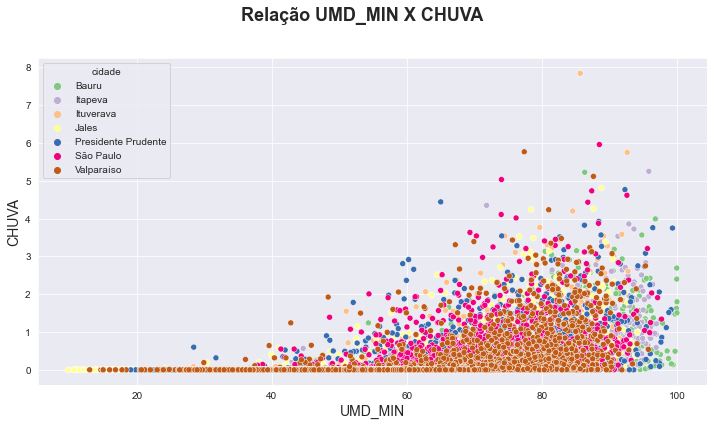

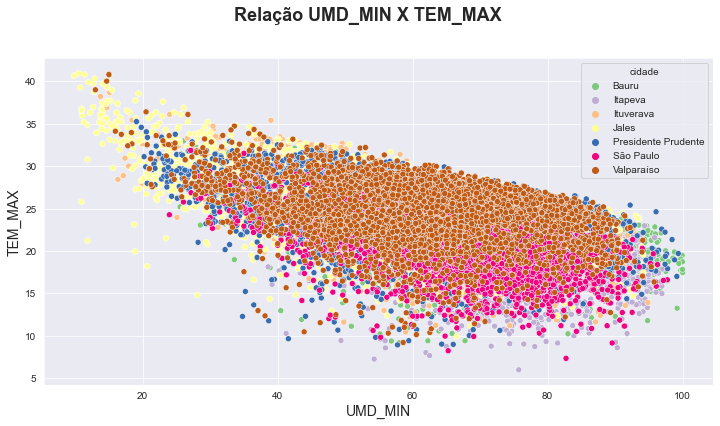

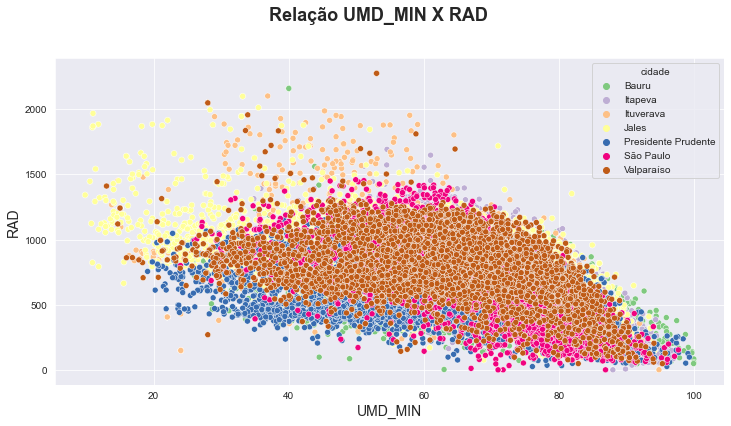

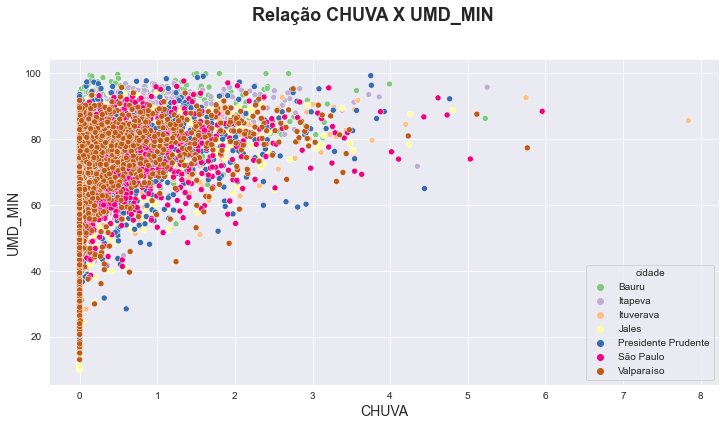

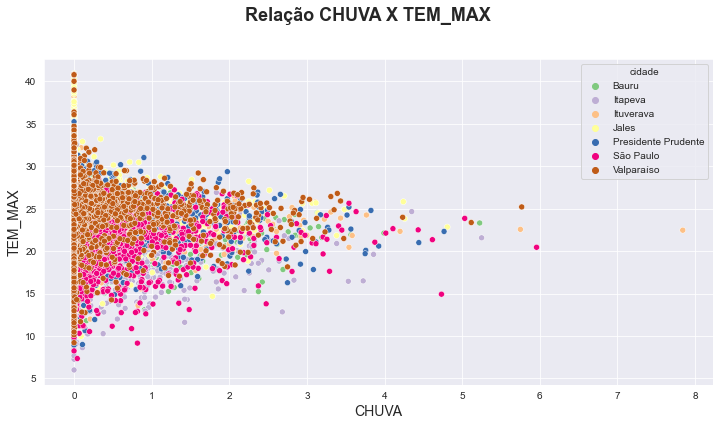

...

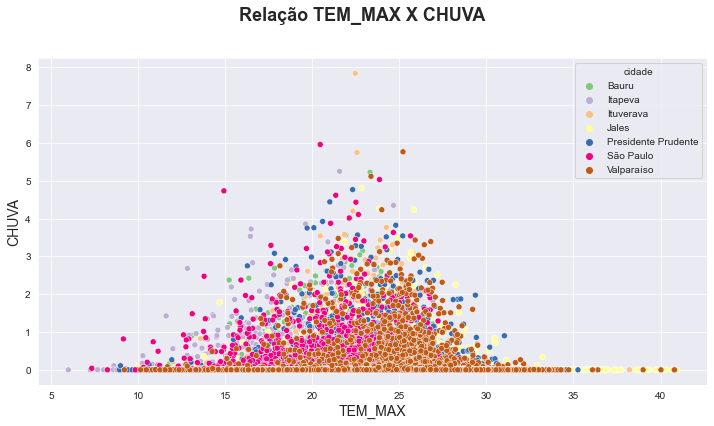

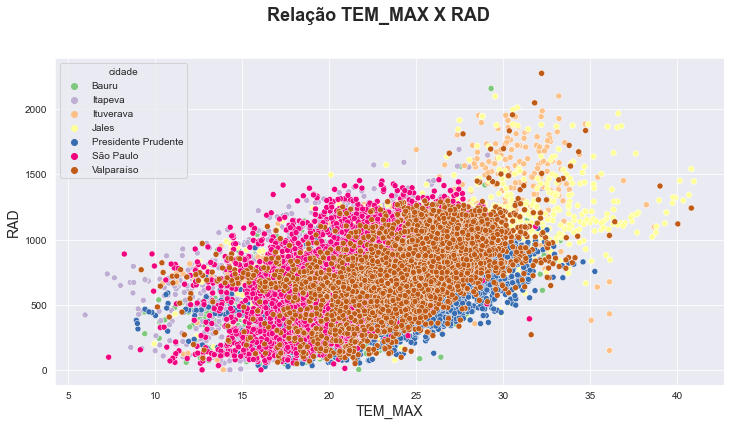

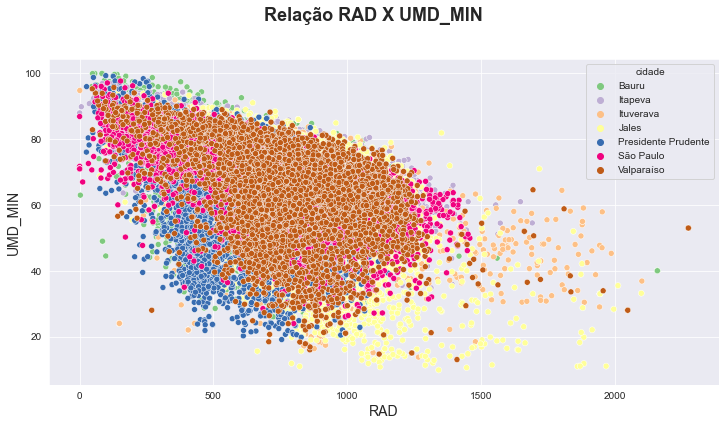

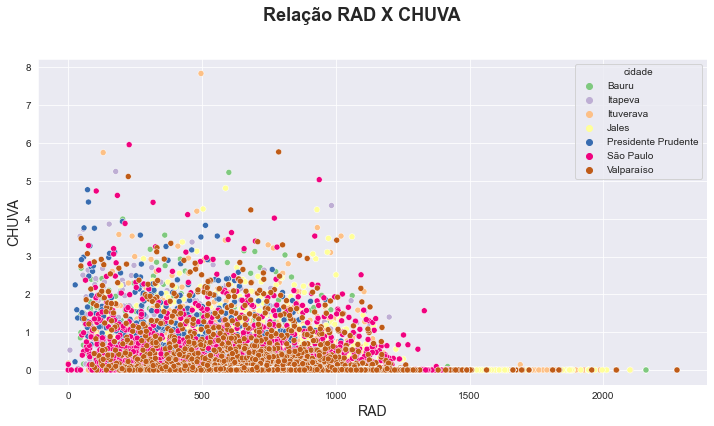

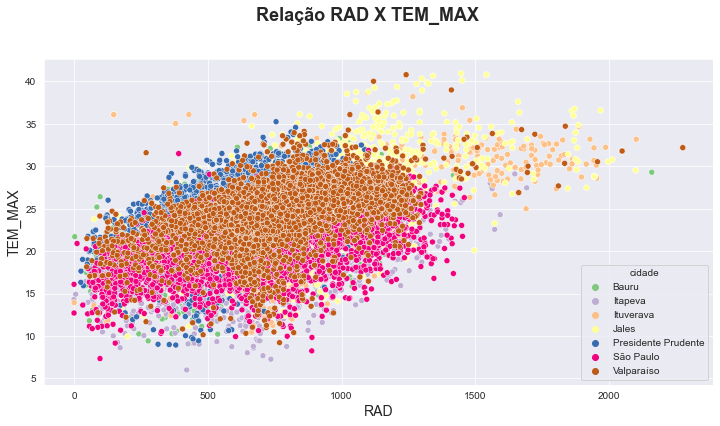

In [354]:
df=df_dia_estacoes  #[condicao_irradiacao] - já filtrado acima

for col in df[['UMD_MIN','CHUVA','TEM_MAX','RAD']]:
    for col2 in df[['UMD_MIN','CHUVA','TEM_MAX','RAD']]:
        if col==col2:
            pass
        else:
            print(col,col2)
            plotar(col,col2,df)

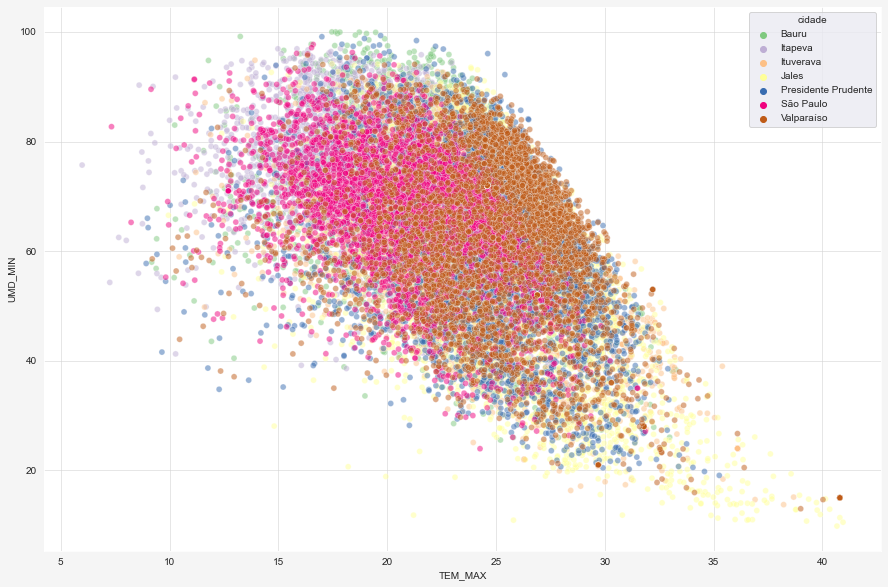

In [355]:
fig = plt.figure(figsize=(15, 10))
fig.set_facecolor('#f5f5f5')
ax = fig.add_subplot()
ax.set_facecolor("#fff")
ax.grid(color="lightgrey", alpha=0.7, axis="both", zorder=0)
sns.scatterplot(x=df['TEM_MAX'], y=df['UMD_MIN'],ax=ax, hue=df['cidade'], alpha=0.5,zorder=2);

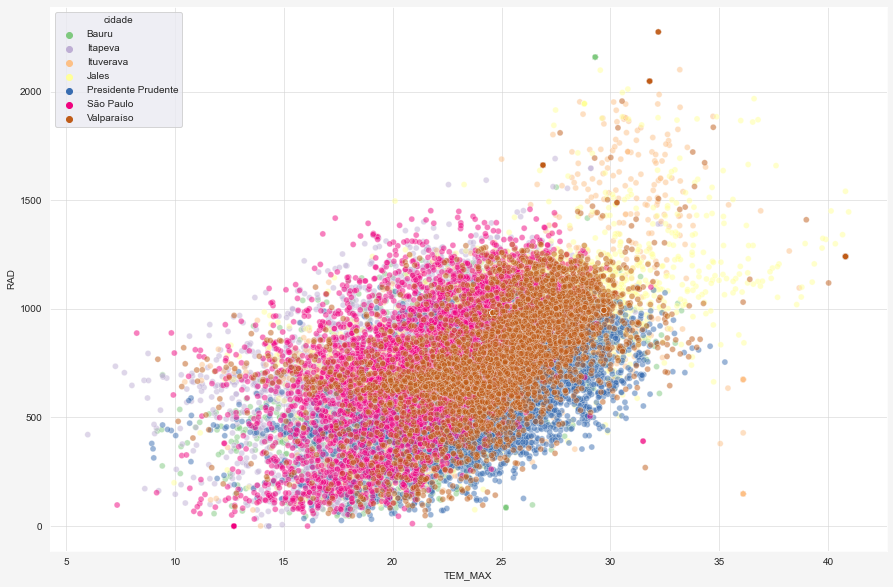

In [359]:
fig = plt.figure(figsize=(15, 10))
fig.set_facecolor('#f5f5f5')
ax = fig.add_subplot()
ax.set_facecolor("#fff")
ax.grid(color="lightgrey", alpha=0.7, axis="both", zorder=0)
sns.scatterplot(x=df['TEM_MAX'], y=df['RAD'],ax=ax, hue=df['cidade'], alpha=0.5,zorder=2);

In [26]:
import plotly.express as px
fig = px.scatter_3d(df_dia_estacoes, x='UMD_MIN', y='TEM_MAX', z='RAD',
              color='cidade')
fig.show()

In [122]:
# target = 'RAD'
# X = df_dia_estacoes.drop(target,axis=1)
# y = df_dia_estacoes[target]

# Machine Learning 

Regressão.


Fazendo primeiro para a estação A705 - Bauru

In [272]:
df = df_A705.resample('D').mean().dropna()
df_copy = df.copy()

In [273]:
df['day'] = df.index.day
df['dayofyear'] = df.index.dayofyear
df['weekday'] = df.index.weekday
df['weekofyear'] = df.index.weekofyear

df['month'] = df.index.month
df['is_month_start'] = df.index.is_month_start
df['is_month_end'] = df.index.is_month_end

df['year'] = df.index.year
df['is_year_start'] = df.index.is_year_start
df['ano_fim'] = df.index.is_year_end

df['quarter'] = df.index.quarter
df['quarter_comeco'] = df.index.is_quarter_start
df['quarter_fim'] = df.index.is_quarter_end

df['ts_lag1'] = df.RAD.shift()

df = df.dropna()

In [274]:
is_constant(df)

PRE_INS OK!
TEM_SEN OK!
VL_LATITUDE is constant.
PRE_MAX OK!
RAD_GLO OK!
PTO_INS OK!
TEM_MIN OK!
VL_LONGITUDE is constant.
UMD_MIN OK!
PTO_MAX OK!
VEN_DIR OK!
CHUVA OK!
PRE_MIN OK!
UMD_MAX OK!
VEN_VEL OK!
PTO_MIN OK!
TEM_MAX OK!
VEN_RAJ OK!
TEM_INS OK!
UMD_INS OK!
HR_MEDICAO is constant.
MES OK!
ANO OK!
HR is constant.
RAD OK!
day OK!
dayofyear OK!
weekday OK!
weekofyear OK!
month OK!
is_month_start OK!
is_month_end OK!
year OK!
is_year_start OK!
ano_fim OK!
quarter OK!
quarter_comeco OK!
quarter_fim OK!
ts_lag1 OK!
-=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=--=-
The % of cte column is: 10.256% 
The % of not cte columns is: 89.744%


In [275]:
display(df.corr()['RAD'].sort_values(ascending=True))
display(df.corr(method='spearman')['RAD'].sort_values(ascending=True))

UMD_MIN          -0.495901
UMD_INS          -0.491309
UMD_MAX          -0.448238
PRE_INS          -0.307844
PRE_MIN          -0.298170
PRE_MAX          -0.297648
CHUVA            -0.221919
year             -0.034463
ANO              -0.034463
is_month_start   -0.013514
quarter_comeco   -0.011284
is_month_end     -0.010905
quarter_fim      -0.006217
VEN_DIR          -0.006055
is_year_start    -0.000303
weekday           0.007710
day               0.015085
ano_fim           0.023395
PTO_MIN           0.043327
PTO_INS           0.062252
PTO_MAX           0.096050
weekofyear        0.128107
MES               0.130956
month             0.130956
dayofyear         0.133896
quarter           0.135393
VEN_VEL           0.188764
VEN_RAJ           0.244277
TEM_SEN           0.525725
TEM_MIN           0.607883
TEM_MAX           0.643962
TEM_INS           0.646182
ts_lag1           0.762310
RAD_GLO           1.000000
RAD               1.000000
VL_LATITUDE            NaN
VL_LONGITUDE           NaN
H

UMD_MIN          -0.468934
UMD_INS          -0.467390
UMD_MAX          -0.435024
PRE_INS          -0.351531
PRE_MAX          -0.345214
PRE_MIN          -0.341215
CHUVA            -0.294119
ANO              -0.035964
year             -0.035964
is_month_start   -0.015601
is_month_end     -0.014272
VEN_DIR          -0.008363
quarter_comeco   -0.008200
quarter_fim      -0.004945
is_year_start     0.001340
weekday           0.005951
day               0.009480
ano_fim           0.026066
PTO_MIN           0.059969
PTO_INS           0.088518
weekofyear        0.100318
MES               0.105695
month             0.105695
dayofyear         0.106650
quarter           0.106845
PTO_MAX           0.130601
VEN_VEL           0.187376
VEN_RAJ           0.237409
TEM_SEN           0.590026
TEM_MIN           0.672910
TEM_MAX           0.705342
TEM_INS           0.706390
ts_lag1           0.719710
RAD_GLO           1.000000
RAD               1.000000
VL_LATITUDE            NaN
VL_LONGITUDE           NaN
H

In [276]:
target = 'RAD'
X = df.drop([target],axis=1)
y = df[target]

In [277]:
size = int(len(df)*0.8)

X_train = df.iloc[:size]
X_test = df.iloc[size:]

y_train = df[target].iloc[:size]
y_test = df[target].iloc[size:]

In [278]:
# Verificando o shape de cada um dos dataframes
X_train.shape, X_test.shape

((3267, 39), (817, 39))

In [279]:
y_train.shape,y_test.shape

((3267,), (817,))

In [239]:
# # quantity of unique value to a categoric variable
# threshold = 24

# var_categoricas=[]
# for col in X_train.columns:
#     if len(X_train[col].unique())<=threshold:
#         var_categoricas.append(col)
# var_categoricas  

['VL_LATITUDE',
 'VL_LONGITUDE',
 'HR_MEDICAO',
 'MES',
 'ANO',
 'HR',
 'weekday',
 'month',
 'is_month_start',
 'is_month_end',
 'year',
 'is_year_start',
 'ano_fim',
 'quarter',
 'quarter_comeco',
 'quarter_fim']

In [35]:
# #var_categoricas=['VL_LATITUDE', 'VL_LONGITUDE', 'MES', 'ANO', 'cidade', 'estacao']
# var_numericas =['PRE_INS', 'TEM_SEN','PRE_MAX', 'PTO_INS','TEM_MIN', 'UMD_MIN', 'PTO_MAX', 'VEN_DIR', 'CHUVA',
#        'PRE_MIN', 'UMD_MAX', 'VEN_VEL', 'PTO_MIN', 'TEM_MAX', 'VEN_RAJ','TEM_INS', 'UMD_INS']
# target = ['RAD']

In [37]:
# # Separa DataFrame de treino em X_train e y_train
# X_train = X_train[var_numericas]
# y_train 

2149     966.645167
2098    1190.938792
1078    1081.551458
2252     912.260458
1558     755.639000
           ...     
1130     987.176417
1294     365.291458
860      590.832375
3507     865.984875
3174    1104.942958
Name: RAD, Length: 2859, dtype: float64

In [38]:
# # Seleciona apenas colunas numericas do treino
# X_train_num = X_train[var_numericas]

In [40]:
# # Faz o teste de hipotese utilizando ANOVA
# anova_result = f_classif(X_train_num, y_train)
# anova_result

(array([2.46085777e+00, 1.18898204e+03, 2.45043833e+00, 3.49995371e+01,
        3.72530637e+01, 1.59597094e+03, 3.27280867e+01, 8.44729257e-01,
        5.84171654e+00, 2.41753880e+00, 9.00797618e+02, 3.47219257e+00,
        3.32173115e+01, 3.98345075e+01, 1.47404508e+00, 3.83051435e+01,
        1.18019141e+03]),
 array([1.01092326e-01, 1.19073636e-10, 1.02153755e-01, 2.52299215e-05,
        2.03754461e-05, 4.25202566e-11, 3.17374282e-05, 6.91607081e-01,
        9.05185205e-03, 1.05597784e-01, 3.14351110e-10, 4.11105383e-02,
        3.01681859e-05, 1.61927241e-05, 3.09442853e-01, 1.85201591e-05,
        1.22204769e-10]))

In [41]:
# # Organiza os p-valores em uma série
# p_values_num_features = pd.Series(anova_result[1])
# p_values_num_features.index = var_numericas
# p_values_num_features

PRE_INS    1.010923e-01
TEM_SEN    1.190736e-10
PRE_MAX    1.021538e-01
PTO_INS    2.522992e-05
TEM_MIN    2.037545e-05
UMD_MIN    4.252026e-11
PTO_MAX    3.173743e-05
VEN_DIR    6.916071e-01
CHUVA      9.051852e-03
PRE_MIN    1.055978e-01
UMD_MAX    3.143511e-10
VEN_VEL    4.111054e-02
PTO_MIN    3.016819e-05
TEM_MAX    1.619272e-05
VEN_RAJ    3.094429e-01
TEM_INS    1.852016e-05
UMD_INS    1.222048e-10
dtype: float64

In [42]:
# # Filtra apenas colunas que tiveram um p-valor inferior a 0.05
# filter_num_features = p_values_num_features[p_values_num_features < 0.05].index.tolist()
# filter_num_features

['TEM_SEN',
 'PTO_INS',
 'TEM_MIN',
 'UMD_MIN',
 'PTO_MAX',
 'CHUVA',
 'UMD_MAX',
 'VEN_VEL',
 'PTO_MIN',
 'TEM_MAX',
 'TEM_INS',
 'UMD_INS']

In [43]:
# for variavel in var_numericas:
#     if variavel not in filter_num_features:
#         print(variavel)

PRE_INS
PRE_MAX
VEN_DIR
PRE_MIN
VEN_RAJ


In [208]:
# display(df[['UMD_MIN','TEM_MAX','RAD']].corr())
# display(df[['UMD_MIN','TEM_MAX','RAD']].corr(method='spearman'))

,UMD_MIN,TEM_MAX,RAD
UMD_MIN,1.000000,-0.489993,-0.321145
TEM_MAX,-0.489993,1.000000,0.379102
RAD,-0.321145,0.379102,1.000000


,UMD_MIN,TEM_MAX,RAD
UMD_MIN,1.000000,-0.428939,-0.379437
TEM_MAX,-0.428939,1.000000,0.466885
RAD,-0.379437,0.466885,1.000000


1. VSM

In [209]:
# X_train[['UMD_MIN', 'TEM_MAX']]

,UMD_MIN,TEM_MAX
2149,61.000000,15.933333
2098,61.333333,19.229167
1078,65.041667,22.587500
2252,59.500000,25.933333
1558,68.458333,18.479167
...,...,...
1130,44.500000,28.995833
1294,55.166667,19.533333
860,73.708333,16.408333
3507,58.333333,18.600000


In [242]:
X_train.columns

Index(['PRE_INS', 'TEM_SEN', 'VL_LATITUDE', 'PRE_MAX', 'RAD_GLO', 'PTO_INS',
       'TEM_MIN', 'VL_LONGITUDE', 'UMD_MIN', 'PTO_MAX', 'VEN_DIR', 'CHUVA',
       'PRE_MIN', 'UMD_MAX', 'VEN_VEL', 'PTO_MIN', 'TEM_MAX', 'VEN_RAJ',
       'TEM_INS', 'UMD_INS', 'HR_MEDICAO', 'MES', 'ANO', 'HR', 'RAD', 'day',
       'dayofyear', 'weekday', 'weekofyear', 'month', 'is_month_start',
       'is_month_end', 'year', 'is_year_start', 'ano_fim', 'quarter',
       'quarter_comeco', 'quarter_fim', 'ts_lag1'],
      dtype='object')

In [282]:
cols_updated = ['UMD_MIN','TEM_INS','ts_lag1']
X_train = X_train[cols_updated]

In [283]:
# Define step para features numéricas
pipe_features = (
    'minmax',
    MinMaxScaler(),
    cols_updated
)

In [284]:
# Cria ColumnTransformer para preprocessamento
transformers = [ pipe_features]
pipe_transformers = ColumnTransformer(transformers)

In [285]:
from sklearn.svm import SVR

In [286]:
model = SVR(kernel='rbf',C=1.0,epsilon=0.01)

In [287]:
# Cria Pipeline com preprocessador e modelo
pipe = Pipeline(steps=[('preprocessor', pipe_transformers), ('svr', model)])

In [288]:
X_train.shape, y_train.shape

((3267, 3), (3267,))

In [289]:
# Ajusta o modelo nos dados de treino
from sklearn import set_config
set_config(display='diagram')
pipe.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('minmax', MinMaxScaler(),
                                                  ['UMD_MIN', 'TEM_INS',
                                                   'ts_lag1'])])),
                ('svr', SVR(epsilon=0.01))])

In [290]:
#X_test = X_test[['UMD_MIN', 'TEM_MAX']]
y_pred = pipe.predict(X_test)

In [291]:
pipe.score(X_train,y_train)

0.4292355092923358

In [292]:
pipe.score(X_test,y_test)

0.5626936704527807

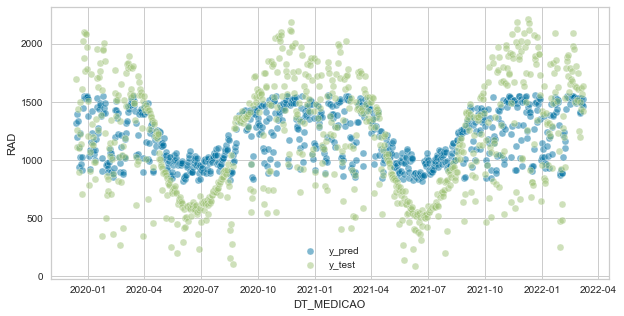

In [293]:
fig,ax = plt.subplots(figsize=(10,5))
sns.scatterplot(x=X_test.index, y = y_pred,alpha=0.5,label='y_pred',)
sns.scatterplot(x=X_test.index, y = y_test,alpha=0.5,label='y_test');

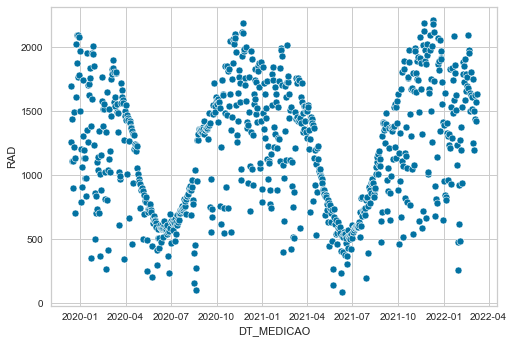

In [294]:
sns.scatterplot(x=X_test.index, y = y_test);

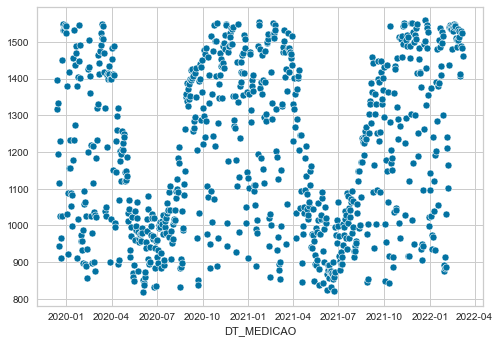

In [295]:
sns.scatterplot(x=X_test.index, y = y_pred);

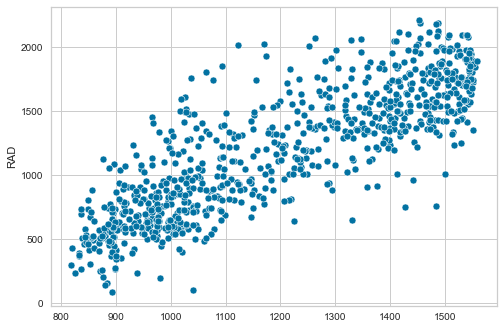

In [296]:
sns.scatterplot(x=y_pred, y = y_test);

In [297]:
from yellowbrick.regressor import ResidualsPlot

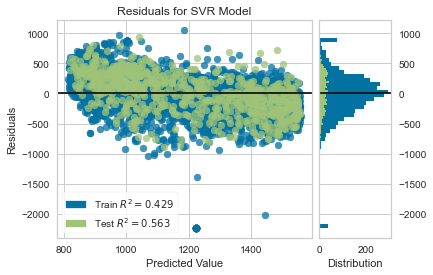

<AxesSubplot:title={'center':'Residuals for SVR Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [298]:
fig,ax = plt.subplots(figsize=(6,4))
rpv = ResidualsPlot(pipe)
rpv.fit(X_train,y_train)
rpv.score(X_test,y_test)
rpv.poof()

In [300]:
pipe.steps

[('preprocessor',
  ColumnTransformer(transformers=[('minmax', MinMaxScaler(),
                                   ['UMD_MIN', 'TEM_INS', 'ts_lag1'])])),
 ('svr', SVR(epsilon=0.01))]